# Afriat

In [1]:
scan=0.1325

In [2]:
import warnings
import os
import sys
import gc
import warnings

In [3]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
tardis.config = tardis.config_server

In [4]:
torch.cuda.is_available()

False

In [5]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [6]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [7]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [8]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [9]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.25,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-4,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

# tardis.MyModel.setup_wandb(
#     wandb_configurations=tardis.config.wandb,
#     hyperparams=dict(
#         model_params=model_params,
#         train_params=train_params,
#         dataset_params=dataset_params,
#     )
# )

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    f"afriat_v2_4_scan_{scan}"
)

vae.save(
    dir_path,
    overwrite=True,
)

/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/scvi/data/fields/_base_field.py:64: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: PossibleUserWarning: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
  rank_zero_warn(


GPU available: False, used: False


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: PossibleUserWarning: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
  rank_zero_warn(
/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


Training:   0%|          | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|          | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2561,3311,9371
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2561,2565,1696,3420,1672,3329
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4447,10796
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 644,798,2368
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 644,637,412,870,377,870
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1137,2673
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|          | 1/600 [00:13<2:19:28, 13.97s/it]

Epoch 1/600:   0%|          | 1/600 [00:13<2:19:28, 13.97s/it, v_num=1, total_loss_train=3.7e+3, kl_local_train=40.7]

Epoch 2/600:   0%|          | 1/600 [00:14<2:19:28, 13.97s/it, v_num=1, total_loss_train=3.7e+3, kl_local_train=40.7]

Epoch 2/600:   0%|          | 2/600 [00:26<2:12:32, 13.30s/it, v_num=1, total_loss_train=3.7e+3, kl_local_train=40.7]

Epoch 2/600:   0%|          | 2/600 [00:26<2:12:32, 13.30s/it, v_num=1, total_loss_train=3.23e+3, kl_local_train=53.4]

Epoch 3/600:   0%|          | 2/600 [00:26<2:12:32, 13.30s/it, v_num=1, total_loss_train=3.23e+3, kl_local_train=53.4]

Epoch 3/600:   0%|          | 3/600 [00:39<2:10:07, 13.08s/it, v_num=1, total_loss_train=3.23e+3, kl_local_train=53.4]

Epoch 3/600:   0%|          | 3/600 [00:39<2:10:07, 13.08s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=53]  

Epoch 4/600:   0%|          | 3/600 [00:39<2:10:07, 13.08s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=53]

Epoch 4/600:   1%|          | 4/600 [00:52<2:08:59, 12.98s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=53]

Epoch 4/600:   1%|          | 4/600 [00:52<2:08:59, 12.98s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=50.5]

Epoch 5/600:   1%|          | 4/600 [00:52<2:08:59, 12.98s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=50.5]

Epoch 5/600:   1%|          | 5/600 [01:05<2:08:16, 12.94s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=50.5]

Epoch 5/600:   1%|          | 5/600 [01:05<2:08:16, 12.94s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=46.3]

Epoch 6/600:   1%|          | 5/600 [01:06<2:08:16, 12.94s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=46.3]

Epoch 6/600:   1%|          | 6/600 [01:18<2:09:44, 13.11s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=46.3]

Epoch 6/600:   1%|          | 6/600 [01:18<2:09:44, 13.11s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00748, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 7/600:   1%|          | 6/600 [01:18<2:09:44, 13.11s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00748, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 7/600:   1%|          | 7/600 [01:31<2:07:05, 12.86s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00748, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 7/600:   1%|          | 7/600 [01:31<2:07:05, 12.86s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=32.4, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00748, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 8/600:   1%|          | 7/600 [01:31<2:07:05, 12.86s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=32.4, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00748, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 8/600:   1%|▏         | 8/600 [01:43<2:04:59, 12.67s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=32.4, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00748, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 8/600:   1%|▏         | 8/600 [01:43<2:04:59, 12.67s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=24.9, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00748, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 9/600:   1%|▏         | 8/600 [01:43<2:04:59, 12.67s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=24.9, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00748, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 9/600:   2%|▏         | 9/600 [01:55<2:03:24, 12.53s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=24.9, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00748, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 9/600:   2%|▏         | 9/600 [01:55<2:03:24, 12.53s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=24.6, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00748, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349] 

Epoch 10/600:   2%|▏         | 9/600 [01:55<2:03:24, 12.53s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=24.6, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00748, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 10/600:   2%|▏         | 10/600 [02:07<2:02:29, 12.46s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=24.6, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00748, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 10/600:   2%|▏         | 10/600 [02:07<2:02:29, 12.46s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=25.6, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00748, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 11/600:   2%|▏         | 10/600 [02:09<2:02:29, 12.46s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=25.6, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00748, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 11/600:   2%|▏         | 11/600 [02:21<2:05:31, 12.79s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=25.6, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00748, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 11/600:   2%|▏         | 11/600 [02:21<2:05:31, 12.79s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=28, metric_mi|status_control_train=0.0224, metric_mi|zone_train=0.0736, metric_mi|time_cat_train=0.0201, metric_mi|mouse_train=0.0438]   

Epoch 12/600:   2%|▏         | 11/600 [02:21<2:05:31, 12.79s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=28, metric_mi|status_control_train=0.0224, metric_mi|zone_train=0.0736, metric_mi|time_cat_train=0.0201, metric_mi|mouse_train=0.0438]

Epoch 12/600:   2%|▏         | 12/600 [02:33<2:03:39, 12.62s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=28, metric_mi|status_control_train=0.0224, metric_mi|zone_train=0.0736, metric_mi|time_cat_train=0.0201, metric_mi|mouse_train=0.0438]

Epoch 12/600:   2%|▏         | 12/600 [02:33<2:03:39, 12.62s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=34.3, metric_mi|status_control_train=0.0224, metric_mi|zone_train=0.0736, metric_mi|time_cat_train=0.0201, metric_mi|mouse_train=0.0438]

Epoch 13/600:   2%|▏         | 12/600 [02:33<2:03:39, 12.62s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=34.3, metric_mi|status_control_train=0.0224, metric_mi|zone_train=0.0736, metric_mi|time_cat_train=0.0201, metric_mi|mouse_train=0.0438]

Epoch 13/600:   2%|▏         | 13/600 [02:45<2:02:11, 12.49s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=34.3, metric_mi|status_control_train=0.0224, metric_mi|zone_train=0.0736, metric_mi|time_cat_train=0.0201, metric_mi|mouse_train=0.0438]

Epoch 13/600:   2%|▏         | 13/600 [02:45<2:02:11, 12.49s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0224, metric_mi|zone_train=0.0736, metric_mi|time_cat_train=0.0201, metric_mi|mouse_train=0.0438]

Epoch 14/600:   2%|▏         | 13/600 [02:45<2:02:11, 12.49s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0224, metric_mi|zone_train=0.0736, metric_mi|time_cat_train=0.0201, metric_mi|mouse_train=0.0438]

Epoch 14/600:   2%|▏         | 14/600 [02:57<2:00:03, 12.29s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0224, metric_mi|zone_train=0.0736, metric_mi|time_cat_train=0.0201, metric_mi|mouse_train=0.0438]

Epoch 14/600:   2%|▏         | 14/600 [02:57<2:00:03, 12.29s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0224, metric_mi|zone_train=0.0736, metric_mi|time_cat_train=0.0201, metric_mi|mouse_train=0.0438]

Epoch 15/600:   2%|▏         | 14/600 [02:57<2:00:03, 12.29s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0224, metric_mi|zone_train=0.0736, metric_mi|time_cat_train=0.0201, metric_mi|mouse_train=0.0438]

Epoch 15/600:   2%|▎         | 15/600 [03:09<1:58:46, 12.18s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0224, metric_mi|zone_train=0.0736, metric_mi|time_cat_train=0.0201, metric_mi|mouse_train=0.0438]

Epoch 15/600:   2%|▎         | 15/600 [03:09<1:58:46, 12.18s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=54.7, metric_mi|status_control_train=0.0224, metric_mi|zone_train=0.0736, metric_mi|time_cat_train=0.0201, metric_mi|mouse_train=0.0438]

Epoch 16/600:   2%|▎         | 15/600 [03:10<1:58:46, 12.18s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=54.7, metric_mi|status_control_train=0.0224, metric_mi|zone_train=0.0736, metric_mi|time_cat_train=0.0201, metric_mi|mouse_train=0.0438]

Epoch 16/600:   3%|▎         | 16/600 [03:22<2:01:01, 12.43s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=54.7, metric_mi|status_control_train=0.0224, metric_mi|zone_train=0.0736, metric_mi|time_cat_train=0.0201, metric_mi|mouse_train=0.0438]

Epoch 16/600:   3%|▎         | 16/600 [03:22<2:01:01, 12.43s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=58.6, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0723]

Epoch 17/600:   3%|▎         | 16/600 [03:22<2:01:01, 12.43s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=58.6, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0723]

Epoch 17/600:   3%|▎         | 17/600 [03:33<1:57:10, 12.06s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=58.6, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0723]

Epoch 17/600:   3%|▎         | 17/600 [03:33<1:57:10, 12.06s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=65.2, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0723]

Epoch 18/600:   3%|▎         | 17/600 [03:33<1:57:10, 12.06s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=65.2, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0723]

Epoch 18/600:   3%|▎         | 18/600 [03:44<1:54:18, 11.78s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=65.2, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0723]

Epoch 18/600:   3%|▎         | 18/600 [03:44<1:54:18, 11.78s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=73, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0723]  

Epoch 19/600:   3%|▎         | 18/600 [03:44<1:54:18, 11.78s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=73, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0723]

Epoch 19/600:   3%|▎         | 19/600 [03:56<1:52:09, 11.58s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=73, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0723]

Epoch 19/600:   3%|▎         | 19/600 [03:56<1:52:09, 11.58s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=81.1, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0723]

Epoch 20/600:   3%|▎         | 19/600 [03:56<1:52:09, 11.58s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=81.1, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0723]

Epoch 20/600:   3%|▎         | 20/600 [04:07<1:50:52, 11.47s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=81.1, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0723]

Epoch 20/600:   3%|▎         | 20/600 [04:07<1:50:52, 11.47s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=89.4, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0723]

Epoch 21/600:   3%|▎         | 20/600 [04:08<1:50:52, 11.47s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=89.4, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0723]

Epoch 21/600:   4%|▎         | 21/600 [04:19<1:53:30, 11.76s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=89.4, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0723]

Epoch 21/600:   4%|▎         | 21/600 [04:19<1:53:30, 11.76s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=96.7, metric_mi|status_control_train=0.0764, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0897, metric_mi|mouse_train=0.0996]

Epoch 22/600:   4%|▎         | 21/600 [04:19<1:53:30, 11.76s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=96.7, metric_mi|status_control_train=0.0764, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0897, metric_mi|mouse_train=0.0996]

Epoch 22/600:   4%|▎         | 22/600 [04:31<1:52:30, 11.68s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=96.7, metric_mi|status_control_train=0.0764, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0897, metric_mi|mouse_train=0.0996]

Epoch 22/600:   4%|▎         | 22/600 [04:31<1:52:30, 11.68s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=101, metric_mi|status_control_train=0.0764, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0897, metric_mi|mouse_train=0.0996] 

Epoch 23/600:   4%|▎         | 22/600 [04:31<1:52:30, 11.68s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=101, metric_mi|status_control_train=0.0764, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0897, metric_mi|mouse_train=0.0996]

Epoch 23/600:   4%|▍         | 23/600 [04:43<1:53:56, 11.85s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=101, metric_mi|status_control_train=0.0764, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0897, metric_mi|mouse_train=0.0996]

Epoch 23/600:   4%|▍         | 23/600 [04:43<1:53:56, 11.85s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=106, metric_mi|status_control_train=0.0764, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0897, metric_mi|mouse_train=0.0996]

Epoch 24/600:   4%|▍         | 23/600 [04:43<1:53:56, 11.85s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=106, metric_mi|status_control_train=0.0764, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0897, metric_mi|mouse_train=0.0996]

Epoch 24/600:   4%|▍         | 24/600 [04:55<1:54:58, 11.98s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=106, metric_mi|status_control_train=0.0764, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0897, metric_mi|mouse_train=0.0996]

Epoch 24/600:   4%|▍         | 24/600 [04:55<1:54:58, 11.98s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=107, metric_mi|status_control_train=0.0764, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0897, metric_mi|mouse_train=0.0996]

Epoch 25/600:   4%|▍         | 24/600 [04:55<1:54:58, 11.98s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=107, metric_mi|status_control_train=0.0764, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0897, metric_mi|mouse_train=0.0996]

Epoch 25/600:   4%|▍         | 25/600 [05:09<1:58:39, 12.38s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=107, metric_mi|status_control_train=0.0764, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0897, metric_mi|mouse_train=0.0996]

Epoch 25/600:   4%|▍         | 25/600 [05:09<1:58:39, 12.38s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=108, metric_mi|status_control_train=0.0764, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0897, metric_mi|mouse_train=0.0996]

Epoch 26/600:   4%|▍         | 25/600 [05:10<1:58:39, 12.38s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=108, metric_mi|status_control_train=0.0764, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0897, metric_mi|mouse_train=0.0996]

Epoch 26/600:   4%|▍         | 26/600 [05:22<2:01:53, 12.74s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=108, metric_mi|status_control_train=0.0764, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0897, metric_mi|mouse_train=0.0996]

Epoch 26/600:   4%|▍         | 26/600 [05:22<2:01:53, 12.74s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=108, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.081, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]     

Epoch 27/600:   4%|▍         | 26/600 [05:22<2:01:53, 12.74s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=108, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.081, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 27/600:   4%|▍         | 27/600 [05:34<2:00:25, 12.61s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=108, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.081, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 27/600:   4%|▍         | 27/600 [05:34<2:00:25, 12.61s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=110, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.081, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 28/600:   4%|▍         | 27/600 [05:34<2:00:25, 12.61s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=110, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.081, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 28/600:   5%|▍         | 28/600 [05:47<1:59:16, 12.51s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=110, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.081, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 28/600:   5%|▍         | 28/600 [05:47<1:59:16, 12.51s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=112, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.081, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 29/600:   5%|▍         | 28/600 [05:47<1:59:16, 12.51s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=112, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.081, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 29/600:   5%|▍         | 29/600 [05:59<1:58:19, 12.43s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=112, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.081, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 29/600:   5%|▍         | 29/600 [05:59<1:58:19, 12.43s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=112, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.081, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 30/600:   5%|▍         | 29/600 [05:59<1:58:19, 12.43s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=112, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.081, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 30/600:   5%|▌         | 30/600 [06:11<1:57:47, 12.40s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=112, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.081, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 30/600:   5%|▌         | 30/600 [06:11<1:57:47, 12.40s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=112, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.081, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 31/600:   5%|▌         | 30/600 [06:13<1:57:47, 12.40s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=112, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.081, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 31/600:   5%|▌         | 31/600 [06:25<2:00:56, 12.75s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=112, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.081, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 31/600:   5%|▌         | 31/600 [06:25<2:00:56, 12.75s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=111, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 32/600:   5%|▌         | 31/600 [06:25<2:00:56, 12.75s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=111, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 32/600:   5%|▌         | 32/600 [06:37<1:59:36, 12.63s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=111, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 32/600:   5%|▌         | 32/600 [06:37<1:59:36, 12.63s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=111, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 33/600:   5%|▌         | 32/600 [06:37<1:59:36, 12.63s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=111, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 33/600:   6%|▌         | 33/600 [06:50<1:58:30, 12.54s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=111, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 33/600:   6%|▌         | 33/600 [06:50<1:58:30, 12.54s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=109, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 34/600:   6%|▌         | 33/600 [06:50<1:58:30, 12.54s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=109, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 34/600:   6%|▌         | 34/600 [07:02<1:57:41, 12.48s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=109, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 34/600:   6%|▌         | 34/600 [07:02<1:57:41, 12.48s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=108, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 35/600:   6%|▌         | 34/600 [07:02<1:57:41, 12.48s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=108, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 35/600:   6%|▌         | 35/600 [07:14<1:57:02, 12.43s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=108, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 35/600:   6%|▌         | 35/600 [07:14<1:57:02, 12.43s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=107, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 36/600:   6%|▌         | 35/600 [07:15<1:57:02, 12.43s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=107, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 36/600:   6%|▌         | 36/600 [07:28<2:00:02, 12.77s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=107, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 36/600:   6%|▌         | 36/600 [07:28<2:00:02, 12.77s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=108, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.114]

Epoch 37/600:   6%|▌         | 36/600 [07:28<2:00:02, 12.77s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=108, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.114]

Epoch 37/600:   6%|▌         | 37/600 [07:40<1:58:36, 12.64s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=108, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.114]

Epoch 37/600:   6%|▌         | 37/600 [07:40<1:58:36, 12.64s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=107, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.114]

Epoch 38/600:   6%|▌         | 37/600 [07:40<1:58:36, 12.64s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=107, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.114]

Epoch 38/600:   6%|▋         | 38/600 [07:52<1:57:30, 12.55s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=107, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.114]

Epoch 38/600:   6%|▋         | 38/600 [07:52<1:57:30, 12.55s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=107, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.114] 

Epoch 39/600:   6%|▋         | 38/600 [07:52<1:57:30, 12.55s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=107, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.114]

Epoch 39/600:   6%|▋         | 39/600 [08:05<1:56:43, 12.48s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=107, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.114]

Epoch 39/600:   6%|▋         | 39/600 [08:05<1:56:43, 12.48s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=107, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.114]

Epoch 40/600:   6%|▋         | 39/600 [08:05<1:56:43, 12.48s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=107, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.114]

Epoch 40/600:   7%|▋         | 40/600 [08:17<1:56:04, 12.44s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=107, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.114]

Epoch 40/600:   7%|▋         | 40/600 [08:17<1:56:04, 12.44s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=105, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.114]

Epoch 41/600:   7%|▋         | 40/600 [08:18<1:56:04, 12.44s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=105, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.114]

Epoch 41/600:   7%|▋         | 41/600 [08:31<1:59:04, 12.78s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=105, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.114]

Epoch 41/600:   7%|▋         | 41/600 [08:31<1:59:04, 12.78s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=106, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116] 

Epoch 42/600:   7%|▋         | 41/600 [08:31<1:59:04, 12.78s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=106, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 42/600:   7%|▋         | 42/600 [08:43<1:57:37, 12.65s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=106, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 42/600:   7%|▋         | 42/600 [08:43<1:57:37, 12.65s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=106, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 43/600:   7%|▋         | 42/600 [08:43<1:57:37, 12.65s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=106, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 43/600:   7%|▋         | 43/600 [08:55<1:56:33, 12.56s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=106, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 43/600:   7%|▋         | 43/600 [08:55<1:56:33, 12.56s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=108, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 44/600:   7%|▋         | 43/600 [08:55<1:56:33, 12.56s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=108, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 44/600:   7%|▋         | 44/600 [09:08<1:55:51, 12.50s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=108, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 44/600:   7%|▋         | 44/600 [09:08<1:55:51, 12.50s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=108, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 45/600:   7%|▋         | 44/600 [09:08<1:55:51, 12.50s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=108, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 45/600:   8%|▊         | 45/600 [09:20<1:55:48, 12.52s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=108, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 45/600:   8%|▊         | 45/600 [09:20<1:55:48, 12.52s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=109, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 46/600:   8%|▊         | 45/600 [09:22<1:55:48, 12.52s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=109, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 46/600:   8%|▊         | 46/600 [09:34<1:59:03, 12.89s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=109, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 46/600:   8%|▊         | 46/600 [09:34<1:59:03, 12.89s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=109, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 47/600:   8%|▊         | 46/600 [09:34<1:59:03, 12.89s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=109, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 47/600:   8%|▊         | 47/600 [09:47<1:58:12, 12.83s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=109, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 47/600:   8%|▊         | 47/600 [09:47<1:58:12, 12.83s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=109, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 48/600:   8%|▊         | 47/600 [09:47<1:58:12, 12.83s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=109, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 48/600:   8%|▊         | 48/600 [09:59<1:56:46, 12.69s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=109, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 48/600:   8%|▊         | 48/600 [09:59<1:56:46, 12.69s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=109, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 49/600:   8%|▊         | 48/600 [09:59<1:56:46, 12.69s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=109, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 49/600:   8%|▊         | 49/600 [10:12<1:55:57, 12.63s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=109, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 49/600:   8%|▊         | 49/600 [10:12<1:55:57, 12.63s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=108, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 50/600:   8%|▊         | 49/600 [10:12<1:55:57, 12.63s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=108, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 50/600:   8%|▊         | 50/600 [10:24<1:55:15, 12.57s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=108, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 50/600:   8%|▊         | 50/600 [10:24<1:55:15, 12.57s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=109, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 51/600:   8%|▊         | 50/600 [10:25<1:55:15, 12.57s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=109, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 51/600:   8%|▊         | 51/600 [10:38<1:57:50, 12.88s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=109, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 51/600:   8%|▊         | 51/600 [10:38<1:57:50, 12.88s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=108, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 52/600:   8%|▊         | 51/600 [10:38<1:57:50, 12.88s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=108, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 52/600:   9%|▊         | 52/600 [10:50<1:56:12, 12.72s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=108, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 52/600:   9%|▊         | 52/600 [10:50<1:56:12, 12.72s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=108, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 53/600:   9%|▊         | 52/600 [10:50<1:56:12, 12.72s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=108, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 53/600:   9%|▉         | 53/600 [11:02<1:54:57, 12.61s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=108, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 53/600:   9%|▉         | 53/600 [11:02<1:54:57, 12.61s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=107, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 54/600:   9%|▉         | 53/600 [11:02<1:54:57, 12.61s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=107, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 54/600:   9%|▉         | 54/600 [11:15<1:54:00, 12.53s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=107, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 54/600:   9%|▉         | 54/600 [11:15<1:54:00, 12.53s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=106, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 55/600:   9%|▉         | 54/600 [11:15<1:54:00, 12.53s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=106, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 55/600:   9%|▉         | 55/600 [11:27<1:54:30, 12.61s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=106, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 55/600:   9%|▉         | 55/600 [11:27<1:54:30, 12.61s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=104, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 56/600:   9%|▉         | 55/600 [11:29<1:54:30, 12.61s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=104, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 56/600:   9%|▉         | 56/600 [11:41<1:56:58, 12.90s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=104, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 56/600:   9%|▉         | 56/600 [11:41<1:56:58, 12.90s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=104, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 57/600:   9%|▉         | 56/600 [11:41<1:56:58, 12.90s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=104, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 57/600:  10%|▉         | 57/600 [11:53<1:55:14, 12.73s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=104, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 57/600:  10%|▉         | 57/600 [11:53<1:55:14, 12.73s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=102, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 58/600:  10%|▉         | 57/600 [11:53<1:55:14, 12.73s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=102, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 58/600:  10%|▉         | 58/600 [12:06<1:53:56, 12.61s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=102, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 58/600:  10%|▉         | 58/600 [12:06<1:53:56, 12.61s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=102, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 59/600:  10%|▉         | 58/600 [12:06<1:53:56, 12.61s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=102, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 59/600:  10%|▉         | 59/600 [12:18<1:53:00, 12.53s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=102, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 59/600:  10%|▉         | 59/600 [12:18<1:53:00, 12.53s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=101, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 60/600:  10%|▉         | 59/600 [12:18<1:53:00, 12.53s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=101, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 60/600:  10%|█         | 60/600 [12:31<1:53:03, 12.56s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=101, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 60/600:  10%|█         | 60/600 [12:31<1:53:03, 12.56s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=99.1, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 61/600:  10%|█         | 60/600 [12:32<1:53:03, 12.56s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=99.1, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 61/600:  10%|█         | 61/600 [12:44<1:55:42, 12.88s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=99.1, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 61/600:  10%|█         | 61/600 [12:44<1:55:42, 12.88s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=98.5, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.119]

Epoch 62/600:  10%|█         | 61/600 [12:44<1:55:42, 12.88s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=98.5, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.119]

Epoch 62/600:  10%|█         | 62/600 [12:57<1:54:04, 12.72s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=98.5, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.119]

Epoch 62/600:  10%|█         | 62/600 [12:57<1:54:04, 12.72s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=97, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.119]  

Epoch 63/600:  10%|█         | 62/600 [12:57<1:54:04, 12.72s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=97, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.119]

Epoch 63/600:  10%|█         | 63/600 [13:09<1:52:52, 12.61s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=97, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.119]

Epoch 63/600:  10%|█         | 63/600 [13:09<1:52:52, 12.61s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=96.4, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.119]

Epoch 64/600:  10%|█         | 63/600 [13:09<1:52:52, 12.61s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=96.4, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.119]

Epoch 64/600:  11%|█         | 64/600 [13:21<1:51:59, 12.54s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=96.4, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.119]

Epoch 64/600:  11%|█         | 64/600 [13:21<1:51:59, 12.54s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=95, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.119]  

Epoch 65/600:  11%|█         | 64/600 [13:21<1:51:59, 12.54s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=95, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.119]

Epoch 65/600:  11%|█         | 65/600 [13:34<1:51:11, 12.47s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=95, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.119]

Epoch 65/600:  11%|█         | 65/600 [13:34<1:51:11, 12.47s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=94.4, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.119]

Epoch 66/600:  11%|█         | 65/600 [13:35<1:51:11, 12.47s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=94.4, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.119]

Epoch 66/600:  11%|█         | 66/600 [13:47<1:54:02, 12.81s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=94.4, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.119]

Epoch 66/600:  11%|█         | 66/600 [13:47<1:54:02, 12.81s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=93.3, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12] 

Epoch 67/600:  11%|█         | 66/600 [13:47<1:54:02, 12.81s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=93.3, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 67/600:  11%|█         | 67/600 [14:00<1:52:34, 12.67s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=93.3, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 67/600:  11%|█         | 67/600 [14:00<1:52:34, 12.67s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=91.8, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 68/600:  11%|█         | 67/600 [14:00<1:52:34, 12.67s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=91.8, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 68/600:  11%|█▏        | 68/600 [14:12<1:51:33, 12.58s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=91.8, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 68/600:  11%|█▏        | 68/600 [14:12<1:51:33, 12.58s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=91.5, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 69/600:  11%|█▏        | 68/600 [14:12<1:51:33, 12.58s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=91.5, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 69/600:  12%|█▏        | 69/600 [14:24<1:50:46, 12.52s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=91.5, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 69/600:  12%|█▏        | 69/600 [14:24<1:50:46, 12.52s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=90.7, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 70/600:  12%|█▏        | 69/600 [14:24<1:50:46, 12.52s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=90.7, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 70/600:  12%|█▏        | 70/600 [14:37<1:50:11, 12.47s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=90.7, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 70/600:  12%|█▏        | 70/600 [14:37<1:50:11, 12.47s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=90.1, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 71/600:  12%|█▏        | 70/600 [14:38<1:50:11, 12.47s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=90.1, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 71/600:  12%|█▏        | 71/600 [14:51<1:53:32, 12.88s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=90.1, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 71/600:  12%|█▏        | 71/600 [14:51<1:53:32, 12.88s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=89.7, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 72/600:  12%|█▏        | 71/600 [14:51<1:53:32, 12.88s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=89.7, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 72/600:  12%|█▏        | 72/600 [15:03<1:52:19, 12.76s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=89.7, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 72/600:  12%|█▏        | 72/600 [15:03<1:52:19, 12.76s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=88.6, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 73/600:  12%|█▏        | 72/600 [15:03<1:52:19, 12.76s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=88.6, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 73/600:  12%|█▏        | 73/600 [15:16<1:51:14, 12.66s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=88.6, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 73/600:  12%|█▏        | 73/600 [15:16<1:51:14, 12.66s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=88.7, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 74/600:  12%|█▏        | 73/600 [15:16<1:51:14, 12.66s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=88.7, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 74/600:  12%|█▏        | 74/600 [15:28<1:50:11, 12.57s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=88.7, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 74/600:  12%|█▏        | 74/600 [15:28<1:50:11, 12.57s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=87.5, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 75/600:  12%|█▏        | 74/600 [15:28<1:50:11, 12.57s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=87.5, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 75/600:  12%|█▎        | 75/600 [15:40<1:49:21, 12.50s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=87.5, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 75/600:  12%|█▎        | 75/600 [15:40<1:49:21, 12.50s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=86.1, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 76/600:  12%|█▎        | 75/600 [15:41<1:49:21, 12.50s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=86.1, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 76/600:  13%|█▎        | 76/600 [15:54<1:52:08, 12.84s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=86.1, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 76/600:  13%|█▎        | 76/600 [15:54<1:52:08, 12.84s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=85.1, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 77/600:  13%|█▎        | 76/600 [15:54<1:52:08, 12.84s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=85.1, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 77/600:  13%|█▎        | 77/600 [16:06<1:50:34, 12.69s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=85.1, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 77/600:  13%|█▎        | 77/600 [16:06<1:50:34, 12.69s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=85.1, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 78/600:  13%|█▎        | 77/600 [16:06<1:50:34, 12.69s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=85.1, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 78/600:  13%|█▎        | 78/600 [16:18<1:49:26, 12.58s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=85.1, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 78/600:  13%|█▎        | 78/600 [16:18<1:49:26, 12.58s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=85.1, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 79/600:  13%|█▎        | 78/600 [16:18<1:49:26, 12.58s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=85.1, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 79/600:  13%|█▎        | 79/600 [16:31<1:48:37, 12.51s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=85.1, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 79/600:  13%|█▎        | 79/600 [16:31<1:48:37, 12.51s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=84.6, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 80/600:  13%|█▎        | 79/600 [16:31<1:48:37, 12.51s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=84.6, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 80/600:  13%|█▎        | 80/600 [16:43<1:48:32, 12.52s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=84.6, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 80/600:  13%|█▎        | 80/600 [16:43<1:48:32, 12.52s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=83.2, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 81/600:  13%|█▎        | 80/600 [16:45<1:48:32, 12.52s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=83.2, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 81/600:  14%|█▎        | 81/600 [16:57<1:51:03, 12.84s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=83.2, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 81/600:  14%|█▎        | 81/600 [16:57<1:51:03, 12.84s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=82.6, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 82/600:  14%|█▎        | 81/600 [16:57<1:51:03, 12.84s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=82.6, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 82/600:  14%|█▎        | 82/600 [17:09<1:49:30, 12.68s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=82.6, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 82/600:  14%|█▎        | 82/600 [17:09<1:49:30, 12.68s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=82.4, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 83/600:  14%|█▎        | 82/600 [17:09<1:49:30, 12.68s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=82.4, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 83/600:  14%|█▍        | 83/600 [17:22<1:48:18, 12.57s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=82.4, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 83/600:  14%|█▍        | 83/600 [17:22<1:48:18, 12.57s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=81.7, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 84/600:  14%|█▍        | 83/600 [17:22<1:48:18, 12.57s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=81.7, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 84/600:  14%|█▍        | 84/600 [17:34<1:47:23, 12.49s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=81.7, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 84/600:  14%|█▍        | 84/600 [17:34<1:47:23, 12.49s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=80.6, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 85/600:  14%|█▍        | 84/600 [17:34<1:47:23, 12.49s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=80.6, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 85/600:  14%|█▍        | 85/600 [17:46<1:46:31, 12.41s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=80.6, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 85/600:  14%|█▍        | 85/600 [17:46<1:46:31, 12.41s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=80.4, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 86/600:  14%|█▍        | 85/600 [17:47<1:46:31, 12.41s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=80.4, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 86/600:  14%|█▍        | 86/600 [18:02<1:54:59, 13.42s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=80.4, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 86/600:  14%|█▍        | 86/600 [18:02<1:54:59, 13.42s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=80, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]  

Epoch 87/600:  14%|█▍        | 86/600 [18:02<1:54:59, 13.42s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=80, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 87/600:  14%|█▍        | 87/600 [18:16<1:57:37, 13.76s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=80, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 87/600:  14%|█▍        | 87/600 [18:16<1:57:37, 13.76s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=79.5, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 88/600:  14%|█▍        | 87/600 [18:16<1:57:37, 13.76s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=79.5, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 88/600:  15%|█▍        | 88/600 [18:31<1:59:23, 13.99s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=79.5, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 88/600:  15%|█▍        | 88/600 [18:31<1:59:23, 13.99s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=79.7, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 89/600:  15%|█▍        | 88/600 [18:31<1:59:23, 13.99s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=79.7, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 89/600:  15%|█▍        | 89/600 [18:46<2:00:32, 14.15s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=79.7, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 89/600:  15%|█▍        | 89/600 [18:46<2:00:32, 14.15s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=78.6, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 90/600:  15%|█▍        | 89/600 [18:46<2:00:32, 14.15s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=78.6, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 90/600:  15%|█▌        | 90/600 [19:00<2:01:29, 14.29s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=78.6, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 90/600:  15%|█▌        | 90/600 [19:00<2:01:29, 14.29s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=78.2, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 91/600:  15%|█▌        | 90/600 [19:01<2:01:29, 14.29s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=78.2, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 91/600:  15%|█▌        | 91/600 [19:16<2:05:06, 14.75s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=78.2, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 91/600:  15%|█▌        | 91/600 [19:16<2:05:06, 14.75s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=77.6, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12] 

Epoch 92/600:  15%|█▌        | 91/600 [19:16<2:05:06, 14.75s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=77.6, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 92/600:  15%|█▌        | 92/600 [19:30<2:04:22, 14.69s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=77.6, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 92/600:  15%|█▌        | 92/600 [19:30<2:04:22, 14.69s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=77.6, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 93/600:  15%|█▌        | 92/600 [19:30<2:04:22, 14.69s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=77.6, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 93/600:  16%|█▌        | 93/600 [19:45<2:03:52, 14.66s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=77.6, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 93/600:  16%|█▌        | 93/600 [19:45<2:03:52, 14.66s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=76.9, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 94/600:  16%|█▌        | 93/600 [19:45<2:03:52, 14.66s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=76.9, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 94/600:  16%|█▌        | 94/600 [20:00<2:03:57, 14.70s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=76.9, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 94/600:  16%|█▌        | 94/600 [20:00<2:03:57, 14.70s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=76.5, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 95/600:  16%|█▌        | 94/600 [20:00<2:03:57, 14.70s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=76.5, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 95/600:  16%|█▌        | 95/600 [20:14<2:03:10, 14.64s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=76.5, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 95/600:  16%|█▌        | 95/600 [20:14<2:03:10, 14.64s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=76.2, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 96/600:  16%|█▌        | 95/600 [20:16<2:03:10, 14.64s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=76.2, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 96/600:  16%|█▌        | 96/600 [20:28<2:00:19, 14.32s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=76.2, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 96/600:  16%|█▌        | 96/600 [20:28<2:00:19, 14.32s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=75.1, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 97/600:  16%|█▌        | 96/600 [20:28<2:00:19, 14.32s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=75.1, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 97/600:  16%|█▌        | 97/600 [20:40<1:54:56, 13.71s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=75.1, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 97/600:  16%|█▌        | 97/600 [20:40<1:54:56, 13.71s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=75.3, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 98/600:  16%|█▌        | 97/600 [20:40<1:54:56, 13.71s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=75.3, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 98/600:  16%|█▋        | 98/600 [20:52<1:51:03, 13.27s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=75.3, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 98/600:  16%|█▋        | 98/600 [20:52<1:51:03, 13.27s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=74.7, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 99/600:  16%|█▋        | 98/600 [20:52<1:51:03, 13.27s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=74.7, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 99/600:  16%|█▋        | 99/600 [21:05<1:48:11, 12.96s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=74.7, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 99/600:  16%|█▋        | 99/600 [21:05<1:48:11, 12.96s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=74.3, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 100/600:  16%|█▋        | 99/600 [21:05<1:48:11, 12.96s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=74.3, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 100/600:  17%|█▋        | 100/600 [21:17<1:46:02, 12.73s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=74.3, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 100/600:  17%|█▋        | 100/600 [21:17<1:46:02, 12.73s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=73.9, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 101/600:  17%|█▋        | 100/600 [21:18<1:46:02, 12.73s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=73.9, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 101/600:  17%|█▋        | 101/600 [21:30<1:47:36, 12.94s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=73.9, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 101/600:  17%|█▋        | 101/600 [21:30<1:47:36, 12.94s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=73.3, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]  

Epoch 102/600:  17%|█▋        | 101/600 [21:30<1:47:36, 12.94s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=73.3, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 102/600:  17%|█▋        | 102/600 [21:43<1:45:33, 12.72s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=73.3, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 102/600:  17%|█▋        | 102/600 [21:43<1:45:33, 12.72s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=73.5, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 103/600:  17%|█▋        | 102/600 [21:43<1:45:33, 12.72s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=73.5, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 103/600:  17%|█▋        | 103/600 [21:55<1:44:05, 12.57s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=73.5, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 103/600:  17%|█▋        | 103/600 [21:55<1:44:05, 12.57s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=73.3, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 104/600:  17%|█▋        | 103/600 [21:55<1:44:05, 12.57s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=73.3, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 104/600:  17%|█▋        | 104/600 [22:07<1:42:58, 12.46s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=73.3, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 104/600:  17%|█▋        | 104/600 [22:07<1:42:58, 12.46s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=72.9, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 105/600:  17%|█▋        | 104/600 [22:07<1:42:58, 12.46s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=72.9, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 105/600:  18%|█▊        | 105/600 [22:19<1:42:04, 12.37s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=72.9, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 105/600:  18%|█▊        | 105/600 [22:19<1:42:04, 12.37s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=72.7, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 106/600:  18%|█▊        | 105/600 [22:20<1:42:04, 12.37s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=72.7, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 106/600:  18%|█▊        | 106/600 [22:33<1:44:29, 12.69s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=72.7, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 106/600:  18%|█▊        | 106/600 [22:33<1:44:29, 12.69s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=71.8, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 107/600:  18%|█▊        | 106/600 [22:33<1:44:29, 12.69s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=71.8, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 107/600:  18%|█▊        | 107/600 [22:45<1:43:02, 12.54s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=71.8, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 107/600:  18%|█▊        | 107/600 [22:45<1:43:02, 12.54s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=71.5, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 108/600:  18%|█▊        | 107/600 [22:45<1:43:02, 12.54s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=71.5, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 108/600:  18%|█▊        | 108/600 [22:57<1:42:01, 12.44s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=71.5, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 108/600:  18%|█▊        | 108/600 [22:57<1:42:01, 12.44s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=70.8, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 109/600:  18%|█▊        | 108/600 [22:57<1:42:01, 12.44s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=70.8, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 109/600:  18%|█▊        | 109/600 [23:09<1:41:12, 12.37s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=70.8, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 109/600:  18%|█▊        | 109/600 [23:09<1:41:12, 12.37s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=70.8, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 110/600:  18%|█▊        | 109/600 [23:09<1:41:12, 12.37s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=70.8, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 110/600:  18%|█▊        | 110/600 [23:21<1:40:37, 12.32s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=70.8, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 110/600:  18%|█▊        | 110/600 [23:21<1:40:37, 12.32s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=69.9, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 111/600:  18%|█▊        | 110/600 [23:23<1:40:37, 12.32s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=69.9, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 111/600:  18%|█▊        | 111/600 [23:35<1:43:07, 12.65s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=69.9, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 111/600:  18%|█▊        | 111/600 [23:35<1:43:07, 12.65s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=69.7, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 112/600:  18%|█▊        | 111/600 [23:35<1:43:07, 12.65s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=69.7, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 112/600:  19%|█▊        | 112/600 [23:47<1:41:46, 12.51s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=69.7, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 112/600:  19%|█▊        | 112/600 [23:47<1:41:46, 12.51s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=69.5, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 113/600:  19%|█▊        | 112/600 [23:47<1:41:46, 12.51s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=69.5, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 113/600:  19%|█▉        | 113/600 [23:59<1:40:48, 12.42s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=69.5, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 113/600:  19%|█▉        | 113/600 [23:59<1:40:48, 12.42s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=69.6, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 114/600:  19%|█▉        | 113/600 [23:59<1:40:48, 12.42s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=69.6, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 114/600:  19%|█▉        | 114/600 [24:11<1:40:04, 12.35s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=69.6, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 114/600:  19%|█▉        | 114/600 [24:11<1:40:04, 12.35s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68.8, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 115/600:  19%|█▉        | 114/600 [24:11<1:40:04, 12.35s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68.8, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 115/600:  19%|█▉        | 115/600 [24:24<1:39:27, 12.30s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68.8, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 115/600:  19%|█▉        | 115/600 [24:24<1:39:27, 12.30s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68.8, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 116/600:  19%|█▉        | 115/600 [24:25<1:39:27, 12.30s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68.8, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 116/600:  19%|█▉        | 116/600 [24:37<1:42:01, 12.65s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68.8, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 116/600:  19%|█▉        | 116/600 [24:37<1:42:01, 12.65s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=67.7, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.111]

Epoch 117/600:  19%|█▉        | 116/600 [24:37<1:42:01, 12.65s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=67.7, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.111]

Epoch 117/600:  20%|█▉        | 117/600 [24:49<1:40:53, 12.53s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=67.7, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.111]

Epoch 117/600:  20%|█▉        | 117/600 [24:49<1:40:53, 12.53s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=67.7, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.111]

Epoch 118/600:  20%|█▉        | 117/600 [24:49<1:40:53, 12.53s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=67.7, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.111]

Epoch 118/600:  20%|█▉        | 118/600 [25:02<1:40:19, 12.49s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=67.7, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.111]

Epoch 118/600:  20%|█▉        | 118/600 [25:02<1:40:19, 12.49s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=67.9, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.111]

Epoch 119/600:  20%|█▉        | 118/600 [25:02<1:40:19, 12.49s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=67.9, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.111]

Epoch 119/600:  20%|█▉        | 119/600 [25:14<1:39:26, 12.41s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=67.9, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.111]

Epoch 119/600:  20%|█▉        | 119/600 [25:14<1:39:26, 12.41s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=67.2, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.111]

Epoch 120/600:  20%|█▉        | 119/600 [25:14<1:39:26, 12.41s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=67.2, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.111]

Epoch 120/600:  20%|██        | 120/600 [25:26<1:38:49, 12.35s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=67.2, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.111]

Epoch 120/600:  20%|██        | 120/600 [25:26<1:38:49, 12.35s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=67.3, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.111]

Epoch 121/600:  20%|██        | 120/600 [25:27<1:38:49, 12.35s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=67.3, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.111]

Epoch 121/600:  20%|██        | 121/600 [25:40<1:41:15, 12.68s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=67.3, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.111]

Epoch 121/600:  20%|██        | 121/600 [25:40<1:41:15, 12.68s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=67.1, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112] 

Epoch 122/600:  20%|██        | 121/600 [25:40<1:41:15, 12.68s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=67.1, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 122/600:  20%|██        | 122/600 [25:52<1:39:54, 12.54s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=67.1, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 122/600:  20%|██        | 122/600 [25:52<1:39:54, 12.54s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66.9, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 123/600:  20%|██        | 122/600 [25:52<1:39:54, 12.54s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66.9, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 123/600:  20%|██        | 123/600 [26:04<1:38:52, 12.44s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66.9, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 123/600:  20%|██        | 123/600 [26:04<1:38:52, 12.44s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66.6, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 124/600:  20%|██        | 123/600 [26:04<1:38:52, 12.44s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66.6, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 124/600:  21%|██        | 124/600 [26:16<1:38:05, 12.36s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66.6, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 124/600:  21%|██        | 124/600 [26:16<1:38:05, 12.36s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66.2, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 125/600:  21%|██        | 124/600 [26:16<1:38:05, 12.36s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66.2, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 125/600:  21%|██        | 125/600 [26:28<1:37:24, 12.30s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66.2, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 125/600:  21%|██        | 125/600 [26:28<1:37:24, 12.30s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.7, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 126/600:  21%|██        | 125/600 [26:30<1:37:24, 12.30s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.7, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 126/600:  21%|██        | 126/600 [26:42<1:40:01, 12.66s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.7, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 126/600:  21%|██        | 126/600 [26:42<1:40:01, 12.66s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.5, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]   

Epoch 127/600:  21%|██        | 126/600 [26:42<1:40:01, 12.66s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.5, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 127/600:  21%|██        | 127/600 [26:54<1:38:43, 12.52s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.5, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 127/600:  21%|██        | 127/600 [26:54<1:38:43, 12.52s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.4, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 128/600:  21%|██        | 127/600 [26:54<1:38:43, 12.52s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.4, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 128/600:  21%|██▏       | 128/600 [27:06<1:37:45, 12.43s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.4, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 128/600:  21%|██▏       | 128/600 [27:06<1:37:45, 12.43s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.1, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 129/600:  21%|██▏       | 128/600 [27:06<1:37:45, 12.43s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.1, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 129/600:  22%|██▏       | 129/600 [27:18<1:36:59, 12.36s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.1, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 129/600:  22%|██▏       | 129/600 [27:18<1:36:59, 12.36s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.2, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 130/600:  22%|██▏       | 129/600 [27:18<1:36:59, 12.36s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.2, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 130/600:  22%|██▏       | 130/600 [27:31<1:36:36, 12.33s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.2, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 130/600:  22%|██▏       | 130/600 [27:31<1:36:36, 12.33s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=64.9, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 131/600:  22%|██▏       | 130/600 [27:32<1:36:36, 12.33s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=64.9, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 131/600:  22%|██▏       | 131/600 [27:44<1:39:00, 12.67s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=64.9, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 131/600:  22%|██▏       | 131/600 [27:44<1:39:00, 12.67s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=64.6, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 132/600:  22%|██▏       | 131/600 [27:44<1:39:00, 12.67s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=64.6, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 132/600:  22%|██▏       | 132/600 [27:56<1:37:42, 12.53s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=64.6, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 132/600:  22%|██▏       | 132/600 [27:56<1:37:42, 12.53s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=64.7, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 133/600:  22%|██▏       | 132/600 [27:56<1:37:42, 12.53s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=64.7, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 133/600:  22%|██▏       | 133/600 [28:09<1:36:44, 12.43s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=64.7, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 133/600:  22%|██▏       | 133/600 [28:09<1:36:44, 12.43s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=64.1, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 134/600:  22%|██▏       | 133/600 [28:09<1:36:44, 12.43s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=64.1, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 134/600:  22%|██▏       | 134/600 [28:21<1:36:00, 12.36s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=64.1, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 134/600:  22%|██▏       | 134/600 [28:21<1:36:00, 12.36s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.9, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 135/600:  22%|██▏       | 134/600 [28:21<1:36:00, 12.36s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.9, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 135/600:  22%|██▎       | 135/600 [28:33<1:35:34, 12.33s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.9, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 135/600:  22%|██▎       | 135/600 [28:33<1:35:34, 12.33s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.5, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 136/600:  22%|██▎       | 135/600 [28:34<1:35:34, 12.33s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.5, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 136/600:  23%|██▎       | 136/600 [28:46<1:37:52, 12.66s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.5, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 136/600:  23%|██▎       | 136/600 [28:46<1:37:52, 12.66s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.6, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 137/600:  23%|██▎       | 136/600 [28:46<1:37:52, 12.66s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.6, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 137/600:  23%|██▎       | 137/600 [28:59<1:36:38, 12.52s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.6, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 137/600:  23%|██▎       | 137/600 [28:59<1:36:38, 12.52s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.1, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 138/600:  23%|██▎       | 137/600 [28:59<1:36:38, 12.52s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.1, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 138/600:  23%|██▎       | 138/600 [29:10<1:34:33, 12.28s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.1, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 138/600:  23%|██▎       | 138/600 [29:10<1:34:33, 12.28s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.1, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 139/600:  23%|██▎       | 138/600 [29:10<1:34:33, 12.28s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.1, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 139/600:  23%|██▎       | 139/600 [29:21<1:31:40, 11.93s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.1, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 139/600:  23%|██▎       | 139/600 [29:21<1:31:40, 11.93s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 140/600:  23%|██▎       | 139/600 [29:21<1:31:40, 11.93s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 140/600:  23%|██▎       | 140/600 [29:33<1:29:32, 11.68s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 140/600:  23%|██▎       | 140/600 [29:33<1:29:32, 11.68s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.2, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 141/600:  23%|██▎       | 140/600 [29:34<1:29:32, 11.68s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.2, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 141/600:  24%|██▎       | 141/600 [29:45<1:30:54, 11.88s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.2, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 141/600:  24%|██▎       | 141/600 [29:45<1:30:54, 11.88s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=61.8, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 142/600:  24%|██▎       | 141/600 [29:45<1:30:54, 11.88s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=61.8, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 142/600:  24%|██▎       | 142/600 [29:56<1:29:08, 11.68s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=61.8, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 142/600:  24%|██▎       | 142/600 [29:56<1:29:08, 11.68s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.1, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 143/600:  24%|██▎       | 142/600 [29:56<1:29:08, 11.68s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.1, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 143/600:  24%|██▍       | 143/600 [30:07<1:28:05, 11.57s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.1, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 143/600:  24%|██▍       | 143/600 [30:07<1:28:05, 11.57s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]  

Epoch 144/600:  24%|██▍       | 143/600 [30:07<1:28:05, 11.57s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 144/600:  24%|██▍       | 144/600 [30:19<1:26:52, 11.43s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 144/600:  24%|██▍       | 144/600 [30:19<1:26:52, 11.43s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=61.6, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 145/600:  24%|██▍       | 144/600 [30:19<1:26:52, 11.43s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=61.6, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 145/600:  24%|██▍       | 145/600 [30:30<1:26:04, 11.35s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=61.6, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 145/600:  24%|██▍       | 145/600 [30:30<1:26:04, 11.35s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=61.3, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 146/600:  24%|██▍       | 145/600 [30:31<1:26:04, 11.35s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=61.3, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 146/600:  24%|██▍       | 146/600 [30:43<1:29:49, 11.87s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=61.3, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 146/600:  24%|██▍       | 146/600 [30:43<1:29:49, 11.87s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=60.9, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.106]

Epoch 147/600:  24%|██▍       | 146/600 [30:43<1:29:49, 11.87s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=60.9, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.106]

Epoch 147/600:  24%|██▍       | 147/600 [30:55<1:30:24, 11.97s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=60.9, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.106]

Epoch 147/600:  24%|██▍       | 147/600 [30:55<1:30:24, 11.97s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.8, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.106]

Epoch 148/600:  24%|██▍       | 147/600 [30:55<1:30:24, 11.97s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.8, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.106]

Epoch 148/600:  25%|██▍       | 148/600 [31:07<1:30:43, 12.04s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.8, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.106]

Epoch 148/600:  25%|██▍       | 148/600 [31:07<1:30:43, 12.04s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.5, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.106]

Epoch 149/600:  25%|██▍       | 148/600 [31:07<1:30:43, 12.04s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.5, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.106]

Epoch 149/600:  25%|██▍       | 149/600 [31:19<1:30:54, 12.09s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.5, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.106]

Epoch 149/600:  25%|██▍       | 149/600 [31:19<1:30:54, 12.09s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.7, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.106]

Epoch 150/600:  25%|██▍       | 149/600 [31:19<1:30:54, 12.09s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.7, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.106]

Epoch 150/600:  25%|██▌       | 150/600 [31:32<1:30:57, 12.13s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.7, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.106]

Epoch 150/600:  25%|██▌       | 150/600 [31:32<1:30:57, 12.13s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.3, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.106]

Epoch 151/600:  25%|██▌       | 150/600 [31:33<1:30:57, 12.13s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.3, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.106]

Epoch 151/600:  25%|██▌       | 151/600 [31:45<1:33:44, 12.53s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.3, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.106]

Epoch 151/600:  25%|██▌       | 151/600 [31:45<1:33:44, 12.53s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.5, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 152/600:  25%|██▌       | 151/600 [31:45<1:33:44, 12.53s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.5, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 152/600:  25%|██▌       | 152/600 [31:57<1:32:49, 12.43s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.5, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 152/600:  25%|██▌       | 152/600 [31:57<1:32:49, 12.43s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.2, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 153/600:  25%|██▌       | 152/600 [31:57<1:32:49, 12.43s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.2, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 153/600:  26%|██▌       | 153/600 [32:09<1:32:06, 12.36s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.2, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 153/600:  26%|██▌       | 153/600 [32:09<1:32:06, 12.36s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.6, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 154/600:  26%|██▌       | 153/600 [32:10<1:32:06, 12.36s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.6, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 154/600:  26%|██▌       | 154/600 [32:22<1:31:33, 12.32s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.6, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 154/600:  26%|██▌       | 154/600 [32:22<1:31:33, 12.32s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.6, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 155/600:  26%|██▌       | 154/600 [32:22<1:31:33, 12.32s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.6, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 155/600:  26%|██▌       | 155/600 [32:34<1:30:56, 12.26s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.6, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 155/600:  26%|██▌       | 155/600 [32:34<1:30:56, 12.26s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.6, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 156/600:  26%|██▌       | 155/600 [32:35<1:30:56, 12.26s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.6, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 156/600:  26%|██▌       | 156/600 [32:47<1:33:20, 12.61s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.6, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 156/600:  26%|██▌       | 156/600 [32:47<1:33:20, 12.61s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.2, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0983, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 157/600:  26%|██▌       | 156/600 [32:47<1:33:20, 12.61s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.2, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0983, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 157/600:  26%|██▌       | 157/600 [32:59<1:32:15, 12.49s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.2, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0983, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 157/600:  26%|██▌       | 157/600 [32:59<1:32:15, 12.49s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.1, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0983, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 158/600:  26%|██▌       | 157/600 [32:59<1:32:15, 12.49s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.1, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0983, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 158/600:  26%|██▋       | 158/600 [33:12<1:31:24, 12.41s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.1, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0983, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 158/600:  26%|██▋       | 158/600 [33:12<1:31:24, 12.41s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=58.7, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0983, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 159/600:  26%|██▋       | 158/600 [33:12<1:31:24, 12.41s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=58.7, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0983, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 159/600:  26%|██▋       | 159/600 [33:24<1:30:45, 12.35s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=58.7, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0983, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 159/600:  26%|██▋       | 159/600 [33:24<1:30:45, 12.35s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=58.7, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0983, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 160/600:  26%|██▋       | 159/600 [33:24<1:30:45, 12.35s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=58.7, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0983, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 160/600:  27%|██▋       | 160/600 [33:36<1:30:07, 12.29s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=58.7, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0983, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 160/600:  27%|██▋       | 160/600 [33:36<1:30:07, 12.29s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=58.5, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0983, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 161/600:  27%|██▋       | 160/600 [33:37<1:30:07, 12.29s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=58.5, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0983, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 161/600:  27%|██▋       | 161/600 [33:49<1:32:26, 12.63s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=58.5, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0983, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 161/600:  27%|██▋       | 161/600 [33:49<1:32:26, 12.63s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=58.4, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0972, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 162/600:  27%|██▋       | 161/600 [33:50<1:32:26, 12.63s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=58.4, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0972, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 162/600:  27%|██▋       | 162/600 [34:02<1:31:17, 12.51s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=58.4, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0972, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 162/600:  27%|██▋       | 162/600 [34:02<1:31:17, 12.51s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.4, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0972, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104] 

Epoch 163/600:  27%|██▋       | 162/600 [34:02<1:31:17, 12.51s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.4, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0972, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 163/600:  27%|██▋       | 163/600 [34:14<1:30:28, 12.42s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.4, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0972, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 163/600:  27%|██▋       | 163/600 [34:14<1:30:28, 12.42s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.2, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0972, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 164/600:  27%|██▋       | 163/600 [34:14<1:30:28, 12.42s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.2, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0972, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 164/600:  27%|██▋       | 164/600 [34:26<1:29:48, 12.36s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.2, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0972, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 164/600:  27%|██▋       | 164/600 [34:26<1:29:48, 12.36s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.7, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0972, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 165/600:  27%|██▋       | 164/600 [34:26<1:29:48, 12.36s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.7, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0972, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 165/600:  28%|██▊       | 165/600 [34:38<1:29:19, 12.32s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.7, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0972, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 165/600:  28%|██▊       | 165/600 [34:38<1:29:19, 12.32s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.8, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0972, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 166/600:  28%|██▊       | 165/600 [34:40<1:29:19, 12.32s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.8, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0972, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 166/600:  28%|██▊       | 166/600 [34:52<1:31:34, 12.66s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.8, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0972, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 166/600:  28%|██▊       | 166/600 [34:52<1:31:34, 12.66s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0958, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 167/600:  28%|██▊       | 166/600 [34:52<1:31:34, 12.66s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0958, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 167/600:  28%|██▊       | 167/600 [35:04<1:30:51, 12.59s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0958, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 167/600:  28%|██▊       | 167/600 [35:04<1:30:51, 12.59s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.6, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0958, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 168/600:  28%|██▊       | 167/600 [35:04<1:30:51, 12.59s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.6, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0958, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 168/600:  28%|██▊       | 168/600 [35:16<1:29:50, 12.48s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.6, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0958, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 168/600:  28%|██▊       | 168/600 [35:16<1:29:50, 12.48s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.3, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0958, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 169/600:  28%|██▊       | 168/600 [35:16<1:29:50, 12.48s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.3, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0958, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 169/600:  28%|██▊       | 169/600 [35:29<1:29:05, 12.40s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.3, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0958, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 169/600:  28%|██▊       | 169/600 [35:29<1:29:05, 12.40s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.1, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0958, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 170/600:  28%|██▊       | 169/600 [35:29<1:29:05, 12.40s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.1, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0958, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 170/600:  28%|██▊       | 170/600 [35:41<1:28:24, 12.34s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.1, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0958, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 170/600:  28%|██▊       | 170/600 [35:41<1:28:24, 12.34s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.1, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0958, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 171/600:  28%|██▊       | 170/600 [35:42<1:28:24, 12.34s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.1, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0958, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 171/600:  28%|██▊       | 171/600 [35:54<1:30:35, 12.67s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.1, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0958, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 171/600:  28%|██▊       | 171/600 [35:54<1:30:35, 12.67s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=56.8, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.0955, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.103]

Epoch 172/600:  28%|██▊       | 171/600 [35:54<1:30:35, 12.67s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=56.8, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.0955, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.103]

Epoch 172/600:  29%|██▊       | 172/600 [36:07<1:29:26, 12.54s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=56.8, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.0955, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.103]

Epoch 172/600:  29%|██▊       | 172/600 [36:07<1:29:26, 12.54s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=56.7, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.0955, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.103]

Epoch 173/600:  29%|██▊       | 172/600 [36:07<1:29:26, 12.54s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=56.7, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.0955, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.103]

Epoch 173/600:  29%|██▉       | 173/600 [36:19<1:28:28, 12.43s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=56.7, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.0955, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.103]

Epoch 173/600:  29%|██▉       | 173/600 [36:19<1:28:28, 12.43s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=56.8, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.0955, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.103]

Epoch 174/600:  29%|██▉       | 173/600 [36:19<1:28:28, 12.43s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=56.8, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.0955, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.103]

Epoch 174/600:  29%|██▉       | 174/600 [36:31<1:27:45, 12.36s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=56.8, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.0955, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.103]

Epoch 174/600:  29%|██▉       | 174/600 [36:31<1:27:45, 12.36s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=56.3, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.0955, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.103]

Epoch 175/600:  29%|██▉       | 174/600 [36:31<1:27:45, 12.36s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=56.3, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.0955, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.103]

Epoch 175/600:  29%|██▉       | 175/600 [36:43<1:27:18, 12.33s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=56.3, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.0955, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.103]

Epoch 175/600:  29%|██▉       | 175/600 [36:43<1:27:18, 12.33s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=56.7, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.0955, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.103]

Epoch 176/600:  29%|██▉       | 175/600 [36:44<1:27:18, 12.33s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=56.7, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.0955, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.103]

Epoch 176/600:  29%|██▉       | 176/600 [36:57<1:29:24, 12.65s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=56.7, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.0955, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.103]

Epoch 176/600:  29%|██▉       | 176/600 [36:57<1:29:24, 12.65s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=56.1, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0935, metric_mi|time_cat_train=0.0948, metric_mi|mouse_train=0.1]   

Epoch 177/600:  29%|██▉       | 176/600 [36:57<1:29:24, 12.65s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=56.1, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0935, metric_mi|time_cat_train=0.0948, metric_mi|mouse_train=0.1]

Epoch 177/600:  30%|██▉       | 177/600 [37:09<1:28:13, 12.51s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=56.1, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0935, metric_mi|time_cat_train=0.0948, metric_mi|mouse_train=0.1]

Epoch 177/600:  30%|██▉       | 177/600 [37:09<1:28:13, 12.51s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=56, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0935, metric_mi|time_cat_train=0.0948, metric_mi|mouse_train=0.1]  

Epoch 178/600:  30%|██▉       | 177/600 [37:09<1:28:13, 12.51s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=56, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0935, metric_mi|time_cat_train=0.0948, metric_mi|mouse_train=0.1]

Epoch 178/600:  30%|██▉       | 178/600 [37:21<1:27:20, 12.42s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=56, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0935, metric_mi|time_cat_train=0.0948, metric_mi|mouse_train=0.1]

Epoch 178/600:  30%|██▉       | 178/600 [37:21<1:27:20, 12.42s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0935, metric_mi|time_cat_train=0.0948, metric_mi|mouse_train=0.1]

Epoch 179/600:  30%|██▉       | 178/600 [37:21<1:27:20, 12.42s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0935, metric_mi|time_cat_train=0.0948, metric_mi|mouse_train=0.1]

Epoch 179/600:  30%|██▉       | 179/600 [37:33<1:26:46, 12.37s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0935, metric_mi|time_cat_train=0.0948, metric_mi|mouse_train=0.1]

Epoch 179/600:  30%|██▉       | 179/600 [37:33<1:26:46, 12.37s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0935, metric_mi|time_cat_train=0.0948, metric_mi|mouse_train=0.1]

Epoch 180/600:  30%|██▉       | 179/600 [37:33<1:26:46, 12.37s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0935, metric_mi|time_cat_train=0.0948, metric_mi|mouse_train=0.1]

Epoch 180/600:  30%|███       | 180/600 [37:45<1:26:11, 12.31s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0935, metric_mi|time_cat_train=0.0948, metric_mi|mouse_train=0.1]

Epoch 180/600:  30%|███       | 180/600 [37:45<1:26:11, 12.31s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.6, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0935, metric_mi|time_cat_train=0.0948, metric_mi|mouse_train=0.1]

Epoch 181/600:  30%|███       | 180/600 [37:47<1:26:11, 12.31s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.6, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0935, metric_mi|time_cat_train=0.0948, metric_mi|mouse_train=0.1]

Epoch 181/600:  30%|███       | 181/600 [37:59<1:28:17, 12.64s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.6, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0935, metric_mi|time_cat_train=0.0948, metric_mi|mouse_train=0.1]

Epoch 181/600:  30%|███       | 181/600 [37:59<1:28:17, 12.64s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.4, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0909, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0974]

Epoch 182/600:  30%|███       | 181/600 [37:59<1:28:17, 12.64s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.4, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0909, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0974]

Epoch 182/600:  30%|███       | 182/600 [38:11<1:27:10, 12.51s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.4, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0909, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0974]

Epoch 182/600:  30%|███       | 182/600 [38:11<1:27:10, 12.51s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.6, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0909, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0974]

Epoch 183/600:  30%|███       | 182/600 [38:11<1:27:10, 12.51s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.6, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0909, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0974]

Epoch 183/600:  30%|███       | 183/600 [38:23<1:26:17, 12.41s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.6, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0909, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0974]

Epoch 183/600:  30%|███       | 183/600 [38:23<1:26:17, 12.41s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.4, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0909, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0974]

Epoch 184/600:  30%|███       | 183/600 [38:23<1:26:17, 12.41s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.4, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0909, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0974]

Epoch 184/600:  31%|███       | 184/600 [38:35<1:25:38, 12.35s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.4, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0909, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0974]

Epoch 184/600:  31%|███       | 184/600 [38:35<1:25:38, 12.35s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.1, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0909, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0974]

Epoch 185/600:  31%|███       | 184/600 [38:35<1:25:38, 12.35s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.1, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0909, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0974]

Epoch 185/600:  31%|███       | 185/600 [38:48<1:25:07, 12.31s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.1, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0909, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0974]

Epoch 185/600:  31%|███       | 185/600 [38:48<1:25:07, 12.31s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0909, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0974]  

Epoch 186/600:  31%|███       | 185/600 [38:49<1:25:07, 12.31s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0909, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0974]

Epoch 186/600:  31%|███       | 186/600 [39:01<1:27:15, 12.65s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0909, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0974]

Epoch 186/600:  31%|███       | 186/600 [39:01<1:27:15, 12.65s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.1, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.089, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0962]

Epoch 187/600:  31%|███       | 186/600 [39:01<1:27:15, 12.65s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.1, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.089, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0962]

Epoch 187/600:  31%|███       | 187/600 [39:13<1:26:09, 12.52s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.1, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.089, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0962]

Epoch 187/600:  31%|███       | 187/600 [39:13<1:26:09, 12.52s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.9, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.089, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0962]

Epoch 188/600:  31%|███       | 187/600 [39:13<1:26:09, 12.52s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.9, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.089, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0962]

Epoch 188/600:  31%|███▏      | 188/600 [39:26<1:25:24, 12.44s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.9, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.089, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0962]

Epoch 188/600:  31%|███▏      | 188/600 [39:26<1:25:24, 12.44s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.9, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.089, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0962]

Epoch 189/600:  31%|███▏      | 188/600 [39:26<1:25:24, 12.44s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.9, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.089, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0962]

Epoch 189/600:  32%|███▏      | 189/600 [39:38<1:24:42, 12.37s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.9, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.089, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0962]

Epoch 189/600:  32%|███▏      | 189/600 [39:38<1:24:42, 12.37s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.089, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0962]

Epoch 190/600:  32%|███▏      | 189/600 [39:38<1:24:42, 12.37s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.089, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0962]

Epoch 190/600:  32%|███▏      | 190/600 [39:50<1:24:06, 12.31s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.089, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0962]

Epoch 190/600:  32%|███▏      | 190/600 [39:50<1:24:06, 12.31s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.7, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.089, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0962]

Epoch 191/600:  32%|███▏      | 190/600 [39:51<1:24:06, 12.31s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.7, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.089, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0962]

Epoch 191/600:  32%|███▏      | 191/600 [40:04<1:26:33, 12.70s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.7, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.089, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0962]

Epoch 191/600:  32%|███▏      | 191/600 [40:04<1:26:33, 12.70s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.3, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.0892, metric_mi|mouse_train=0.0964]

Epoch 192/600:  32%|███▏      | 191/600 [40:04<1:26:33, 12.70s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.3, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.0892, metric_mi|mouse_train=0.0964]

Epoch 192/600:  32%|███▏      | 192/600 [40:16<1:25:24, 12.56s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.3, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.0892, metric_mi|mouse_train=0.0964]

Epoch 192/600:  32%|███▏      | 192/600 [40:16<1:25:24, 12.56s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.5, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.0892, metric_mi|mouse_train=0.0964]

Epoch 193/600:  32%|███▏      | 192/600 [40:16<1:25:24, 12.56s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.5, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.0892, metric_mi|mouse_train=0.0964]

Epoch 193/600:  32%|███▏      | 193/600 [40:28<1:24:29, 12.46s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.5, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.0892, metric_mi|mouse_train=0.0964]

Epoch 193/600:  32%|███▏      | 193/600 [40:28<1:24:29, 12.46s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.3, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.0892, metric_mi|mouse_train=0.0964]

Epoch 194/600:  32%|███▏      | 193/600 [40:28<1:24:29, 12.46s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.3, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.0892, metric_mi|mouse_train=0.0964]

Epoch 194/600:  32%|███▏      | 194/600 [40:40<1:23:49, 12.39s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.3, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.0892, metric_mi|mouse_train=0.0964]

Epoch 194/600:  32%|███▏      | 194/600 [40:40<1:23:49, 12.39s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.2, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.0892, metric_mi|mouse_train=0.0964]

Epoch 195/600:  32%|███▏      | 194/600 [40:40<1:23:49, 12.39s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.2, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.0892, metric_mi|mouse_train=0.0964]

Epoch 195/600:  32%|███▎      | 195/600 [40:52<1:23:12, 12.33s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.2, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.0892, metric_mi|mouse_train=0.0964]

Epoch 195/600:  32%|███▎      | 195/600 [40:52<1:23:12, 12.33s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.1, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.0892, metric_mi|mouse_train=0.0964]

Epoch 196/600:  32%|███▎      | 195/600 [40:54<1:23:12, 12.33s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.1, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.0892, metric_mi|mouse_train=0.0964]

Epoch 196/600:  33%|███▎      | 196/600 [41:06<1:25:17, 12.67s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.1, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.0892, metric_mi|mouse_train=0.0964]

Epoch 196/600:  33%|███▎      | 196/600 [41:06<1:25:17, 12.67s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0885, metric_mi|mouse_train=0.096]   

Epoch 197/600:  33%|███▎      | 196/600 [41:06<1:25:17, 12.67s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0885, metric_mi|mouse_train=0.096]

Epoch 197/600:  33%|███▎      | 197/600 [41:18<1:24:08, 12.53s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0885, metric_mi|mouse_train=0.096]

Epoch 197/600:  33%|███▎      | 197/600 [41:18<1:24:08, 12.53s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.8, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0885, metric_mi|mouse_train=0.096]

Epoch 198/600:  33%|███▎      | 197/600 [41:18<1:24:08, 12.53s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.8, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0885, metric_mi|mouse_train=0.096]

Epoch 198/600:  33%|███▎      | 198/600 [41:30<1:23:14, 12.43s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.8, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0885, metric_mi|mouse_train=0.096]

Epoch 198/600:  33%|███▎      | 198/600 [41:30<1:23:14, 12.43s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.9, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0885, metric_mi|mouse_train=0.096]

Epoch 199/600:  33%|███▎      | 198/600 [41:30<1:23:14, 12.43s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.9, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0885, metric_mi|mouse_train=0.096]

Epoch 199/600:  33%|███▎      | 199/600 [41:42<1:22:32, 12.35s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.9, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0885, metric_mi|mouse_train=0.096]

Epoch 199/600:  33%|███▎      | 199/600 [41:42<1:22:32, 12.35s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.7, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0885, metric_mi|mouse_train=0.096]

Epoch 200/600:  33%|███▎      | 199/600 [41:42<1:22:32, 12.35s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.7, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0885, metric_mi|mouse_train=0.096]

Epoch 200/600:  33%|███▎      | 200/600 [41:55<1:22:10, 12.33s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.7, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0885, metric_mi|mouse_train=0.096]

Epoch 200/600:  33%|███▎      | 200/600 [41:55<1:22:10, 12.33s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.8, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0885, metric_mi|mouse_train=0.096]

Epoch 201/600:  33%|███▎      | 200/600 [41:56<1:22:10, 12.33s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.8, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0885, metric_mi|mouse_train=0.096]

Epoch 201/600:  34%|███▎      | 201/600 [42:08<1:24:07, 12.65s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.8, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0885, metric_mi|mouse_train=0.096]

Epoch 201/600:  34%|███▎      | 201/600 [42:08<1:24:07, 12.65s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.6, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0882, metric_mi|mouse_train=0.0959]

Epoch 202/600:  34%|███▎      | 201/600 [42:08<1:24:07, 12.65s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.6, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0882, metric_mi|mouse_train=0.0959]

Epoch 202/600:  34%|███▎      | 202/600 [42:20<1:22:58, 12.51s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.6, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0882, metric_mi|mouse_train=0.0959]

Epoch 202/600:  34%|███▎      | 202/600 [42:20<1:22:58, 12.51s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0882, metric_mi|mouse_train=0.0959]  

Epoch 203/600:  34%|███▎      | 202/600 [42:20<1:22:58, 12.51s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0882, metric_mi|mouse_train=0.0959]

Epoch 203/600:  34%|███▍      | 203/600 [42:32<1:22:08, 12.41s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0882, metric_mi|mouse_train=0.0959]

Epoch 203/600:  34%|███▍      | 203/600 [42:32<1:22:08, 12.41s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.3, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0882, metric_mi|mouse_train=0.0959]

Epoch 204/600:  34%|███▍      | 203/600 [42:32<1:22:08, 12.41s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.3, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0882, metric_mi|mouse_train=0.0959]

Epoch 204/600:  34%|███▍      | 204/600 [42:45<1:21:34, 12.36s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.3, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0882, metric_mi|mouse_train=0.0959]

Epoch 204/600:  34%|███▍      | 204/600 [42:45<1:21:34, 12.36s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.2, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0882, metric_mi|mouse_train=0.0959]

Epoch 205/600:  34%|███▍      | 204/600 [42:45<1:21:34, 12.36s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.2, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0882, metric_mi|mouse_train=0.0959]

Epoch 205/600:  34%|███▍      | 205/600 [42:57<1:20:53, 12.29s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.2, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0882, metric_mi|mouse_train=0.0959]

Epoch 205/600:  34%|███▍      | 205/600 [42:57<1:20:53, 12.29s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.2, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0882, metric_mi|mouse_train=0.0959]

Epoch 206/600:  34%|███▍      | 205/600 [42:58<1:20:53, 12.29s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.2, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0882, metric_mi|mouse_train=0.0959]

Epoch 206/600:  34%|███▍      | 206/600 [43:10<1:22:53, 12.62s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.2, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0882, metric_mi|mouse_train=0.0959]

Epoch 206/600:  34%|███▍      | 206/600 [43:10<1:22:53, 12.62s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.2, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0944]

Epoch 207/600:  34%|███▍      | 206/600 [43:10<1:22:53, 12.62s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.2, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0944]

Epoch 207/600:  34%|███▍      | 207/600 [43:22<1:21:46, 12.49s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.2, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0944]

Epoch 207/600:  34%|███▍      | 207/600 [43:22<1:21:46, 12.49s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.1, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0944]

Epoch 208/600:  34%|███▍      | 207/600 [43:22<1:21:46, 12.49s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.1, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0944]

Epoch 208/600:  35%|███▍      | 208/600 [43:35<1:20:58, 12.39s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.1, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0944]

Epoch 208/600:  35%|███▍      | 208/600 [43:35<1:20:58, 12.39s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0944]

Epoch 209/600:  35%|███▍      | 208/600 [43:35<1:20:58, 12.39s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0944]

Epoch 209/600:  35%|███▍      | 209/600 [43:47<1:20:20, 12.33s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0944]

Epoch 209/600:  35%|███▍      | 209/600 [43:47<1:20:20, 12.33s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0944]

Epoch 210/600:  35%|███▍      | 209/600 [43:47<1:20:20, 12.33s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0944]

Epoch 210/600:  35%|███▌      | 210/600 [43:59<1:19:41, 12.26s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0944]

Epoch 210/600:  35%|███▌      | 210/600 [43:59<1:19:41, 12.26s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.8, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0944]

Epoch 211/600:  35%|███▌      | 210/600 [44:00<1:19:41, 12.26s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.8, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0944]

Epoch 211/600:  35%|███▌      | 211/600 [44:12<1:21:39, 12.59s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.8, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0944]

Epoch 211/600:  35%|███▌      | 211/600 [44:12<1:21:39, 12.59s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.7, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0932]  

Epoch 212/600:  35%|███▌      | 211/600 [44:12<1:21:39, 12.59s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.7, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0932]

Epoch 212/600:  35%|███▌      | 212/600 [44:24<1:20:39, 12.47s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.7, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0932]

Epoch 212/600:  35%|███▌      | 212/600 [44:24<1:20:39, 12.47s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.5, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0932]

Epoch 213/600:  35%|███▌      | 212/600 [44:24<1:20:39, 12.47s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.5, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0932]

Epoch 213/600:  36%|███▌      | 213/600 [44:37<1:19:53, 12.39s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.5, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0932]

Epoch 213/600:  36%|███▌      | 213/600 [44:37<1:19:53, 12.39s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.4, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0932]

Epoch 214/600:  36%|███▌      | 213/600 [44:37<1:19:53, 12.39s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.4, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0932]

Epoch 214/600:  36%|███▌      | 214/600 [44:49<1:19:12, 12.31s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.4, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0932]

Epoch 214/600:  36%|███▌      | 214/600 [44:49<1:19:12, 12.31s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.2, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0932]

Epoch 215/600:  36%|███▌      | 214/600 [44:49<1:19:12, 12.31s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.2, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0932]

Epoch 215/600:  36%|███▌      | 215/600 [45:01<1:18:32, 12.24s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.2, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0932]

Epoch 215/600:  36%|███▌      | 215/600 [45:01<1:18:32, 12.24s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.3, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0932]

Epoch 216/600:  36%|███▌      | 215/600 [45:02<1:18:32, 12.24s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.3, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0932]

Epoch 216/600:  36%|███▌      | 216/600 [45:14<1:20:55, 12.64s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.3, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0932]

Epoch 216/600:  36%|███▌      | 216/600 [45:14<1:20:55, 12.64s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.3, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0797, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0931]

Epoch 217/600:  36%|███▌      | 216/600 [45:14<1:20:55, 12.64s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.3, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0797, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0931]

Epoch 217/600:  36%|███▌      | 217/600 [45:27<1:19:46, 12.50s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.3, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0797, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0931]

Epoch 217/600:  36%|███▌      | 217/600 [45:27<1:19:46, 12.50s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.1, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0797, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0931]

Epoch 218/600:  36%|███▌      | 217/600 [45:27<1:19:46, 12.50s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.1, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0797, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0931]

Epoch 218/600:  36%|███▋      | 218/600 [45:39<1:18:58, 12.40s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.1, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0797, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0931]

Epoch 218/600:  36%|███▋      | 218/600 [45:39<1:18:58, 12.40s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.1, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0797, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0931]

Epoch 219/600:  36%|███▋      | 218/600 [45:39<1:18:58, 12.40s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.1, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0797, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0931]

Epoch 219/600:  36%|███▋      | 219/600 [45:51<1:18:19, 12.33s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.1, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0797, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0931]

Epoch 219/600:  36%|███▋      | 219/600 [45:51<1:18:19, 12.33s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0797, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0931]  

Epoch 220/600:  36%|███▋      | 219/600 [45:51<1:18:19, 12.33s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0797, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0931]

Epoch 220/600:  37%|███▋      | 220/600 [46:03<1:17:47, 12.28s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0797, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0931]

Epoch 220/600:  37%|███▋      | 220/600 [46:03<1:17:47, 12.28s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.9, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0797, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0931]

Epoch 221/600:  37%|███▋      | 220/600 [46:04<1:17:47, 12.28s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.9, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0797, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0931]

Epoch 221/600:  37%|███▋      | 221/600 [46:16<1:19:39, 12.61s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.9, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0797, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0931]

Epoch 221/600:  37%|███▋      | 221/600 [46:16<1:19:39, 12.61s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.8, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0937]

Epoch 222/600:  37%|███▋      | 221/600 [46:16<1:19:39, 12.61s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.8, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0937]

Epoch 222/600:  37%|███▋      | 222/600 [46:29<1:18:36, 12.48s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.8, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0937]

Epoch 222/600:  37%|███▋      | 222/600 [46:29<1:18:36, 12.48s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.9, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0937]

Epoch 223/600:  37%|███▋      | 222/600 [46:29<1:18:36, 12.48s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.9, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0937]

Epoch 223/600:  37%|███▋      | 223/600 [46:41<1:17:48, 12.38s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.9, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0937]

Epoch 223/600:  37%|███▋      | 223/600 [46:41<1:17:48, 12.38s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.7, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0937]

Epoch 224/600:  37%|███▋      | 223/600 [46:41<1:17:48, 12.38s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.7, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0937]

Epoch 224/600:  37%|███▋      | 224/600 [46:53<1:17:11, 12.32s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.7, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0937]

Epoch 224/600:  37%|███▋      | 224/600 [46:53<1:17:11, 12.32s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.6, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0937]

Epoch 225/600:  37%|███▋      | 224/600 [46:53<1:17:11, 12.32s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.6, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0937]

Epoch 225/600:  38%|███▊      | 225/600 [47:05<1:16:36, 12.26s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.6, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0937]

Epoch 225/600:  38%|███▊      | 225/600 [47:05<1:16:36, 12.26s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.5, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0937]

Epoch 226/600:  38%|███▊      | 225/600 [47:06<1:16:36, 12.26s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.5, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0937]

Epoch 226/600:  38%|███▊      | 226/600 [47:18<1:18:29, 12.59s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.5, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0937]

Epoch 226/600:  38%|███▊      | 226/600 [47:18<1:18:29, 12.59s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.8, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0935]

Epoch 227/600:  38%|███▊      | 226/600 [47:18<1:18:29, 12.59s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.8, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0935]

Epoch 227/600:  38%|███▊      | 227/600 [47:31<1:17:30, 12.47s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.8, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0935]

Epoch 227/600:  38%|███▊      | 227/600 [47:31<1:17:30, 12.47s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.3, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0935]

Epoch 228/600:  38%|███▊      | 227/600 [47:31<1:17:30, 12.47s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.3, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0935]

Epoch 228/600:  38%|███▊      | 228/600 [47:43<1:16:45, 12.38s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.3, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0935]

Epoch 228/600:  38%|███▊      | 228/600 [47:43<1:16:45, 12.38s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0935]

Epoch 229/600:  38%|███▊      | 228/600 [47:43<1:16:45, 12.38s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0935]

Epoch 229/600:  38%|███▊      | 229/600 [47:55<1:16:16, 12.34s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0935]

Epoch 229/600:  38%|███▊      | 229/600 [47:55<1:16:16, 12.34s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0935]

Epoch 230/600:  38%|███▊      | 229/600 [47:55<1:16:16, 12.34s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0935]

Epoch 230/600:  38%|███▊      | 230/600 [48:07<1:15:39, 12.27s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0935]

Epoch 230/600:  38%|███▊      | 230/600 [48:07<1:15:39, 12.27s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0935]

Epoch 231/600:  38%|███▊      | 230/600 [48:08<1:15:39, 12.27s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0935]

Epoch 231/600:  38%|███▊      | 231/600 [48:20<1:17:26, 12.59s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0935]

Epoch 231/600:  38%|███▊      | 231/600 [48:20<1:17:26, 12.59s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.1, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0766, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0924]

Epoch 232/600:  38%|███▊      | 231/600 [48:20<1:17:26, 12.59s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.1, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0766, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0924]

Epoch 232/600:  39%|███▊      | 232/600 [48:33<1:16:21, 12.45s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.1, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0766, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0924]

Epoch 232/600:  39%|███▊      | 232/600 [48:33<1:16:21, 12.45s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.3, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0766, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0924]

Epoch 233/600:  39%|███▊      | 232/600 [48:33<1:16:21, 12.45s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.3, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0766, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0924]

Epoch 233/600:  39%|███▉      | 233/600 [48:45<1:15:35, 12.36s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.3, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0766, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0924]

Epoch 233/600:  39%|███▉      | 233/600 [48:45<1:15:35, 12.36s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.1, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0766, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0924]

Epoch 234/600:  39%|███▉      | 233/600 [48:45<1:15:35, 12.36s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.1, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0766, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0924]

Epoch 234/600:  39%|███▉      | 234/600 [48:57<1:14:56, 12.28s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.1, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0766, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0924]

Epoch 234/600:  39%|███▉      | 234/600 [48:57<1:14:56, 12.28s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.1, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0766, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0924]

Epoch 235/600:  39%|███▉      | 234/600 [48:57<1:14:56, 12.28s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.1, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0766, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0924]

Epoch 235/600:  39%|███▉      | 235/600 [49:09<1:14:20, 12.22s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.1, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0766, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0924]

Epoch 235/600:  39%|███▉      | 235/600 [49:09<1:14:20, 12.22s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0766, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0924]  

Epoch 236/600:  39%|███▉      | 235/600 [49:10<1:14:20, 12.22s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0766, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0924]

Epoch 236/600:  39%|███▉      | 236/600 [49:22<1:16:12, 12.56s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0766, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0924]

Epoch 236/600:  39%|███▉      | 236/600 [49:22<1:16:12, 12.56s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0745, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0912]

Epoch 237/600:  39%|███▉      | 236/600 [49:22<1:16:12, 12.56s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0745, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0912]

Epoch 237/600:  40%|███▉      | 237/600 [49:34<1:15:14, 12.44s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0745, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0912]

Epoch 237/600:  40%|███▉      | 237/600 [49:34<1:15:14, 12.44s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.7, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0745, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0912]

Epoch 238/600:  40%|███▉      | 237/600 [49:34<1:15:14, 12.44s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.7, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0745, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0912]

Epoch 238/600:  40%|███▉      | 238/600 [49:47<1:14:36, 12.37s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.7, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0745, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0912]

Epoch 238/600:  40%|███▉      | 238/600 [49:47<1:14:36, 12.37s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.8, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0745, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0912]

Epoch 239/600:  40%|███▉      | 238/600 [49:47<1:14:36, 12.37s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.8, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0745, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0912]

Epoch 239/600:  40%|███▉      | 239/600 [49:59<1:14:00, 12.30s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.8, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0745, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0912]

Epoch 239/600:  40%|███▉      | 239/600 [49:59<1:14:00, 12.30s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.7, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0745, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0912]

Epoch 240/600:  40%|███▉      | 239/600 [49:59<1:14:00, 12.30s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.7, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0745, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0912]

Epoch 240/600:  40%|████      | 240/600 [50:11<1:13:27, 12.24s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.7, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0745, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0912]

Epoch 240/600:  40%|████      | 240/600 [50:11<1:13:27, 12.24s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.6, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0745, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0912]

Epoch 241/600:  40%|████      | 240/600 [50:12<1:13:27, 12.24s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.6, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0745, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0912]

Epoch 241/600:  40%|████      | 241/600 [50:24<1:15:34, 12.63s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.6, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0745, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0912]

Epoch 241/600:  40%|████      | 241/600 [50:24<1:15:34, 12.63s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.7, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0737, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0901]

Epoch 242/600:  40%|████      | 241/600 [50:24<1:15:34, 12.63s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.7, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0737, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0901]

Epoch 242/600:  40%|████      | 242/600 [50:37<1:14:27, 12.48s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.7, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0737, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0901]

Epoch 242/600:  40%|████      | 242/600 [50:37<1:14:27, 12.48s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.4, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0737, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0901]

Epoch 243/600:  40%|████      | 242/600 [50:37<1:14:27, 12.48s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.4, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0737, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0901]

Epoch 243/600:  40%|████      | 243/600 [50:49<1:13:41, 12.38s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.4, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0737, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0901]

Epoch 243/600:  40%|████      | 243/600 [50:49<1:13:41, 12.38s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.4, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0737, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0901]

Epoch 244/600:  40%|████      | 243/600 [50:49<1:13:41, 12.38s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.4, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0737, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0901]

Epoch 244/600:  41%|████      | 244/600 [51:01<1:13:04, 12.31s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.4, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0737, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0901]

Epoch 244/600:  41%|████      | 244/600 [51:01<1:13:04, 12.31s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.3, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0737, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0901]

Epoch 245/600:  41%|████      | 244/600 [51:01<1:13:04, 12.31s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.3, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0737, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0901]

Epoch 245/600:  41%|████      | 245/600 [51:13<1:12:27, 12.25s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.3, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0737, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0901]

Epoch 245/600:  41%|████      | 245/600 [51:13<1:12:27, 12.25s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.5, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0737, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0901]

Epoch 246/600:  41%|████      | 245/600 [51:14<1:12:27, 12.25s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.5, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0737, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0901]

Epoch 246/600:  41%|████      | 246/600 [51:26<1:14:14, 12.58s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.5, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0737, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0901]

Epoch 246/600:  41%|████      | 246/600 [51:26<1:14:14, 12.58s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.4, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.089] 

Epoch 247/600:  41%|████      | 246/600 [51:26<1:14:14, 12.58s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.4, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.089]

Epoch 247/600:  41%|████      | 247/600 [51:38<1:13:12, 12.44s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.4, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.089]

Epoch 247/600:  41%|████      | 247/600 [51:38<1:13:12, 12.44s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.3, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.089]

Epoch 248/600:  41%|████      | 247/600 [51:38<1:13:12, 12.44s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.3, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.089]

Epoch 248/600:  41%|████▏     | 248/600 [51:51<1:12:27, 12.35s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.3, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.089]

Epoch 248/600:  41%|████▏     | 248/600 [51:51<1:12:27, 12.35s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.3, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.089]

Epoch 249/600:  41%|████▏     | 248/600 [51:51<1:12:27, 12.35s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.3, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.089]

Epoch 249/600:  42%|████▏     | 249/600 [52:03<1:11:52, 12.29s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.3, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.089]

Epoch 249/600:  42%|████▏     | 249/600 [52:03<1:11:52, 12.29s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.4, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.089]

Epoch 250/600:  42%|████▏     | 249/600 [52:03<1:11:52, 12.29s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.4, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.089]

Epoch 250/600:  42%|████▏     | 250/600 [52:15<1:11:18, 12.22s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.4, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.089]

Epoch 250/600:  42%|████▏     | 250/600 [52:15<1:11:18, 12.22s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.2, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.089]

Epoch 251/600:  42%|████▏     | 250/600 [52:16<1:11:18, 12.22s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.2, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.089]

Epoch 251/600:  42%|████▏     | 251/600 [52:28<1:13:11, 12.58s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.2, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.089]

Epoch 251/600:  42%|████▏     | 251/600 [52:28<1:13:11, 12.58s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.2, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0755, metric_mi|mouse_train=0.088]

Epoch 252/600:  42%|████▏     | 251/600 [52:28<1:13:11, 12.58s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.2, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0755, metric_mi|mouse_train=0.088]

Epoch 252/600:  42%|████▏     | 252/600 [52:40<1:12:12, 12.45s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.2, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0755, metric_mi|mouse_train=0.088]

Epoch 252/600:  42%|████▏     | 252/600 [52:40<1:12:12, 12.45s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.1, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0755, metric_mi|mouse_train=0.088]

Epoch 253/600:  42%|████▏     | 252/600 [52:40<1:12:12, 12.45s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.1, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0755, metric_mi|mouse_train=0.088]

Epoch 253/600:  42%|████▏     | 253/600 [52:52<1:11:28, 12.36s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.1, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0755, metric_mi|mouse_train=0.088]

Epoch 253/600:  42%|████▏     | 253/600 [52:52<1:11:28, 12.36s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.2, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0755, metric_mi|mouse_train=0.088]

Epoch 254/600:  42%|████▏     | 253/600 [52:52<1:11:28, 12.36s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.2, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0755, metric_mi|mouse_train=0.088]

Epoch 254/600:  42%|████▏     | 254/600 [53:05<1:10:54, 12.30s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.2, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0755, metric_mi|mouse_train=0.088]

Epoch 254/600:  42%|████▏     | 254/600 [53:05<1:10:54, 12.30s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.1, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0755, metric_mi|mouse_train=0.088]

Epoch 255/600:  42%|████▏     | 254/600 [53:05<1:10:54, 12.30s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.1, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0755, metric_mi|mouse_train=0.088]

Epoch 255/600:  42%|████▎     | 255/600 [53:17<1:10:29, 12.26s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.1, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0755, metric_mi|mouse_train=0.088]

Epoch 255/600:  42%|████▎     | 255/600 [53:17<1:10:29, 12.26s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.2, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0755, metric_mi|mouse_train=0.088]

Epoch 256/600:  42%|████▎     | 255/600 [53:18<1:10:29, 12.26s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.2, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0755, metric_mi|mouse_train=0.088]

Epoch 256/600:  43%|████▎     | 256/600 [53:30<1:12:17, 12.61s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.2, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0755, metric_mi|mouse_train=0.088]

Epoch 256/600:  43%|████▎     | 256/600 [53:30<1:12:17, 12.61s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0869] 

Epoch 257/600:  43%|████▎     | 256/600 [53:30<1:12:17, 12.61s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0869]

Epoch 257/600:  43%|████▎     | 257/600 [53:42<1:11:22, 12.49s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0869]

Epoch 257/600:  43%|████▎     | 257/600 [53:42<1:11:22, 12.49s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.9, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0869]

Epoch 258/600:  43%|████▎     | 257/600 [53:42<1:11:22, 12.49s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.9, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0869]

Epoch 258/600:  43%|████▎     | 258/600 [53:55<1:10:39, 12.40s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.9, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0869]

Epoch 258/600:  43%|████▎     | 258/600 [53:55<1:10:39, 12.40s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.9, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0869]

Epoch 259/600:  43%|████▎     | 258/600 [53:55<1:10:39, 12.40s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.9, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0869]

Epoch 259/600:  43%|████▎     | 259/600 [54:07<1:10:07, 12.34s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.9, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0869]

Epoch 259/600:  43%|████▎     | 259/600 [54:07<1:10:07, 12.34s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0869]

Epoch 260/600:  43%|████▎     | 259/600 [54:07<1:10:07, 12.34s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0869]

Epoch 260/600:  43%|████▎     | 260/600 [54:19<1:09:33, 12.27s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0869]

Epoch 260/600:  43%|████▎     | 260/600 [54:19<1:09:33, 12.27s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.8, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0869]

Epoch 261/600:  43%|████▎     | 260/600 [54:20<1:09:33, 12.27s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.8, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0869]

Epoch 261/600:  44%|████▎     | 261/600 [54:32<1:11:16, 12.62s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.8, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0869]

Epoch 261/600:  44%|████▎     | 261/600 [54:32<1:11:16, 12.62s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0985, metric_mi|zone_train=0.068, metric_mi|time_cat_train=0.0734, metric_mi|mouse_train=0.0866]

Epoch 262/600:  44%|████▎     | 261/600 [54:32<1:11:16, 12.62s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0985, metric_mi|zone_train=0.068, metric_mi|time_cat_train=0.0734, metric_mi|mouse_train=0.0866]

Epoch 262/600:  44%|████▎     | 262/600 [54:45<1:10:20, 12.49s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0985, metric_mi|zone_train=0.068, metric_mi|time_cat_train=0.0734, metric_mi|mouse_train=0.0866]

Epoch 262/600:  44%|████▎     | 262/600 [54:45<1:10:20, 12.49s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0985, metric_mi|zone_train=0.068, metric_mi|time_cat_train=0.0734, metric_mi|mouse_train=0.0866]

Epoch 263/600:  44%|████▎     | 262/600 [54:45<1:10:20, 12.49s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0985, metric_mi|zone_train=0.068, metric_mi|time_cat_train=0.0734, metric_mi|mouse_train=0.0866]

Epoch 263/600:  44%|████▍     | 263/600 [54:57<1:09:43, 12.41s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0985, metric_mi|zone_train=0.068, metric_mi|time_cat_train=0.0734, metric_mi|mouse_train=0.0866]

Epoch 263/600:  44%|████▍     | 263/600 [54:57<1:09:43, 12.41s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0985, metric_mi|zone_train=0.068, metric_mi|time_cat_train=0.0734, metric_mi|mouse_train=0.0866]

Epoch 264/600:  44%|████▍     | 263/600 [54:57<1:09:43, 12.41s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0985, metric_mi|zone_train=0.068, metric_mi|time_cat_train=0.0734, metric_mi|mouse_train=0.0866]

Epoch 264/600:  44%|████▍     | 264/600 [55:09<1:09:07, 12.34s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0985, metric_mi|zone_train=0.068, metric_mi|time_cat_train=0.0734, metric_mi|mouse_train=0.0866]

Epoch 264/600:  44%|████▍     | 264/600 [55:09<1:09:07, 12.34s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0985, metric_mi|zone_train=0.068, metric_mi|time_cat_train=0.0734, metric_mi|mouse_train=0.0866]

Epoch 265/600:  44%|████▍     | 264/600 [55:09<1:09:07, 12.34s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0985, metric_mi|zone_train=0.068, metric_mi|time_cat_train=0.0734, metric_mi|mouse_train=0.0866]

Epoch 265/600:  44%|████▍     | 265/600 [55:21<1:08:35, 12.29s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0985, metric_mi|zone_train=0.068, metric_mi|time_cat_train=0.0734, metric_mi|mouse_train=0.0866]

Epoch 265/600:  44%|████▍     | 265/600 [55:21<1:08:35, 12.29s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0985, metric_mi|zone_train=0.068, metric_mi|time_cat_train=0.0734, metric_mi|mouse_train=0.0866]

Epoch 266/600:  44%|████▍     | 265/600 [55:22<1:08:35, 12.29s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0985, metric_mi|zone_train=0.068, metric_mi|time_cat_train=0.0734, metric_mi|mouse_train=0.0866]

Epoch 266/600:  44%|████▍     | 266/600 [55:34<1:10:06, 12.59s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0985, metric_mi|zone_train=0.068, metric_mi|time_cat_train=0.0734, metric_mi|mouse_train=0.0866]

Epoch 266/600:  44%|████▍     | 266/600 [55:34<1:10:06, 12.59s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0665, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0861]

Epoch 267/600:  44%|████▍     | 266/600 [55:34<1:10:06, 12.59s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0665, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0861]

Epoch 267/600:  44%|████▍     | 267/600 [55:46<1:08:46, 12.39s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0665, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0861]

Epoch 267/600:  44%|████▍     | 267/600 [55:46<1:08:46, 12.39s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0665, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0861]

Epoch 268/600:  44%|████▍     | 267/600 [55:46<1:08:46, 12.39s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0665, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0861]

Epoch 268/600:  45%|████▍     | 268/600 [55:58<1:06:44, 12.06s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0665, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0861]

Epoch 268/600:  45%|████▍     | 268/600 [55:58<1:06:44, 12.06s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0665, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0861]

Epoch 269/600:  45%|████▍     | 268/600 [55:58<1:06:44, 12.06s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0665, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0861]

Epoch 269/600:  45%|████▍     | 269/600 [56:09<1:04:58, 11.78s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0665, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0861]

Epoch 269/600:  45%|████▍     | 269/600 [56:09<1:04:58, 11.78s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0665, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0861]

Epoch 270/600:  45%|████▍     | 269/600 [56:09<1:04:58, 11.78s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0665, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0861]

Epoch 270/600:  45%|████▌     | 270/600 [56:20<1:03:39, 11.58s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0665, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0861]

Epoch 270/600:  45%|████▌     | 270/600 [56:20<1:03:39, 11.58s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0665, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0861]

Epoch 271/600:  45%|████▌     | 270/600 [56:21<1:03:39, 11.58s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0665, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0861]

Epoch 271/600:  45%|████▌     | 271/600 [56:32<1:04:42, 11.80s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0665, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0861]

Epoch 271/600:  45%|████▌     | 271/600 [56:32<1:04:42, 11.80s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0854] 

Epoch 272/600:  45%|████▌     | 271/600 [56:32<1:04:42, 11.80s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0854]

Epoch 272/600:  45%|████▌     | 272/600 [56:43<1:03:21, 11.59s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0854]

Epoch 272/600:  45%|████▌     | 272/600 [56:43<1:03:21, 11.59s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0854]

Epoch 273/600:  45%|████▌     | 272/600 [56:43<1:03:21, 11.59s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0854]

Epoch 273/600:  46%|████▌     | 273/600 [56:54<1:02:21, 11.44s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0854]

Epoch 273/600:  46%|████▌     | 273/600 [56:54<1:02:21, 11.44s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0854]

Epoch 274/600:  46%|████▌     | 273/600 [56:54<1:02:21, 11.44s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0854]

Epoch 274/600:  46%|████▌     | 274/600 [57:06<1:01:51, 11.39s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0854]

Epoch 274/600:  46%|████▌     | 274/600 [57:06<1:01:51, 11.39s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0854]

Epoch 275/600:  46%|████▌     | 274/600 [57:06<1:01:51, 11.39s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0854]

Epoch 275/600:  46%|████▌     | 275/600 [57:18<1:02:52, 11.61s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0854]

Epoch 275/600:  46%|████▌     | 275/600 [57:18<1:02:52, 11.61s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0854]

Epoch 276/600:  46%|████▌     | 275/600 [57:19<1:02:52, 11.61s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0854]

Epoch 276/600:  46%|████▌     | 276/600 [57:31<1:05:35, 12.15s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0854]

Epoch 276/600:  46%|████▌     | 276/600 [57:31<1:05:35, 12.15s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0653, metric_mi|time_cat_train=0.0705, metric_mi|mouse_train=0.0845]

Epoch 277/600:  46%|████▌     | 276/600 [57:31<1:05:35, 12.15s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0653, metric_mi|time_cat_train=0.0705, metric_mi|mouse_train=0.0845]

Epoch 277/600:  46%|████▌     | 277/600 [57:43<1:05:29, 12.17s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0653, metric_mi|time_cat_train=0.0705, metric_mi|mouse_train=0.0845]

Epoch 277/600:  46%|████▌     | 277/600 [57:43<1:05:29, 12.17s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0653, metric_mi|time_cat_train=0.0705, metric_mi|mouse_train=0.0845]

Epoch 278/600:  46%|████▌     | 277/600 [57:43<1:05:29, 12.17s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0653, metric_mi|time_cat_train=0.0705, metric_mi|mouse_train=0.0845]

Epoch 278/600:  46%|████▋     | 278/600 [57:56<1:05:19, 12.17s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0653, metric_mi|time_cat_train=0.0705, metric_mi|mouse_train=0.0845]

Epoch 278/600:  46%|████▋     | 278/600 [57:56<1:05:19, 12.17s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0653, metric_mi|time_cat_train=0.0705, metric_mi|mouse_train=0.0845]

Epoch 279/600:  46%|████▋     | 278/600 [57:56<1:05:19, 12.17s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0653, metric_mi|time_cat_train=0.0705, metric_mi|mouse_train=0.0845]

Epoch 279/600:  46%|████▋     | 279/600 [58:08<1:05:10, 12.18s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0653, metric_mi|time_cat_train=0.0705, metric_mi|mouse_train=0.0845]

Epoch 279/600:  46%|████▋     | 279/600 [58:08<1:05:10, 12.18s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0653, metric_mi|time_cat_train=0.0705, metric_mi|mouse_train=0.0845]

Epoch 280/600:  46%|████▋     | 279/600 [58:08<1:05:10, 12.18s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0653, metric_mi|time_cat_train=0.0705, metric_mi|mouse_train=0.0845]

Epoch 280/600:  47%|████▋     | 280/600 [58:20<1:04:52, 12.16s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0653, metric_mi|time_cat_train=0.0705, metric_mi|mouse_train=0.0845]

Epoch 280/600:  47%|████▋     | 280/600 [58:20<1:04:52, 12.16s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0653, metric_mi|time_cat_train=0.0705, metric_mi|mouse_train=0.0845]  

Epoch 281/600:  47%|████▋     | 280/600 [58:21<1:04:52, 12.16s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0653, metric_mi|time_cat_train=0.0705, metric_mi|mouse_train=0.0845]

Epoch 281/600:  47%|████▋     | 281/600 [58:33<1:06:37, 12.53s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0653, metric_mi|time_cat_train=0.0705, metric_mi|mouse_train=0.0845]

Epoch 281/600:  47%|████▋     | 281/600 [58:33<1:06:37, 12.53s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0903, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0833]

Epoch 282/600:  47%|████▋     | 281/600 [58:33<1:06:37, 12.53s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0903, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0833]

Epoch 282/600:  47%|████▋     | 282/600 [58:45<1:05:50, 12.42s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0903, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0833]

Epoch 282/600:  47%|████▋     | 282/600 [58:45<1:05:50, 12.42s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0903, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0833]

Epoch 283/600:  47%|████▋     | 282/600 [58:45<1:05:50, 12.42s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0903, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0833]

Epoch 283/600:  47%|████▋     | 283/600 [58:58<1:05:14, 12.35s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0903, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0833]

Epoch 283/600:  47%|████▋     | 283/600 [58:58<1:05:14, 12.35s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0903, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0833]

Epoch 284/600:  47%|████▋     | 283/600 [58:58<1:05:14, 12.35s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0903, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0833]

Epoch 284/600:  47%|████▋     | 284/600 [59:10<1:04:46, 12.30s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0903, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0833]

Epoch 284/600:  47%|████▋     | 284/600 [59:10<1:04:46, 12.30s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0903, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0833]

Epoch 285/600:  47%|████▋     | 284/600 [59:10<1:04:46, 12.30s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0903, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0833]

Epoch 285/600:  48%|████▊     | 285/600 [59:22<1:04:26, 12.28s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0903, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0833]

Epoch 285/600:  48%|████▊     | 285/600 [59:22<1:04:26, 12.28s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0903, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0833]

Epoch 286/600:  48%|████▊     | 285/600 [59:23<1:04:26, 12.28s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0903, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0833]

Epoch 286/600:  48%|████▊     | 286/600 [59:35<1:06:02, 12.62s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0903, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0833]

Epoch 286/600:  48%|████▊     | 286/600 [59:35<1:06:02, 12.62s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0891, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0831] 

Epoch 287/600:  48%|████▊     | 286/600 [59:35<1:06:02, 12.62s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0891, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0831]

Epoch 287/600:  48%|████▊     | 287/600 [59:48<1:05:12, 12.50s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0891, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0831]

Epoch 287/600:  48%|████▊     | 287/600 [59:48<1:05:12, 12.50s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0891, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0831]

Epoch 288/600:  48%|████▊     | 287/600 [59:48<1:05:12, 12.50s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0891, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0831]

Epoch 288/600:  48%|████▊     | 288/600 [1:00:00<1:04:33, 12.42s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0891, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0831]

Epoch 288/600:  48%|████▊     | 288/600 [1:00:00<1:04:33, 12.42s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0891, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0831]

Epoch 289/600:  48%|████▊     | 288/600 [1:00:00<1:04:33, 12.42s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0891, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0831]

Epoch 289/600:  48%|████▊     | 289/600 [1:00:12<1:04:01, 12.35s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0891, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0831]

Epoch 289/600:  48%|████▊     | 289/600 [1:00:12<1:04:01, 12.35s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0891, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0831]

Epoch 290/600:  48%|████▊     | 289/600 [1:00:12<1:04:01, 12.35s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0891, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0831]

Epoch 290/600:  48%|████▊     | 290/600 [1:00:24<1:03:32, 12.30s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0891, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0831]

Epoch 290/600:  48%|████▊     | 290/600 [1:00:24<1:03:32, 12.30s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0891, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0831]

Epoch 291/600:  48%|████▊     | 290/600 [1:00:26<1:03:32, 12.30s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0891, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0831]

Epoch 291/600:  48%|████▊     | 291/600 [1:00:38<1:05:04, 12.64s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0891, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0831]

Epoch 291/600:  48%|████▊     | 291/600 [1:00:38<1:05:04, 12.64s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0895, metric_mi|zone_train=0.0629, metric_mi|time_cat_train=0.0673, metric_mi|mouse_train=0.0827]

Epoch 292/600:  48%|████▊     | 291/600 [1:00:38<1:05:04, 12.64s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0895, metric_mi|zone_train=0.0629, metric_mi|time_cat_train=0.0673, metric_mi|mouse_train=0.0827]

Epoch 292/600:  49%|████▊     | 292/600 [1:00:50<1:04:14, 12.51s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0895, metric_mi|zone_train=0.0629, metric_mi|time_cat_train=0.0673, metric_mi|mouse_train=0.0827]

Epoch 292/600:  49%|████▊     | 292/600 [1:00:50<1:04:14, 12.51s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0895, metric_mi|zone_train=0.0629, metric_mi|time_cat_train=0.0673, metric_mi|mouse_train=0.0827]

Epoch 293/600:  49%|████▊     | 292/600 [1:00:50<1:04:14, 12.51s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0895, metric_mi|zone_train=0.0629, metric_mi|time_cat_train=0.0673, metric_mi|mouse_train=0.0827]

Epoch 293/600:  49%|████▉     | 293/600 [1:01:02<1:03:38, 12.44s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0895, metric_mi|zone_train=0.0629, metric_mi|time_cat_train=0.0673, metric_mi|mouse_train=0.0827]

Epoch 293/600:  49%|████▉     | 293/600 [1:01:02<1:03:38, 12.44s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0895, metric_mi|zone_train=0.0629, metric_mi|time_cat_train=0.0673, metric_mi|mouse_train=0.0827]

Epoch 294/600:  49%|████▉     | 293/600 [1:01:02<1:03:38, 12.44s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0895, metric_mi|zone_train=0.0629, metric_mi|time_cat_train=0.0673, metric_mi|mouse_train=0.0827]

Epoch 294/600:  49%|████▉     | 294/600 [1:01:14<1:03:05, 12.37s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0895, metric_mi|zone_train=0.0629, metric_mi|time_cat_train=0.0673, metric_mi|mouse_train=0.0827]

Epoch 294/600:  49%|████▉     | 294/600 [1:01:14<1:03:05, 12.37s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0895, metric_mi|zone_train=0.0629, metric_mi|time_cat_train=0.0673, metric_mi|mouse_train=0.0827]

Epoch 295/600:  49%|████▉     | 294/600 [1:01:14<1:03:05, 12.37s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0895, metric_mi|zone_train=0.0629, metric_mi|time_cat_train=0.0673, metric_mi|mouse_train=0.0827]

Epoch 295/600:  49%|████▉     | 295/600 [1:01:27<1:02:35, 12.31s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0895, metric_mi|zone_train=0.0629, metric_mi|time_cat_train=0.0673, metric_mi|mouse_train=0.0827]

Epoch 295/600:  49%|████▉     | 295/600 [1:01:27<1:02:35, 12.31s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0895, metric_mi|zone_train=0.0629, metric_mi|time_cat_train=0.0673, metric_mi|mouse_train=0.0827]

Epoch 296/600:  49%|████▉     | 295/600 [1:01:28<1:02:35, 12.31s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0895, metric_mi|zone_train=0.0629, metric_mi|time_cat_train=0.0673, metric_mi|mouse_train=0.0827]

Epoch 296/600:  49%|████▉     | 296/600 [1:01:40<1:04:04, 12.64s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0895, metric_mi|zone_train=0.0629, metric_mi|time_cat_train=0.0673, metric_mi|mouse_train=0.0827]

Epoch 296/600:  49%|████▉     | 296/600 [1:01:40<1:04:04, 12.64s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0821]

Epoch 297/600:  49%|████▉     | 296/600 [1:01:40<1:04:04, 12.64s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0821]

Epoch 297/600:  50%|████▉     | 297/600 [1:01:52<1:03:10, 12.51s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0821]

Epoch 297/600:  50%|████▉     | 297/600 [1:01:52<1:03:10, 12.51s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0821]

Epoch 298/600:  50%|████▉     | 297/600 [1:01:52<1:03:10, 12.51s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0821]

Epoch 298/600:  50%|████▉     | 298/600 [1:02:04<1:02:28, 12.41s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0821]

Epoch 298/600:  50%|████▉     | 298/600 [1:02:04<1:02:28, 12.41s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0821]

Epoch 299/600:  50%|████▉     | 298/600 [1:02:04<1:02:28, 12.41s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0821]

Epoch 299/600:  50%|████▉     | 299/600 [1:02:17<1:02:03, 12.37s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0821]

Epoch 299/600:  50%|████▉     | 299/600 [1:02:17<1:02:03, 12.37s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0821]

Epoch 300/600:  50%|████▉     | 299/600 [1:02:17<1:02:03, 12.37s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0821]

Epoch 300/600:  50%|█████     | 300/600 [1:02:29<1:01:29, 12.30s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0821]

Epoch 300/600:  50%|█████     | 300/600 [1:02:29<1:01:29, 12.30s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0821]

Epoch 301/600:  50%|█████     | 300/600 [1:02:30<1:01:29, 12.30s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0821]

Epoch 301/600:  50%|█████     | 301/600 [1:02:42<1:02:59, 12.64s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0821]

Epoch 301/600:  50%|█████     | 301/600 [1:02:42<1:02:59, 12.64s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0608, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0817]

Epoch 302/600:  50%|█████     | 301/600 [1:02:42<1:02:59, 12.64s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0608, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0817]

Epoch 302/600:  50%|█████     | 302/600 [1:02:54<1:02:07, 12.51s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0608, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0817]

Epoch 302/600:  50%|█████     | 302/600 [1:02:54<1:02:07, 12.51s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0608, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0817]

Epoch 303/600:  50%|█████     | 302/600 [1:02:54<1:02:07, 12.51s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0608, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0817]

Epoch 303/600:  50%|█████     | 303/600 [1:03:07<1:01:25, 12.41s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0608, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0817]

Epoch 303/600:  50%|█████     | 303/600 [1:03:07<1:01:25, 12.41s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0608, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0817]

Epoch 304/600:  50%|█████     | 303/600 [1:03:07<1:01:25, 12.41s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0608, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0817]

Epoch 304/600:  51%|█████     | 304/600 [1:03:19<1:00:54, 12.35s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0608, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0817]

Epoch 304/600:  51%|█████     | 304/600 [1:03:19<1:00:54, 12.35s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0608, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0817]

Epoch 305/600:  51%|█████     | 304/600 [1:03:19<1:00:54, 12.35s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0608, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0817]

Epoch 305/600:  51%|█████     | 305/600 [1:03:31<1:00:20, 12.27s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0608, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0817]

Epoch 305/600:  51%|█████     | 305/600 [1:03:31<1:00:20, 12.27s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0608, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0817]

Epoch 306/600:  51%|█████     | 305/600 [1:03:32<1:00:20, 12.27s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0608, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0817]

Epoch 306/600:  51%|█████     | 306/600 [1:03:44<1:01:49, 12.62s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0608, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0817]

Epoch 306/600:  51%|█████     | 306/600 [1:03:44<1:01:49, 12.62s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0833, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.081] 

Epoch 307/600:  51%|█████     | 306/600 [1:03:44<1:01:49, 12.62s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0833, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.081]

Epoch 307/600:  51%|█████     | 307/600 [1:03:56<1:00:59, 12.49s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0833, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.081]

Epoch 307/600:  51%|█████     | 307/600 [1:03:56<1:00:59, 12.49s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0833, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.081]

Epoch 308/600:  51%|█████     | 307/600 [1:03:57<1:00:59, 12.49s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0833, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.081]

Epoch 308/600:  51%|█████▏    | 308/600 [1:04:09<1:00:22, 12.40s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0833, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.081]

Epoch 308/600:  51%|█████▏    | 308/600 [1:04:09<1:00:22, 12.40s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0833, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.081]

Epoch 309/600:  51%|█████▏    | 308/600 [1:04:09<1:00:22, 12.40s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0833, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.081]

Epoch 309/600:  52%|█████▏    | 309/600 [1:04:21<59:51, 12.34s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0833, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.081]  

Epoch 309/600:  52%|█████▏    | 309/600 [1:04:21<59:51, 12.34s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.0833, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.081]  

Epoch 310/600:  52%|█████▏    | 309/600 [1:04:21<59:51, 12.34s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.0833, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.081]

Epoch 310/600:  52%|█████▏    | 310/600 [1:04:33<59:23, 12.29s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.0833, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.081]

Epoch 310/600:  52%|█████▏    | 310/600 [1:04:33<59:23, 12.29s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.0833, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.081]

Epoch 311/600:  52%|█████▏    | 310/600 [1:04:34<59:23, 12.29s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.0833, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.081]

Epoch 311/600:  52%|█████▏    | 311/600 [1:04:46<1:00:48, 12.63s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.0833, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.081]

Epoch 311/600:  52%|█████▏    | 311/600 [1:04:46<1:00:48, 12.63s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.082, metric_mi|zone_train=0.0594, metric_mi|time_cat_train=0.0629, metric_mi|mouse_train=0.0801]

Epoch 312/600:  52%|█████▏    | 311/600 [1:04:46<1:00:48, 12.63s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.082, metric_mi|zone_train=0.0594, metric_mi|time_cat_train=0.0629, metric_mi|mouse_train=0.0801]

Epoch 312/600:  52%|█████▏    | 312/600 [1:04:59<59:59, 12.50s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.082, metric_mi|zone_train=0.0594, metric_mi|time_cat_train=0.0629, metric_mi|mouse_train=0.0801]  

Epoch 312/600:  52%|█████▏    | 312/600 [1:04:59<59:59, 12.50s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.082, metric_mi|zone_train=0.0594, metric_mi|time_cat_train=0.0629, metric_mi|mouse_train=0.0801]

Epoch 313/600:  52%|█████▏    | 312/600 [1:04:59<59:59, 12.50s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.082, metric_mi|zone_train=0.0594, metric_mi|time_cat_train=0.0629, metric_mi|mouse_train=0.0801]

Epoch 313/600:  52%|█████▏    | 313/600 [1:05:11<59:20, 12.40s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.082, metric_mi|zone_train=0.0594, metric_mi|time_cat_train=0.0629, metric_mi|mouse_train=0.0801]

Epoch 313/600:  52%|█████▏    | 313/600 [1:05:11<59:20, 12.40s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.082, metric_mi|zone_train=0.0594, metric_mi|time_cat_train=0.0629, metric_mi|mouse_train=0.0801]

Epoch 314/600:  52%|█████▏    | 313/600 [1:05:11<59:20, 12.40s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.082, metric_mi|zone_train=0.0594, metric_mi|time_cat_train=0.0629, metric_mi|mouse_train=0.0801]

Epoch 314/600:  52%|█████▏    | 314/600 [1:05:23<58:53, 12.36s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.082, metric_mi|zone_train=0.0594, metric_mi|time_cat_train=0.0629, metric_mi|mouse_train=0.0801]

Epoch 314/600:  52%|█████▏    | 314/600 [1:05:23<58:53, 12.36s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.082, metric_mi|zone_train=0.0594, metric_mi|time_cat_train=0.0629, metric_mi|mouse_train=0.0801]

Epoch 315/600:  52%|█████▏    | 314/600 [1:05:23<58:53, 12.36s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.082, metric_mi|zone_train=0.0594, metric_mi|time_cat_train=0.0629, metric_mi|mouse_train=0.0801]

Epoch 315/600:  52%|█████▎    | 315/600 [1:05:35<58:38, 12.35s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.082, metric_mi|zone_train=0.0594, metric_mi|time_cat_train=0.0629, metric_mi|mouse_train=0.0801]

Epoch 315/600:  52%|█████▎    | 315/600 [1:05:35<58:38, 12.35s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.082, metric_mi|zone_train=0.0594, metric_mi|time_cat_train=0.0629, metric_mi|mouse_train=0.0801]

Epoch 316/600:  52%|█████▎    | 315/600 [1:05:37<58:38, 12.35s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.082, metric_mi|zone_train=0.0594, metric_mi|time_cat_train=0.0629, metric_mi|mouse_train=0.0801]

Epoch 316/600:  53%|█████▎    | 316/600 [1:05:49<59:57, 12.67s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.082, metric_mi|zone_train=0.0594, metric_mi|time_cat_train=0.0629, metric_mi|mouse_train=0.0801]

Epoch 316/600:  53%|█████▎    | 316/600 [1:05:49<59:57, 12.67s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0588, metric_mi|time_cat_train=0.0605, metric_mi|mouse_train=0.0783]

Epoch 317/600:  53%|█████▎    | 316/600 [1:05:49<59:57, 12.67s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0588, metric_mi|time_cat_train=0.0605, metric_mi|mouse_train=0.0783]

Epoch 317/600:  53%|█████▎    | 317/600 [1:06:01<59:04, 12.53s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0588, metric_mi|time_cat_train=0.0605, metric_mi|mouse_train=0.0783]

Epoch 317/600:  53%|█████▎    | 317/600 [1:06:01<59:04, 12.53s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0588, metric_mi|time_cat_train=0.0605, metric_mi|mouse_train=0.0783]

Epoch 318/600:  53%|█████▎    | 317/600 [1:06:01<59:04, 12.53s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0588, metric_mi|time_cat_train=0.0605, metric_mi|mouse_train=0.0783]

Epoch 318/600:  53%|█████▎    | 318/600 [1:06:13<58:23, 12.42s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0588, metric_mi|time_cat_train=0.0605, metric_mi|mouse_train=0.0783]

Epoch 318/600:  53%|█████▎    | 318/600 [1:06:13<58:23, 12.42s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0588, metric_mi|time_cat_train=0.0605, metric_mi|mouse_train=0.0783]

Epoch 319/600:  53%|█████▎    | 318/600 [1:06:13<58:23, 12.42s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0588, metric_mi|time_cat_train=0.0605, metric_mi|mouse_train=0.0783]

Epoch 319/600:  53%|█████▎    | 319/600 [1:06:25<57:52, 12.36s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0588, metric_mi|time_cat_train=0.0605, metric_mi|mouse_train=0.0783]

Epoch 319/600:  53%|█████▎    | 319/600 [1:06:25<57:52, 12.36s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0588, metric_mi|time_cat_train=0.0605, metric_mi|mouse_train=0.0783]

Epoch 320/600:  53%|█████▎    | 319/600 [1:06:25<57:52, 12.36s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0588, metric_mi|time_cat_train=0.0605, metric_mi|mouse_train=0.0783]

Epoch 320/600:  53%|█████▎    | 320/600 [1:06:38<57:23, 12.30s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0588, metric_mi|time_cat_train=0.0605, metric_mi|mouse_train=0.0783]

Epoch 320/600:  53%|█████▎    | 320/600 [1:06:38<57:23, 12.30s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0588, metric_mi|time_cat_train=0.0605, metric_mi|mouse_train=0.0783]

Epoch 321/600:  53%|█████▎    | 320/600 [1:06:39<57:23, 12.30s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0588, metric_mi|time_cat_train=0.0605, metric_mi|mouse_train=0.0783]

Epoch 321/600:  54%|█████▎    | 321/600 [1:06:51<58:42, 12.63s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0588, metric_mi|time_cat_train=0.0605, metric_mi|mouse_train=0.0783]

Epoch 321/600:  54%|█████▎    | 321/600 [1:06:51<58:42, 12.63s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0793, metric_mi|zone_train=0.0581, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0772]

Epoch 322/600:  54%|█████▎    | 321/600 [1:06:51<58:42, 12.63s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0793, metric_mi|zone_train=0.0581, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0772]

Epoch 322/600:  54%|█████▎    | 322/600 [1:07:03<57:54, 12.50s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0793, metric_mi|zone_train=0.0581, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0772]

Epoch 322/600:  54%|█████▎    | 322/600 [1:07:03<57:54, 12.50s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0793, metric_mi|zone_train=0.0581, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0772]

Epoch 323/600:  54%|█████▎    | 322/600 [1:07:03<57:54, 12.50s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0793, metric_mi|zone_train=0.0581, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0772]

Epoch 323/600:  54%|█████▍    | 323/600 [1:07:15<57:17, 12.41s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0793, metric_mi|zone_train=0.0581, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0772]

Epoch 323/600:  54%|█████▍    | 323/600 [1:07:15<57:17, 12.41s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0793, metric_mi|zone_train=0.0581, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0772]

Epoch 324/600:  54%|█████▍    | 323/600 [1:07:15<57:17, 12.41s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0793, metric_mi|zone_train=0.0581, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0772]

Epoch 324/600:  54%|█████▍    | 324/600 [1:07:28<56:50, 12.36s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0793, metric_mi|zone_train=0.0581, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0772]

Epoch 324/600:  54%|█████▍    | 324/600 [1:07:28<56:50, 12.36s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0793, metric_mi|zone_train=0.0581, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0772]

Epoch 325/600:  54%|█████▍    | 324/600 [1:07:28<56:50, 12.36s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0793, metric_mi|zone_train=0.0581, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0772]

Epoch 325/600:  54%|█████▍    | 325/600 [1:07:40<56:20, 12.29s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0793, metric_mi|zone_train=0.0581, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0772]

Epoch 325/600:  54%|█████▍    | 325/600 [1:07:40<56:20, 12.29s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0793, metric_mi|zone_train=0.0581, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0772]

Epoch 326/600:  54%|█████▍    | 325/600 [1:07:41<56:20, 12.29s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0793, metric_mi|zone_train=0.0581, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0772]

Epoch 326/600:  54%|█████▍    | 326/600 [1:07:53<57:37, 12.62s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0793, metric_mi|zone_train=0.0581, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0772]

Epoch 326/600:  54%|█████▍    | 326/600 [1:07:53<57:37, 12.62s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0574, metric_mi|mouse_train=0.0767]

Epoch 327/600:  54%|█████▍    | 326/600 [1:07:53<57:37, 12.62s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0574, metric_mi|mouse_train=0.0767]

Epoch 327/600:  55%|█████▍    | 327/600 [1:08:05<56:48, 12.49s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0574, metric_mi|mouse_train=0.0767]

Epoch 327/600:  55%|█████▍    | 327/600 [1:08:05<56:48, 12.49s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0574, metric_mi|mouse_train=0.0767]

Epoch 328/600:  55%|█████▍    | 327/600 [1:08:05<56:48, 12.49s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0574, metric_mi|mouse_train=0.0767]

Epoch 328/600:  55%|█████▍    | 328/600 [1:08:17<56:11, 12.39s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0574, metric_mi|mouse_train=0.0767]

Epoch 328/600:  55%|█████▍    | 328/600 [1:08:17<56:11, 12.39s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0574, metric_mi|mouse_train=0.0767]

Epoch 329/600:  55%|█████▍    | 328/600 [1:08:18<56:11, 12.39s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0574, metric_mi|mouse_train=0.0767]

Epoch 329/600:  55%|█████▍    | 329/600 [1:08:30<55:41, 12.33s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0574, metric_mi|mouse_train=0.0767]

Epoch 329/600:  55%|█████▍    | 329/600 [1:08:30<55:41, 12.33s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0574, metric_mi|mouse_train=0.0767]

Epoch 330/600:  55%|█████▍    | 329/600 [1:08:30<55:41, 12.33s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0574, metric_mi|mouse_train=0.0767]

Epoch 330/600:  55%|█████▌    | 330/600 [1:08:42<55:14, 12.28s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0574, metric_mi|mouse_train=0.0767]

Epoch 330/600:  55%|█████▌    | 330/600 [1:08:42<55:14, 12.28s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0574, metric_mi|mouse_train=0.0767]

Epoch 331/600:  55%|█████▌    | 330/600 [1:08:43<55:14, 12.28s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0574, metric_mi|mouse_train=0.0767]

Epoch 331/600:  55%|█████▌    | 331/600 [1:08:55<56:33, 12.61s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0574, metric_mi|mouse_train=0.0767]

Epoch 331/600:  55%|█████▌    | 331/600 [1:08:55<56:33, 12.61s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0568, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0759]

Epoch 332/600:  55%|█████▌    | 331/600 [1:08:55<56:33, 12.61s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0568, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0759]

Epoch 332/600:  55%|█████▌    | 332/600 [1:09:07<55:46, 12.49s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0568, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0759]

Epoch 332/600:  55%|█████▌    | 332/600 [1:09:07<55:46, 12.49s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0568, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0759]

Epoch 333/600:  55%|█████▌    | 332/600 [1:09:07<55:46, 12.49s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0568, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0759]

Epoch 333/600:  56%|█████▌    | 333/600 [1:09:20<55:09, 12.40s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0568, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0759]

Epoch 333/600:  56%|█████▌    | 333/600 [1:09:20<55:09, 12.40s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0568, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0759]

Epoch 334/600:  56%|█████▌    | 333/600 [1:09:20<55:09, 12.40s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0568, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0759]

Epoch 334/600:  56%|█████▌    | 334/600 [1:09:32<54:40, 12.33s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0568, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0759]

Epoch 334/600:  56%|█████▌    | 334/600 [1:09:32<54:40, 12.33s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0568, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0759]

Epoch 335/600:  56%|█████▌    | 334/600 [1:09:32<54:40, 12.33s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0568, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0759]

Epoch 335/600:  56%|█████▌    | 335/600 [1:09:44<54:15, 12.28s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0568, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0759]

Epoch 335/600:  56%|█████▌    | 335/600 [1:09:44<54:15, 12.28s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0568, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0759]

Epoch 336/600:  56%|█████▌    | 335/600 [1:09:45<54:15, 12.28s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0568, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0759]

Epoch 336/600:  56%|█████▌    | 336/600 [1:09:57<55:32, 12.62s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0568, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0759]

Epoch 336/600:  56%|█████▌    | 336/600 [1:09:57<55:32, 12.62s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.0758] 

Epoch 337/600:  56%|█████▌    | 336/600 [1:09:57<55:32, 12.62s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.0758]

Epoch 337/600:  56%|█████▌    | 337/600 [1:10:10<54:44, 12.49s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.0758]

Epoch 337/600:  56%|█████▌    | 337/600 [1:10:10<54:44, 12.49s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.0758]

Epoch 338/600:  56%|█████▌    | 337/600 [1:10:10<54:44, 12.49s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.0758]

Epoch 338/600:  56%|█████▋    | 338/600 [1:10:22<54:07, 12.40s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.0758]

Epoch 338/600:  56%|█████▋    | 338/600 [1:10:22<54:07, 12.40s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.0758]  

Epoch 339/600:  56%|█████▋    | 338/600 [1:10:22<54:07, 12.40s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.0758]

Epoch 339/600:  56%|█████▋    | 339/600 [1:10:34<53:41, 12.34s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.0758]

Epoch 339/600:  56%|█████▋    | 339/600 [1:10:34<53:41, 12.34s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.0758]

Epoch 340/600:  56%|█████▋    | 339/600 [1:10:34<53:41, 12.34s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.0758]

Epoch 340/600:  57%|█████▋    | 340/600 [1:10:46<53:27, 12.34s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.0758]

Epoch 340/600:  57%|█████▋    | 340/600 [1:10:46<53:27, 12.34s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.0758]  

Epoch 341/600:  57%|█████▋    | 340/600 [1:10:48<53:27, 12.34s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.0758]

Epoch 341/600:  57%|█████▋    | 341/600 [1:11:00<54:38, 12.66s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.0758]

Epoch 341/600:  57%|█████▋    | 341/600 [1:11:00<54:38, 12.66s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0751]

Epoch 342/600:  57%|█████▋    | 341/600 [1:11:00<54:38, 12.66s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0751]

Epoch 342/600:  57%|█████▋    | 342/600 [1:11:12<53:51, 12.53s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0751]

Epoch 342/600:  57%|█████▋    | 342/600 [1:11:12<53:51, 12.53s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0751]

Epoch 343/600:  57%|█████▋    | 342/600 [1:11:12<53:51, 12.53s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0751]

Epoch 343/600:  57%|█████▋    | 343/600 [1:11:24<53:13, 12.42s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0751]

Epoch 343/600:  57%|█████▋    | 343/600 [1:11:24<53:13, 12.42s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0751]

Epoch 344/600:  57%|█████▋    | 343/600 [1:11:24<53:13, 12.42s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0751]

Epoch 344/600:  57%|█████▋    | 344/600 [1:11:36<52:42, 12.35s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0751]

Epoch 344/600:  57%|█████▋    | 344/600 [1:11:36<52:42, 12.35s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0751]

Epoch 345/600:  57%|█████▋    | 344/600 [1:11:36<52:42, 12.35s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0751]

Epoch 345/600:  57%|█████▊    | 345/600 [1:11:48<52:13, 12.29s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0751]

Epoch 345/600:  57%|█████▊    | 345/600 [1:11:48<52:13, 12.29s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0751]

Epoch 346/600:  57%|█████▊    | 345/600 [1:11:50<52:13, 12.29s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0751]

Epoch 346/600:  58%|█████▊    | 346/600 [1:12:02<53:25, 12.62s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0751]

Epoch 346/600:  58%|█████▊    | 346/600 [1:12:02<53:25, 12.62s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.075] 

Epoch 347/600:  58%|█████▊    | 346/600 [1:12:02<53:25, 12.62s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.075]

Epoch 347/600:  58%|█████▊    | 347/600 [1:12:14<52:39, 12.49s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.075]

Epoch 347/600:  58%|█████▊    | 347/600 [1:12:14<52:39, 12.49s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.075]

Epoch 348/600:  58%|█████▊    | 347/600 [1:12:14<52:39, 12.49s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.075]

Epoch 348/600:  58%|█████▊    | 348/600 [1:12:26<52:04, 12.40s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.075]

Epoch 348/600:  58%|█████▊    | 348/600 [1:12:26<52:04, 12.40s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.075]

Epoch 349/600:  58%|█████▊    | 348/600 [1:12:26<52:04, 12.40s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.075]

Epoch 349/600:  58%|█████▊    | 349/600 [1:12:38<51:37, 12.34s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.075]

Epoch 349/600:  58%|█████▊    | 349/600 [1:12:38<51:37, 12.34s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.075]

Epoch 350/600:  58%|█████▊    | 349/600 [1:12:38<51:37, 12.34s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.075]

Epoch 350/600:  58%|█████▊    | 350/600 [1:12:51<51:12, 12.29s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.075]

Epoch 350/600:  58%|█████▊    | 350/600 [1:12:51<51:12, 12.29s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.075]

Epoch 351/600:  58%|█████▊    | 350/600 [1:12:52<51:12, 12.29s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.075]

Epoch 351/600:  58%|█████▊    | 351/600 [1:13:04<52:20, 12.61s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.075]

Epoch 351/600:  58%|█████▊    | 351/600 [1:13:04<52:20, 12.61s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0558, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0743]

Epoch 352/600:  58%|█████▊    | 351/600 [1:13:04<52:20, 12.61s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0558, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0743]

Epoch 352/600:  59%|█████▊    | 352/600 [1:13:16<51:36, 12.48s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0558, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0743]

Epoch 352/600:  59%|█████▊    | 352/600 [1:13:16<51:36, 12.48s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0558, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0743]

Epoch 353/600:  59%|█████▊    | 352/600 [1:13:16<51:36, 12.48s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0558, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0743]

Epoch 353/600:  59%|█████▉    | 353/600 [1:13:28<51:01, 12.40s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0558, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0743]

Epoch 353/600:  59%|█████▉    | 353/600 [1:13:28<51:01, 12.40s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0558, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0743]

Epoch 354/600:  59%|█████▉    | 353/600 [1:13:28<51:01, 12.40s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0558, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0743]

Epoch 354/600:  59%|█████▉    | 354/600 [1:13:40<50:33, 12.33s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0558, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0743]

Epoch 354/600:  59%|█████▉    | 354/600 [1:13:40<50:33, 12.33s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0558, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0743]

Epoch 355/600:  59%|█████▉    | 354/600 [1:13:40<50:33, 12.33s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0558, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0743]

Epoch 355/600:  59%|█████▉    | 355/600 [1:13:53<50:05, 12.27s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0558, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0743]

Epoch 355/600:  59%|█████▉    | 355/600 [1:13:53<50:05, 12.27s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0558, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0743]

Epoch 356/600:  59%|█████▉    | 355/600 [1:13:54<50:05, 12.27s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0558, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0743]

Epoch 356/600:  59%|█████▉    | 356/600 [1:14:06<51:14, 12.60s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0558, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0743]

Epoch 356/600:  59%|█████▉    | 356/600 [1:14:06<51:14, 12.60s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.0731]

Epoch 357/600:  59%|█████▉    | 356/600 [1:14:06<51:14, 12.60s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.0731]

Epoch 357/600:  60%|█████▉    | 357/600 [1:14:18<50:32, 12.48s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.0731]

Epoch 357/600:  60%|█████▉    | 357/600 [1:14:18<50:32, 12.48s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.0731]

Epoch 358/600:  60%|█████▉    | 357/600 [1:14:18<50:32, 12.48s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.0731]

Epoch 358/600:  60%|█████▉    | 358/600 [1:14:30<49:58, 12.39s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.0731]

Epoch 358/600:  60%|█████▉    | 358/600 [1:14:30<49:58, 12.39s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.0731]

Epoch 359/600:  60%|█████▉    | 358/600 [1:14:30<49:58, 12.39s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.0731]

Epoch 359/600:  60%|█████▉    | 359/600 [1:14:43<49:32, 12.33s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.0731]

Epoch 359/600:  60%|█████▉    | 359/600 [1:14:43<49:32, 12.33s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.0731]

Epoch 360/600:  60%|█████▉    | 359/600 [1:14:43<49:32, 12.33s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.0731]

Epoch 360/600:  60%|██████    | 360/600 [1:14:55<49:05, 12.27s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.0731]

Epoch 360/600:  60%|██████    | 360/600 [1:14:55<49:05, 12.27s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.0731]

Epoch 361/600:  60%|██████    | 360/600 [1:14:56<49:05, 12.27s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.0731]

Epoch 361/600:  60%|██████    | 361/600 [1:15:08<50:14, 12.61s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.0731]

Epoch 361/600:  60%|██████    | 361/600 [1:15:08<50:14, 12.61s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0665, metric_mi|zone_train=0.0547, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0724]

Epoch 362/600:  60%|██████    | 361/600 [1:15:08<50:14, 12.61s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0665, metric_mi|zone_train=0.0547, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0724]

Epoch 362/600:  60%|██████    | 362/600 [1:15:20<49:29, 12.48s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0665, metric_mi|zone_train=0.0547, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0724]

Epoch 362/600:  60%|██████    | 362/600 [1:15:20<49:29, 12.48s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0665, metric_mi|zone_train=0.0547, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0724]

Epoch 363/600:  60%|██████    | 362/600 [1:15:20<49:29, 12.48s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0665, metric_mi|zone_train=0.0547, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0724]

Epoch 363/600:  60%|██████    | 363/600 [1:15:32<48:54, 12.38s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0665, metric_mi|zone_train=0.0547, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0724]

Epoch 363/600:  60%|██████    | 363/600 [1:15:32<48:54, 12.38s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0665, metric_mi|zone_train=0.0547, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0724]

Epoch 364/600:  60%|██████    | 363/600 [1:15:32<48:54, 12.38s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0665, metric_mi|zone_train=0.0547, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0724]

Epoch 364/600:  61%|██████    | 364/600 [1:15:45<48:38, 12.37s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0665, metric_mi|zone_train=0.0547, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0724]

Epoch 364/600:  61%|██████    | 364/600 [1:15:45<48:38, 12.37s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0665, metric_mi|zone_train=0.0547, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0724]

Epoch 365/600:  61%|██████    | 364/600 [1:15:45<48:38, 12.37s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0665, metric_mi|zone_train=0.0547, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0724]

Epoch 365/600:  61%|██████    | 365/600 [1:15:57<48:14, 12.32s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0665, metric_mi|zone_train=0.0547, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0724]

Epoch 365/600:  61%|██████    | 365/600 [1:15:57<48:14, 12.32s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0665, metric_mi|zone_train=0.0547, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0724]

Epoch 366/600:  61%|██████    | 365/600 [1:15:58<48:14, 12.32s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0665, metric_mi|zone_train=0.0547, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0724]

Epoch 366/600:  61%|██████    | 366/600 [1:16:10<49:10, 12.61s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0665, metric_mi|zone_train=0.0547, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0724]

Epoch 366/600:  61%|██████    | 366/600 [1:16:10<49:10, 12.61s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0503, metric_mi|mouse_train=0.0721]

Epoch 367/600:  61%|██████    | 366/600 [1:16:10<49:10, 12.61s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0503, metric_mi|mouse_train=0.0721]

Epoch 367/600:  61%|██████    | 367/600 [1:16:22<48:20, 12.45s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0503, metric_mi|mouse_train=0.0721]

Epoch 367/600:  61%|██████    | 367/600 [1:16:22<48:20, 12.45s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0503, metric_mi|mouse_train=0.0721]  

Epoch 368/600:  61%|██████    | 367/600 [1:16:22<48:20, 12.45s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0503, metric_mi|mouse_train=0.0721]

Epoch 368/600:  61%|██████▏   | 368/600 [1:16:34<47:40, 12.33s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0503, metric_mi|mouse_train=0.0721]

Epoch 368/600:  61%|██████▏   | 368/600 [1:16:34<47:40, 12.33s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0503, metric_mi|mouse_train=0.0721]

Epoch 369/600:  61%|██████▏   | 368/600 [1:16:34<47:40, 12.33s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0503, metric_mi|mouse_train=0.0721]

Epoch 369/600:  62%|██████▏   | 369/600 [1:16:46<47:10, 12.25s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0503, metric_mi|mouse_train=0.0721]

Epoch 369/600:  62%|██████▏   | 369/600 [1:16:46<47:10, 12.25s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0503, metric_mi|mouse_train=0.0721]

Epoch 370/600:  62%|██████▏   | 369/600 [1:16:46<47:10, 12.25s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0503, metric_mi|mouse_train=0.0721]

Epoch 370/600:  62%|██████▏   | 370/600 [1:16:58<46:40, 12.18s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0503, metric_mi|mouse_train=0.0721]

Epoch 370/600:  62%|██████▏   | 370/600 [1:16:58<46:40, 12.18s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0503, metric_mi|mouse_train=0.0721]  

Epoch 371/600:  62%|██████▏   | 370/600 [1:17:00<46:40, 12.18s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0503, metric_mi|mouse_train=0.0721]

Epoch 371/600:  62%|██████▏   | 371/600 [1:17:12<47:46, 12.52s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0503, metric_mi|mouse_train=0.0721]

Epoch 371/600:  62%|██████▏   | 371/600 [1:17:12<47:46, 12.52s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0718]

Epoch 372/600:  62%|██████▏   | 371/600 [1:17:12<47:46, 12.52s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0718]

Epoch 372/600:  62%|██████▏   | 372/600 [1:17:24<47:02, 12.38s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0718]

Epoch 372/600:  62%|██████▏   | 372/600 [1:17:24<47:02, 12.38s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0718]

Epoch 373/600:  62%|██████▏   | 372/600 [1:17:24<47:02, 12.38s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0718]

Epoch 373/600:  62%|██████▏   | 373/600 [1:17:36<46:35, 12.31s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0718]

Epoch 373/600:  62%|██████▏   | 373/600 [1:17:36<46:35, 12.31s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0718]

Epoch 374/600:  62%|██████▏   | 373/600 [1:17:36<46:35, 12.31s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0718]

Epoch 374/600:  62%|██████▏   | 374/600 [1:17:48<46:06, 12.24s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0718]

Epoch 374/600:  62%|██████▏   | 374/600 [1:17:48<46:06, 12.24s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0718]

Epoch 375/600:  62%|██████▏   | 374/600 [1:17:48<46:06, 12.24s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0718]

Epoch 375/600:  62%|██████▎   | 375/600 [1:18:00<45:48, 12.22s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0718]

Epoch 375/600:  62%|██████▎   | 375/600 [1:18:00<45:48, 12.22s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0718]  

Epoch 376/600:  62%|██████▎   | 375/600 [1:18:01<45:48, 12.22s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0718]

Epoch 376/600:  63%|██████▎   | 376/600 [1:18:14<46:50, 12.55s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0718]

Epoch 376/600:  63%|██████▎   | 376/600 [1:18:14<46:50, 12.55s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0643, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0713]

Epoch 377/600:  63%|██████▎   | 376/600 [1:18:14<46:50, 12.55s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0643, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0713]

Epoch 377/600:  63%|██████▎   | 377/600 [1:18:26<46:06, 12.40s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0643, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0713]

Epoch 377/600:  63%|██████▎   | 377/600 [1:18:26<46:06, 12.40s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0643, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0713]

Epoch 378/600:  63%|██████▎   | 377/600 [1:18:26<46:06, 12.40s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0643, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0713]

Epoch 378/600:  63%|██████▎   | 378/600 [1:18:38<45:31, 12.30s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0643, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0713]

Epoch 378/600:  63%|██████▎   | 378/600 [1:18:38<45:31, 12.30s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0643, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0713]

Epoch 379/600:  63%|██████▎   | 378/600 [1:18:38<45:31, 12.30s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0643, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0713]

Epoch 379/600:  63%|██████▎   | 379/600 [1:18:50<45:03, 12.23s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0643, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0713]

Epoch 379/600:  63%|██████▎   | 379/600 [1:18:50<45:03, 12.23s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0643, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0713]

Epoch 380/600:  63%|██████▎   | 379/600 [1:18:50<45:03, 12.23s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0643, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0713]

Epoch 380/600:  63%|██████▎   | 380/600 [1:19:02<44:36, 12.17s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0643, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0713]

Epoch 380/600:  63%|██████▎   | 380/600 [1:19:02<44:36, 12.17s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0643, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0713]

Epoch 381/600:  63%|██████▎   | 380/600 [1:19:03<44:36, 12.17s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0643, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0713]

Epoch 381/600:  64%|██████▎   | 381/600 [1:19:15<45:37, 12.50s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0643, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0713]

Epoch 381/600:  64%|██████▎   | 381/600 [1:19:15<45:37, 12.50s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0487, metric_mi|mouse_train=0.0712]

Epoch 382/600:  64%|██████▎   | 381/600 [1:19:15<45:37, 12.50s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0487, metric_mi|mouse_train=0.0712]

Epoch 382/600:  64%|██████▎   | 382/600 [1:19:27<44:56, 12.37s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0487, metric_mi|mouse_train=0.0712]

Epoch 382/600:  64%|██████▎   | 382/600 [1:19:27<44:56, 12.37s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0487, metric_mi|mouse_train=0.0712]

Epoch 383/600:  64%|██████▎   | 382/600 [1:19:27<44:56, 12.37s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0487, metric_mi|mouse_train=0.0712]

Epoch 383/600:  64%|██████▍   | 383/600 [1:19:39<44:25, 12.28s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0487, metric_mi|mouse_train=0.0712]

Epoch 383/600:  64%|██████▍   | 383/600 [1:19:39<44:25, 12.28s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0487, metric_mi|mouse_train=0.0712]

Epoch 384/600:  64%|██████▍   | 383/600 [1:19:39<44:25, 12.28s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0487, metric_mi|mouse_train=0.0712]

Epoch 384/600:  64%|██████▍   | 384/600 [1:19:51<44:00, 12.22s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0487, metric_mi|mouse_train=0.0712]

Epoch 384/600:  64%|██████▍   | 384/600 [1:19:51<44:00, 12.22s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0487, metric_mi|mouse_train=0.0712]

Epoch 385/600:  64%|██████▍   | 384/600 [1:19:51<44:00, 12.22s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0487, metric_mi|mouse_train=0.0712]

Epoch 385/600:  64%|██████▍   | 385/600 [1:20:03<43:33, 12.16s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0487, metric_mi|mouse_train=0.0712]

Epoch 385/600:  64%|██████▍   | 385/600 [1:20:03<43:33, 12.16s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0487, metric_mi|mouse_train=0.0712]

Epoch 386/600:  64%|██████▍   | 385/600 [1:20:04<43:33, 12.16s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0487, metric_mi|mouse_train=0.0712]

Epoch 386/600:  64%|██████▍   | 386/600 [1:20:17<44:35, 12.50s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0487, metric_mi|mouse_train=0.0712]

Epoch 386/600:  64%|██████▍   | 386/600 [1:20:17<44:35, 12.50s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0704]

Epoch 387/600:  64%|██████▍   | 386/600 [1:20:17<44:35, 12.50s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0704]

Epoch 387/600:  64%|██████▍   | 387/600 [1:20:29<43:55, 12.37s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0704]

Epoch 387/600:  64%|██████▍   | 387/600 [1:20:29<43:55, 12.37s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0704]

Epoch 388/600:  64%|██████▍   | 387/600 [1:20:29<43:55, 12.37s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0704]

Epoch 388/600:  65%|██████▍   | 388/600 [1:20:41<43:23, 12.28s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0704]

Epoch 388/600:  65%|██████▍   | 388/600 [1:20:41<43:23, 12.28s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0704]

Epoch 389/600:  65%|██████▍   | 388/600 [1:20:41<43:23, 12.28s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0704]

Epoch 389/600:  65%|██████▍   | 389/600 [1:20:53<43:09, 12.27s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0704]

Epoch 389/600:  65%|██████▍   | 389/600 [1:20:53<43:09, 12.27s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0704]

Epoch 390/600:  65%|██████▍   | 389/600 [1:20:53<43:09, 12.27s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0704]

Epoch 390/600:  65%|██████▌   | 390/600 [1:21:05<42:43, 12.21s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0704]

Epoch 390/600:  65%|██████▌   | 390/600 [1:21:05<42:43, 12.21s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0704]

Epoch 391/600:  65%|██████▌   | 390/600 [1:21:06<42:43, 12.21s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0704]

Epoch 391/600:  65%|██████▌   | 391/600 [1:21:18<43:44, 12.56s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0704]

Epoch 391/600:  65%|██████▌   | 391/600 [1:21:18<43:44, 12.56s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0599, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0477, metric_mi|mouse_train=0.0703] 

Epoch 392/600:  65%|██████▌   | 391/600 [1:21:18<43:44, 12.56s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0599, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0477, metric_mi|mouse_train=0.0703]

Epoch 392/600:  65%|██████▌   | 392/600 [1:21:31<43:10, 12.45s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0599, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0477, metric_mi|mouse_train=0.0703]

Epoch 392/600:  65%|██████▌   | 392/600 [1:21:31<43:10, 12.45s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0599, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0477, metric_mi|mouse_train=0.0703]

Epoch 393/600:  65%|██████▌   | 392/600 [1:21:31<43:10, 12.45s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0599, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0477, metric_mi|mouse_train=0.0703]

Epoch 393/600:  66%|██████▌   | 393/600 [1:21:43<42:43, 12.38s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0599, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0477, metric_mi|mouse_train=0.0703]

Epoch 393/600:  66%|██████▌   | 393/600 [1:21:43<42:43, 12.38s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0599, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0477, metric_mi|mouse_train=0.0703]

Epoch 394/600:  66%|██████▌   | 393/600 [1:21:43<42:43, 12.38s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0599, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0477, metric_mi|mouse_train=0.0703]

Epoch 394/600:  66%|██████▌   | 394/600 [1:21:55<42:20, 12.33s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0599, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0477, metric_mi|mouse_train=0.0703]

Epoch 394/600:  66%|██████▌   | 394/600 [1:21:55<42:20, 12.33s/it, v_num=1, total_loss_train=3037.75, kl_local_train=45.2, metric_mi|status_control_train=0.0599, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0477, metric_mi|mouse_train=0.0703]

Epoch 395/600:  66%|██████▌   | 394/600 [1:21:55<42:20, 12.33s/it, v_num=1, total_loss_train=3037.75, kl_local_train=45.2, metric_mi|status_control_train=0.0599, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0477, metric_mi|mouse_train=0.0703]

Epoch 395/600:  66%|██████▌   | 395/600 [1:22:07<41:22, 12.11s/it, v_num=1, total_loss_train=3037.75, kl_local_train=45.2, metric_mi|status_control_train=0.0599, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0477, metric_mi|mouse_train=0.0703]

Epoch 395/600:  66%|██████▌   | 395/600 [1:22:07<41:22, 12.11s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0599, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0477, metric_mi|mouse_train=0.0703]  

Epoch 396/600:  66%|██████▌   | 395/600 [1:22:08<41:22, 12.11s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0599, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0477, metric_mi|mouse_train=0.0703]

Epoch 396/600:  66%|██████▌   | 396/600 [1:22:19<41:30, 12.21s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0599, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0477, metric_mi|mouse_train=0.0703]

Epoch 396/600:  66%|██████▌   | 396/600 [1:22:19<41:30, 12.21s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0696]

Epoch 397/600:  66%|██████▌   | 396/600 [1:22:19<41:30, 12.21s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0696]

Epoch 397/600:  66%|██████▌   | 397/600 [1:22:30<40:12, 11.88s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0696]

Epoch 397/600:  66%|██████▌   | 397/600 [1:22:30<40:12, 11.88s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0696]  

Epoch 398/600:  66%|██████▌   | 397/600 [1:22:30<40:12, 11.88s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0696]

Epoch 398/600:  66%|██████▋   | 398/600 [1:22:41<39:14, 11.66s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0696]

Epoch 398/600:  66%|██████▋   | 398/600 [1:22:41<39:14, 11.66s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0696]

Epoch 399/600:  66%|██████▋   | 398/600 [1:22:41<39:14, 11.66s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0696]

Epoch 399/600:  66%|██████▋   | 399/600 [1:22:52<38:34, 11.52s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0696]

Epoch 399/600:  66%|██████▋   | 399/600 [1:22:52<38:34, 11.52s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0696]

Epoch 400/600:  66%|██████▋   | 399/600 [1:22:52<38:34, 11.52s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0696]

Epoch 400/600:  67%|██████▋   | 400/600 [1:23:04<37:55, 11.38s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0696]

Epoch 400/600:  67%|██████▋   | 400/600 [1:23:04<37:55, 11.38s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0696]

Epoch 401/600:  67%|██████▋   | 400/600 [1:23:05<37:55, 11.38s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0696]

Epoch 401/600:  67%|██████▋   | 401/600 [1:23:16<38:43, 11.68s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0696]

Epoch 401/600:  67%|██████▋   | 401/600 [1:23:16<38:43, 11.68s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0686] 

Epoch 402/600:  67%|██████▋   | 401/600 [1:23:16<38:43, 11.68s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0686]

Epoch 402/600:  67%|██████▋   | 402/600 [1:23:27<37:59, 11.51s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0686]

Epoch 402/600:  67%|██████▋   | 402/600 [1:23:27<37:59, 11.51s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0686]

Epoch 403/600:  67%|██████▋   | 402/600 [1:23:27<37:59, 11.51s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0686]

Epoch 403/600:  67%|██████▋   | 403/600 [1:23:39<37:49, 11.52s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0686]

Epoch 403/600:  67%|██████▋   | 403/600 [1:23:39<37:49, 11.52s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0686]

Epoch 404/600:  67%|██████▋   | 403/600 [1:23:39<37:49, 11.52s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0686]

Epoch 404/600:  67%|██████▋   | 404/600 [1:23:51<38:19, 11.73s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0686]

Epoch 404/600:  67%|██████▋   | 404/600 [1:23:51<38:19, 11.73s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0686]

Epoch 405/600:  67%|██████▋   | 404/600 [1:23:51<38:19, 11.73s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0686]

Epoch 405/600:  68%|██████▊   | 405/600 [1:24:03<38:33, 11.86s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0686]

Epoch 405/600:  68%|██████▊   | 405/600 [1:24:03<38:33, 11.86s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0686]

Epoch 406/600:  68%|██████▊   | 405/600 [1:24:04<38:33, 11.86s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0686]

Epoch 406/600:  68%|██████▊   | 406/600 [1:24:16<39:54, 12.34s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0686]

Epoch 406/600:  68%|██████▊   | 406/600 [1:24:16<39:54, 12.34s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.057, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0682] 

Epoch 407/600:  68%|██████▊   | 406/600 [1:24:16<39:54, 12.34s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.057, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0682]

Epoch 407/600:  68%|██████▊   | 407/600 [1:24:29<39:35, 12.31s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.057, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0682]

Epoch 407/600:  68%|██████▊   | 407/600 [1:24:29<39:35, 12.31s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.057, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0682]

Epoch 408/600:  68%|██████▊   | 407/600 [1:24:29<39:35, 12.31s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.057, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0682]

Epoch 408/600:  68%|██████▊   | 408/600 [1:24:41<39:18, 12.28s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.057, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0682]

Epoch 408/600:  68%|██████▊   | 408/600 [1:24:41<39:18, 12.28s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.057, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0682]

Epoch 409/600:  68%|██████▊   | 408/600 [1:24:41<39:18, 12.28s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.057, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0682]

Epoch 409/600:  68%|██████▊   | 409/600 [1:24:53<39:02, 12.27s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.057, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0682]

Epoch 409/600:  68%|██████▊   | 409/600 [1:24:53<39:02, 12.27s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.6, metric_mi|status_control_train=0.057, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0682]

Epoch 410/600:  68%|██████▊   | 409/600 [1:24:53<39:02, 12.27s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.6, metric_mi|status_control_train=0.057, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0682]

Epoch 410/600:  68%|██████▊   | 410/600 [1:25:05<38:42, 12.23s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.6, metric_mi|status_control_train=0.057, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0682]

Epoch 410/600:  68%|██████▊   | 410/600 [1:25:05<38:42, 12.23s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.057, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0682]

Epoch 411/600:  68%|██████▊   | 410/600 [1:25:07<38:42, 12.23s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.057, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0682]

Epoch 411/600:  68%|██████▊   | 411/600 [1:25:19<39:38, 12.59s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.057, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0682]

Epoch 411/600:  68%|██████▊   | 411/600 [1:25:19<39:38, 12.59s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0514, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0679]

Epoch 412/600:  68%|██████▊   | 411/600 [1:25:19<39:38, 12.59s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0514, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0679]

Epoch 412/600:  69%|██████▊   | 412/600 [1:25:31<39:04, 12.47s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0514, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0679]

Epoch 412/600:  69%|██████▊   | 412/600 [1:25:31<39:04, 12.47s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0514, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0679]

Epoch 413/600:  69%|██████▊   | 412/600 [1:25:31<39:04, 12.47s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0514, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0679]

Epoch 413/600:  69%|██████▉   | 413/600 [1:25:43<38:36, 12.39s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0514, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0679]

Epoch 413/600:  69%|██████▉   | 413/600 [1:25:43<38:36, 12.39s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0514, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0679]

Epoch 414/600:  69%|██████▉   | 413/600 [1:25:43<38:36, 12.39s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0514, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0679]

Epoch 414/600:  69%|██████▉   | 414/600 [1:25:55<38:13, 12.33s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0514, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0679]

Epoch 414/600:  69%|██████▉   | 414/600 [1:25:55<38:13, 12.33s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0514, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0679]

Epoch 415/600:  69%|██████▉   | 414/600 [1:25:55<38:13, 12.33s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0514, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0679]

Epoch 415/600:  69%|██████▉   | 415/600 [1:26:07<37:51, 12.28s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0514, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0679]

Epoch 415/600:  69%|██████▉   | 415/600 [1:26:07<37:51, 12.28s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0514, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0679]

Epoch 416/600:  69%|██████▉   | 415/600 [1:26:09<37:51, 12.28s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0514, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0679]

Epoch 416/600:  69%|██████▉   | 416/600 [1:26:21<38:42, 12.62s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0514, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0679]

Epoch 416/600:  69%|██████▉   | 416/600 [1:26:21<38:42, 12.62s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0671] 

Epoch 417/600:  69%|██████▉   | 416/600 [1:26:21<38:42, 12.62s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0671]

Epoch 417/600:  70%|██████▉   | 417/600 [1:26:33<38:06, 12.49s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0671]

Epoch 417/600:  70%|██████▉   | 417/600 [1:26:33<38:06, 12.49s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0671]

Epoch 418/600:  70%|██████▉   | 417/600 [1:26:33<38:06, 12.49s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0671]

Epoch 418/600:  70%|██████▉   | 418/600 [1:26:45<37:39, 12.42s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0671]

Epoch 418/600:  70%|██████▉   | 418/600 [1:26:45<37:39, 12.42s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0671]

Epoch 419/600:  70%|██████▉   | 418/600 [1:26:45<37:39, 12.42s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0671]

Epoch 419/600:  70%|██████▉   | 419/600 [1:26:57<37:17, 12.36s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0671]

Epoch 419/600:  70%|██████▉   | 419/600 [1:26:57<37:17, 12.36s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0671]

Epoch 420/600:  70%|██████▉   | 419/600 [1:26:58<37:17, 12.36s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0671]

Epoch 420/600:  70%|███████   | 420/600 [1:27:10<36:58, 12.33s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0671]

Epoch 420/600:  70%|███████   | 420/600 [1:27:10<36:58, 12.33s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0671]

Epoch 421/600:  70%|███████   | 420/600 [1:27:11<36:58, 12.33s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0671]

Epoch 421/600:  70%|███████   | 421/600 [1:27:23<37:47, 12.67s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0671]

Epoch 421/600:  70%|███████   | 421/600 [1:27:23<37:47, 12.67s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0512, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0668]

Epoch 422/600:  70%|███████   | 421/600 [1:27:23<37:47, 12.67s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0512, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0668]

Epoch 422/600:  70%|███████   | 422/600 [1:27:35<37:11, 12.54s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0512, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0668]

Epoch 422/600:  70%|███████   | 422/600 [1:27:35<37:11, 12.54s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0512, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0668]

Epoch 423/600:  70%|███████   | 422/600 [1:27:35<37:11, 12.54s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0512, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0668]

Epoch 423/600:  70%|███████   | 423/600 [1:27:48<36:44, 12.46s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0512, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0668]

Epoch 423/600:  70%|███████   | 423/600 [1:27:48<36:44, 12.46s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0512, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0668]

Epoch 424/600:  70%|███████   | 423/600 [1:27:48<36:44, 12.46s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0512, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0668]

Epoch 424/600:  71%|███████   | 424/600 [1:28:00<36:21, 12.39s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0512, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0668]

Epoch 424/600:  71%|███████   | 424/600 [1:28:00<36:21, 12.39s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0512, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0668]

Epoch 425/600:  71%|███████   | 424/600 [1:28:00<36:21, 12.39s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0512, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0668]

Epoch 425/600:  71%|███████   | 425/600 [1:28:12<36:00, 12.35s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0512, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0668]

Epoch 425/600:  71%|███████   | 425/600 [1:28:12<36:00, 12.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0512, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0668]

Epoch 426/600:  71%|███████   | 425/600 [1:28:13<36:00, 12.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0512, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0668]

Epoch 426/600:  71%|███████   | 426/600 [1:28:26<36:44, 12.67s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0512, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0668]

Epoch 426/600:  71%|███████   | 426/600 [1:28:26<36:44, 12.67s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0667]  

Epoch 427/600:  71%|███████   | 426/600 [1:28:26<36:44, 12.67s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0667]

Epoch 427/600:  71%|███████   | 427/600 [1:28:38<36:08, 12.54s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0667]

Epoch 427/600:  71%|███████   | 427/600 [1:28:38<36:08, 12.54s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0667]

Epoch 428/600:  71%|███████   | 427/600 [1:28:38<36:08, 12.54s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0667]

Epoch 428/600:  71%|███████▏  | 428/600 [1:28:50<35:42, 12.46s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0667]

Epoch 428/600:  71%|███████▏  | 428/600 [1:28:50<35:42, 12.46s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0667]  

Epoch 429/600:  71%|███████▏  | 428/600 [1:28:50<35:42, 12.46s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0667]

Epoch 429/600:  72%|███████▏  | 429/600 [1:29:02<35:17, 12.38s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0667]

Epoch 429/600:  72%|███████▏  | 429/600 [1:29:02<35:17, 12.38s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0667]

Epoch 430/600:  72%|███████▏  | 429/600 [1:29:02<35:17, 12.38s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0667]

Epoch 430/600:  72%|███████▏  | 430/600 [1:29:15<34:58, 12.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0667]

Epoch 430/600:  72%|███████▏  | 430/600 [1:29:15<34:58, 12.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0667]

Epoch 431/600:  72%|███████▏  | 430/600 [1:29:16<34:58, 12.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0667]

Epoch 431/600:  72%|███████▏  | 431/600 [1:29:28<35:42, 12.67s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0667]

Epoch 431/600:  72%|███████▏  | 431/600 [1:29:28<35:42, 12.67s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0665]  

Epoch 432/600:  72%|███████▏  | 431/600 [1:29:28<35:42, 12.67s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0665]

Epoch 432/600:  72%|███████▏  | 432/600 [1:29:40<35:06, 12.54s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0665]

Epoch 432/600:  72%|███████▏  | 432/600 [1:29:40<35:06, 12.54s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0665]

Epoch 433/600:  72%|███████▏  | 432/600 [1:29:40<35:06, 12.54s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0665]

Epoch 433/600:  72%|███████▏  | 433/600 [1:29:52<34:38, 12.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0665]

Epoch 433/600:  72%|███████▏  | 433/600 [1:29:52<34:38, 12.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0665]  

Epoch 434/600:  72%|███████▏  | 433/600 [1:29:52<34:38, 12.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0665]

Epoch 434/600:  72%|███████▏  | 434/600 [1:30:05<34:14, 12.38s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0665]

Epoch 434/600:  72%|███████▏  | 434/600 [1:30:05<34:14, 12.38s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0665]

Epoch 435/600:  72%|███████▏  | 434/600 [1:30:05<34:14, 12.38s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0665]

Epoch 435/600:  72%|███████▎  | 435/600 [1:30:17<33:51, 12.31s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0665]

Epoch 435/600:  72%|███████▎  | 435/600 [1:30:17<33:51, 12.31s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0665]

Epoch 436/600:  72%|███████▎  | 435/600 [1:30:18<33:51, 12.31s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0665]

Epoch 436/600:  73%|███████▎  | 436/600 [1:30:30<34:35, 12.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0665]

Epoch 436/600:  73%|███████▎  | 436/600 [1:30:30<34:35, 12.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0662]

Epoch 437/600:  73%|███████▎  | 436/600 [1:30:30<34:35, 12.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0662]

Epoch 437/600:  73%|███████▎  | 437/600 [1:30:43<34:02, 12.53s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0662]

Epoch 437/600:  73%|███████▎  | 437/600 [1:30:43<34:02, 12.53s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0662]

Epoch 438/600:  73%|███████▎  | 437/600 [1:30:43<34:02, 12.53s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0662]

Epoch 438/600:  73%|███████▎  | 438/600 [1:30:55<33:44, 12.49s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0662]

Epoch 438/600:  73%|███████▎  | 438/600 [1:30:55<33:44, 12.49s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0662]

Epoch 439/600:  73%|███████▎  | 438/600 [1:30:55<33:44, 12.49s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0662]

Epoch 439/600:  73%|███████▎  | 439/600 [1:31:07<33:20, 12.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0662]

Epoch 439/600:  73%|███████▎  | 439/600 [1:31:07<33:20, 12.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0662]

Epoch 440/600:  73%|███████▎  | 439/600 [1:31:07<33:20, 12.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0662]

Epoch 440/600:  73%|███████▎  | 440/600 [1:31:19<32:55, 12.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0662]

Epoch 440/600:  73%|███████▎  | 440/600 [1:31:19<32:55, 12.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0662]

Epoch 441/600:  73%|███████▎  | 440/600 [1:31:21<32:55, 12.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0662]

Epoch 441/600:  74%|███████▎  | 441/600 [1:31:33<33:35, 12.67s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0662]

Epoch 441/600:  74%|███████▎  | 441/600 [1:31:33<33:35, 12.67s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0497, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0402, metric_mi|mouse_train=0.0657]

Epoch 442/600:  74%|███████▎  | 441/600 [1:31:33<33:35, 12.67s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0497, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0402, metric_mi|mouse_train=0.0657]

Epoch 442/600:  74%|███████▎  | 442/600 [1:31:45<33:02, 12.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0497, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0402, metric_mi|mouse_train=0.0657]

Epoch 442/600:  74%|███████▎  | 442/600 [1:31:45<33:02, 12.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0497, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0402, metric_mi|mouse_train=0.0657]

Epoch 443/600:  74%|███████▎  | 442/600 [1:31:45<33:02, 12.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0497, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0402, metric_mi|mouse_train=0.0657]

Epoch 443/600:  74%|███████▍  | 443/600 [1:31:57<32:35, 12.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0497, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0402, metric_mi|mouse_train=0.0657]

Epoch 443/600:  74%|███████▍  | 443/600 [1:31:57<32:35, 12.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0497, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0402, metric_mi|mouse_train=0.0657]

Epoch 444/600:  74%|███████▍  | 443/600 [1:31:57<32:35, 12.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0497, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0402, metric_mi|mouse_train=0.0657]

Epoch 444/600:  74%|███████▍  | 444/600 [1:32:10<32:15, 12.41s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0497, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0402, metric_mi|mouse_train=0.0657]

Epoch 444/600:  74%|███████▍  | 444/600 [1:32:10<32:15, 12.41s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0497, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0402, metric_mi|mouse_train=0.0657]

Epoch 445/600:  74%|███████▍  | 444/600 [1:32:10<32:15, 12.41s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0497, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0402, metric_mi|mouse_train=0.0657]

Epoch 445/600:  74%|███████▍  | 445/600 [1:32:22<31:49, 12.32s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0497, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0402, metric_mi|mouse_train=0.0657]

Epoch 445/600:  74%|███████▍  | 445/600 [1:32:22<31:49, 12.32s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0497, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0402, metric_mi|mouse_train=0.0657]

Epoch 446/600:  74%|███████▍  | 445/600 [1:32:23<31:49, 12.32s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0497, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0402, metric_mi|mouse_train=0.0657]

Epoch 446/600:  74%|███████▍  | 446/600 [1:32:35<32:26, 12.64s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0497, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0402, metric_mi|mouse_train=0.0657]

Epoch 446/600:  74%|███████▍  | 446/600 [1:32:35<32:26, 12.64s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0491, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0651]

Epoch 447/600:  74%|███████▍  | 446/600 [1:32:35<32:26, 12.64s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0491, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0651]

Epoch 447/600:  74%|███████▍  | 447/600 [1:32:47<31:52, 12.50s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0491, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0651]

Epoch 447/600:  74%|███████▍  | 447/600 [1:32:47<31:52, 12.50s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0491, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0651]

Epoch 448/600:  74%|███████▍  | 447/600 [1:32:47<31:52, 12.50s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0491, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0651]

Epoch 448/600:  75%|███████▍  | 448/600 [1:32:59<31:25, 12.40s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0491, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0651]

Epoch 448/600:  75%|███████▍  | 448/600 [1:32:59<31:25, 12.40s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0491, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0651]

Epoch 449/600:  75%|███████▍  | 448/600 [1:32:59<31:25, 12.40s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0491, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0651]

Epoch 449/600:  75%|███████▍  | 449/600 [1:33:12<31:03, 12.34s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0491, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0651]

Epoch 449/600:  75%|███████▍  | 449/600 [1:33:12<31:03, 12.34s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0491, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0651]

Epoch 450/600:  75%|███████▍  | 449/600 [1:33:12<31:03, 12.34s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0491, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0651]

Epoch 450/600:  75%|███████▌  | 450/600 [1:33:24<30:40, 12.27s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0491, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0651]

Epoch 450/600:  75%|███████▌  | 450/600 [1:33:24<30:40, 12.27s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0491, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0651]

Epoch 451/600:  75%|███████▌  | 450/600 [1:33:25<30:40, 12.27s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0491, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0651]

Epoch 451/600:  75%|███████▌  | 451/600 [1:33:37<31:18, 12.60s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0491, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0651]

Epoch 451/600:  75%|███████▌  | 451/600 [1:33:37<31:18, 12.60s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0644]

Epoch 452/600:  75%|███████▌  | 451/600 [1:33:37<31:18, 12.60s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0644]

Epoch 452/600:  75%|███████▌  | 452/600 [1:33:49<30:48, 12.49s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0644]

Epoch 452/600:  75%|███████▌  | 452/600 [1:33:49<30:48, 12.49s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0644]

Epoch 453/600:  75%|███████▌  | 452/600 [1:33:49<30:48, 12.49s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0644]

Epoch 453/600:  76%|███████▌  | 453/600 [1:34:02<30:21, 12.39s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0644]

Epoch 453/600:  76%|███████▌  | 453/600 [1:34:02<30:21, 12.39s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0644]

Epoch 454/600:  76%|███████▌  | 453/600 [1:34:02<30:21, 12.39s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0644]

Epoch 454/600:  76%|███████▌  | 454/600 [1:34:14<29:59, 12.32s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0644]

Epoch 454/600:  76%|███████▌  | 454/600 [1:34:14<29:59, 12.32s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0644]

Epoch 455/600:  76%|███████▌  | 454/600 [1:34:14<29:59, 12.32s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0644]

Epoch 455/600:  76%|███████▌  | 455/600 [1:34:26<29:37, 12.26s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0644]

Epoch 455/600:  76%|███████▌  | 455/600 [1:34:26<29:37, 12.26s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0644]  

Epoch 456/600:  76%|███████▌  | 455/600 [1:34:27<29:37, 12.26s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0644]

Epoch 456/600:  76%|███████▌  | 456/600 [1:34:39<30:14, 12.60s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0644]

Epoch 456/600:  76%|███████▌  | 456/600 [1:34:39<30:14, 12.60s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0639]

Epoch 457/600:  76%|███████▌  | 456/600 [1:34:39<30:14, 12.60s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0639]

Epoch 457/600:  76%|███████▌  | 457/600 [1:34:51<29:44, 12.48s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0639]

Epoch 457/600:  76%|███████▌  | 457/600 [1:34:51<29:44, 12.48s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0639]

Epoch 458/600:  76%|███████▌  | 457/600 [1:34:51<29:44, 12.48s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0639]

Epoch 458/600:  76%|███████▋  | 458/600 [1:35:04<29:18, 12.39s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0639]

Epoch 458/600:  76%|███████▋  | 458/600 [1:35:04<29:18, 12.39s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0639]

Epoch 459/600:  76%|███████▋  | 458/600 [1:35:04<29:18, 12.39s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0639]

Epoch 459/600:  76%|███████▋  | 459/600 [1:35:16<28:57, 12.32s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0639]

Epoch 459/600:  76%|███████▋  | 459/600 [1:35:16<28:57, 12.32s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0639]

Epoch 460/600:  76%|███████▋  | 459/600 [1:35:16<28:57, 12.32s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0639]

Epoch 460/600:  77%|███████▋  | 460/600 [1:35:28<28:35, 12.25s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0639]

Epoch 460/600:  77%|███████▋  | 460/600 [1:35:28<28:35, 12.25s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0639]  

Epoch 461/600:  77%|███████▋  | 460/600 [1:35:29<28:35, 12.25s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0639]

Epoch 461/600:  77%|███████▋  | 461/600 [1:35:41<29:11, 12.60s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0639]

Epoch 461/600:  77%|███████▋  | 461/600 [1:35:41<29:11, 12.60s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0638]

Epoch 462/600:  77%|███████▋  | 461/600 [1:35:41<29:11, 12.60s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0638]

Epoch 462/600:  77%|███████▋  | 462/600 [1:35:53<28:41, 12.47s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0638]

Epoch 462/600:  77%|███████▋  | 462/600 [1:35:53<28:41, 12.47s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0638]  

Epoch 463/600:  77%|███████▋  | 462/600 [1:35:53<28:41, 12.47s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0638]

Epoch 463/600:  77%|███████▋  | 463/600 [1:36:06<28:26, 12.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0638]

Epoch 463/600:  77%|███████▋  | 463/600 [1:36:06<28:26, 12.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0638]

Epoch 464/600:  77%|███████▋  | 463/600 [1:36:06<28:26, 12.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0638]

Epoch 464/600:  77%|███████▋  | 464/600 [1:36:18<28:01, 12.37s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0638]

Epoch 464/600:  77%|███████▋  | 464/600 [1:36:18<28:01, 12.37s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0638]

Epoch 465/600:  77%|███████▋  | 464/600 [1:36:18<28:01, 12.37s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0638]

Epoch 465/600:  78%|███████▊  | 465/600 [1:36:30<27:39, 12.30s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0638]

Epoch 465/600:  78%|███████▊  | 465/600 [1:36:30<27:39, 12.30s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0638]  

Epoch 466/600:  78%|███████▊  | 465/600 [1:36:31<27:39, 12.30s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0638]

Epoch 466/600:  78%|███████▊  | 466/600 [1:36:44<28:12, 12.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0638]

Epoch 466/600:  78%|███████▊  | 466/600 [1:36:44<28:12, 12.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0633]

Epoch 467/600:  78%|███████▊  | 466/600 [1:36:44<28:12, 12.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0633]

Epoch 467/600:  78%|███████▊  | 467/600 [1:36:56<27:43, 12.51s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0633]

Epoch 467/600:  78%|███████▊  | 467/600 [1:36:56<27:43, 12.51s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0633]

Epoch 468/600:  78%|███████▊  | 467/600 [1:36:56<27:43, 12.51s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0633]

Epoch 468/600:  78%|███████▊  | 468/600 [1:37:08<27:18, 12.41s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0633]

Epoch 468/600:  78%|███████▊  | 468/600 [1:37:08<27:18, 12.41s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0633]

Epoch 469/600:  78%|███████▊  | 468/600 [1:37:08<27:18, 12.41s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0633]

Epoch 469/600:  78%|███████▊  | 469/600 [1:37:20<27:00, 12.37s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0633]

Epoch 469/600:  78%|███████▊  | 469/600 [1:37:20<27:00, 12.37s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0633]

Epoch 470/600:  78%|███████▊  | 469/600 [1:37:20<27:00, 12.37s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0633]

Epoch 470/600:  78%|███████▊  | 470/600 [1:37:33<26:47, 12.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0633]

Epoch 470/600:  78%|███████▊  | 470/600 [1:37:33<26:47, 12.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0633]

Epoch 471/600:  78%|███████▊  | 470/600 [1:37:34<26:47, 12.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0633]

Epoch 471/600:  78%|███████▊  | 471/600 [1:37:46<27:17, 12.69s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0633]

Epoch 471/600:  78%|███████▊  | 471/600 [1:37:46<27:17, 12.69s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0631] 

Epoch 472/600:  78%|███████▊  | 471/600 [1:37:46<27:17, 12.69s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0631]

Epoch 472/600:  79%|███████▊  | 472/600 [1:37:58<26:45, 12.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0631]

Epoch 472/600:  79%|███████▊  | 472/600 [1:37:58<26:45, 12.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0631]

Epoch 473/600:  79%|███████▊  | 472/600 [1:37:58<26:45, 12.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0631]

Epoch 473/600:  79%|███████▉  | 473/600 [1:38:10<26:20, 12.44s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0631]

Epoch 473/600:  79%|███████▉  | 473/600 [1:38:10<26:20, 12.44s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0631]

Epoch 474/600:  79%|███████▉  | 473/600 [1:38:10<26:20, 12.44s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0631]

Epoch 474/600:  79%|███████▉  | 474/600 [1:38:23<25:59, 12.37s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0631]

Epoch 474/600:  79%|███████▉  | 474/600 [1:38:23<25:59, 12.37s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0631]

Epoch 475/600:  79%|███████▉  | 474/600 [1:38:23<25:59, 12.37s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0631]

Epoch 475/600:  79%|███████▉  | 475/600 [1:38:35<25:43, 12.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0631]

Epoch 475/600:  79%|███████▉  | 475/600 [1:38:35<25:43, 12.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0631]

Epoch 476/600:  79%|███████▉  | 475/600 [1:38:36<25:43, 12.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0631]

Epoch 476/600:  79%|███████▉  | 476/600 [1:38:48<26:14, 12.70s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0631]

Epoch 476/600:  79%|███████▉  | 476/600 [1:38:48<26:14, 12.70s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0629]

Epoch 477/600:  79%|███████▉  | 476/600 [1:38:48<26:14, 12.70s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0629]

Epoch 477/600:  80%|███████▉  | 477/600 [1:39:01<25:43, 12.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0629]

Epoch 477/600:  80%|███████▉  | 477/600 [1:39:01<25:43, 12.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0629]

Epoch 478/600:  80%|███████▉  | 477/600 [1:39:01<25:43, 12.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0629]

Epoch 478/600:  80%|███████▉  | 478/600 [1:39:13<25:18, 12.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0629]

Epoch 478/600:  80%|███████▉  | 478/600 [1:39:13<25:18, 12.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0629]

Epoch 479/600:  80%|███████▉  | 478/600 [1:39:13<25:18, 12.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0629]

Epoch 479/600:  80%|███████▉  | 479/600 [1:39:25<24:56, 12.37s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0629]

Epoch 479/600:  80%|███████▉  | 479/600 [1:39:25<24:56, 12.37s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0629]

Epoch 480/600:  80%|███████▉  | 479/600 [1:39:25<24:56, 12.37s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0629]

Epoch 480/600:  80%|████████  | 480/600 [1:39:37<24:35, 12.30s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0629]

Epoch 480/600:  80%|████████  | 480/600 [1:39:37<24:35, 12.30s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0629]

Epoch 481/600:  80%|████████  | 480/600 [1:39:38<24:35, 12.30s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0629]

Epoch 481/600:  80%|████████  | 481/600 [1:39:51<25:02, 12.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0629]

Epoch 481/600:  80%|████████  | 481/600 [1:39:51<25:02, 12.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0453, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0623]

Epoch 482/600:  80%|████████  | 481/600 [1:39:51<25:02, 12.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0453, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0623]

Epoch 482/600:  80%|████████  | 482/600 [1:40:03<24:35, 12.50s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0453, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0623]

Epoch 482/600:  80%|████████  | 482/600 [1:40:03<24:35, 12.50s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0453, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0623]

Epoch 483/600:  80%|████████  | 482/600 [1:40:03<24:35, 12.50s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0453, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0623]

Epoch 483/600:  80%|████████  | 483/600 [1:40:15<24:12, 12.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0453, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0623]

Epoch 483/600:  80%|████████  | 483/600 [1:40:15<24:12, 12.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0453, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0623]

Epoch 484/600:  80%|████████  | 483/600 [1:40:15<24:12, 12.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0453, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0623]

Epoch 484/600:  81%|████████  | 484/600 [1:40:27<23:53, 12.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0453, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0623]

Epoch 484/600:  81%|████████  | 484/600 [1:40:27<23:53, 12.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0453, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0623]

Epoch 485/600:  81%|████████  | 484/600 [1:40:27<23:53, 12.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0453, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0623]

Epoch 485/600:  81%|████████  | 485/600 [1:40:39<23:35, 12.31s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0453, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0623]

Epoch 485/600:  81%|████████  | 485/600 [1:40:39<23:35, 12.31s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0453, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0623]

Epoch 486/600:  81%|████████  | 485/600 [1:40:41<23:35, 12.31s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0453, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0623]

Epoch 486/600:  81%|████████  | 486/600 [1:40:53<24:00, 12.64s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0453, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0623]

Epoch 486/600:  81%|████████  | 486/600 [1:40:53<24:00, 12.64s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0622]

Epoch 487/600:  81%|████████  | 486/600 [1:40:53<24:00, 12.64s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0622]

Epoch 487/600:  81%|████████  | 487/600 [1:41:05<23:37, 12.54s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0622]

Epoch 487/600:  81%|████████  | 487/600 [1:41:05<23:37, 12.54s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0622]

Epoch 488/600:  81%|████████  | 487/600 [1:41:05<23:37, 12.54s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0622]

Epoch 488/600:  81%|████████▏ | 488/600 [1:41:17<23:15, 12.46s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0622]

Epoch 488/600:  81%|████████▏ | 488/600 [1:41:17<23:15, 12.46s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0622]

Epoch 489/600:  81%|████████▏ | 488/600 [1:41:17<23:15, 12.46s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0622]

Epoch 489/600:  82%|████████▏ | 489/600 [1:41:30<22:53, 12.38s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0622]

Epoch 489/600:  82%|████████▏ | 489/600 [1:41:30<22:53, 12.38s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0622]

Epoch 490/600:  82%|████████▏ | 489/600 [1:41:30<22:53, 12.38s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0622]

Epoch 490/600:  82%|████████▏ | 490/600 [1:41:42<22:33, 12.30s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0622]

Epoch 490/600:  82%|████████▏ | 490/600 [1:41:42<22:33, 12.30s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0622]

Epoch 491/600:  82%|████████▏ | 490/600 [1:41:43<22:33, 12.30s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0622]

Epoch 491/600:  82%|████████▏ | 491/600 [1:41:55<22:56, 12.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0622]

Epoch 491/600:  82%|████████▏ | 491/600 [1:41:55<22:56, 12.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0619]  

Epoch 492/600:  82%|████████▏ | 491/600 [1:41:55<22:56, 12.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0619]

Epoch 492/600:  82%|████████▏ | 492/600 [1:42:07<22:31, 12.51s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0619]

Epoch 492/600:  82%|████████▏ | 492/600 [1:42:07<22:31, 12.51s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0619]

Epoch 493/600:  82%|████████▏ | 492/600 [1:42:07<22:31, 12.51s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0619]

Epoch 493/600:  82%|████████▏ | 493/600 [1:42:20<22:08, 12.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0619]

Epoch 493/600:  82%|████████▏ | 493/600 [1:42:20<22:08, 12.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0619]  

Epoch 494/600:  82%|████████▏ | 493/600 [1:42:20<22:08, 12.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0619]

Epoch 494/600:  82%|████████▏ | 494/600 [1:42:32<21:51, 12.37s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0619]

Epoch 494/600:  82%|████████▏ | 494/600 [1:42:32<21:51, 12.37s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0619]

Epoch 495/600:  82%|████████▏ | 494/600 [1:42:32<21:51, 12.37s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0619]

Epoch 495/600:  82%|████████▎ | 495/600 [1:42:44<21:31, 12.30s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0619]

Epoch 495/600:  82%|████████▎ | 495/600 [1:42:44<21:31, 12.30s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0619]

Epoch 496/600:  82%|████████▎ | 495/600 [1:42:45<21:31, 12.30s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0619]

Epoch 496/600:  83%|████████▎ | 496/600 [1:42:57<21:54, 12.64s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0619]

Epoch 496/600:  83%|████████▎ | 496/600 [1:42:57<21:54, 12.64s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0616]

Epoch 497/600:  83%|████████▎ | 496/600 [1:42:57<21:54, 12.64s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0616]

Epoch 497/600:  83%|████████▎ | 497/600 [1:43:10<21:27, 12.50s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0616]

Epoch 497/600:  83%|████████▎ | 497/600 [1:43:10<21:27, 12.50s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0616]

Epoch 498/600:  83%|████████▎ | 497/600 [1:43:10<21:27, 12.50s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0616]

Epoch 498/600:  83%|████████▎ | 498/600 [1:43:22<21:07, 12.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0616]

Epoch 498/600:  83%|████████▎ | 498/600 [1:43:22<21:07, 12.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0616]

Epoch 499/600:  83%|████████▎ | 498/600 [1:43:22<21:07, 12.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0616]

Epoch 499/600:  83%|████████▎ | 499/600 [1:43:34<20:48, 12.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0616]

Epoch 499/600:  83%|████████▎ | 499/600 [1:43:34<20:48, 12.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0616]

Epoch 500/600:  83%|████████▎ | 499/600 [1:43:34<20:48, 12.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0616]

Epoch 500/600:  83%|████████▎ | 500/600 [1:43:46<20:33, 12.33s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0616]

Epoch 500/600:  83%|████████▎ | 500/600 [1:43:46<20:33, 12.33s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0616]

Epoch 501/600:  83%|████████▎ | 500/600 [1:43:48<20:33, 12.33s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0616]

Epoch 501/600:  84%|████████▎ | 501/600 [1:44:00<20:53, 12.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0616]

Epoch 501/600:  84%|████████▎ | 501/600 [1:44:00<20:53, 12.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0613]

Epoch 502/600:  84%|████████▎ | 501/600 [1:44:00<20:53, 12.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0613]

Epoch 502/600:  84%|████████▎ | 502/600 [1:44:12<20:27, 12.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0613]

Epoch 502/600:  84%|████████▎ | 502/600 [1:44:12<20:27, 12.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0613]

Epoch 503/600:  84%|████████▎ | 502/600 [1:44:12<20:27, 12.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0613]

Epoch 503/600:  84%|████████▍ | 503/600 [1:44:24<20:05, 12.43s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0613]

Epoch 503/600:  84%|████████▍ | 503/600 [1:44:24<20:05, 12.43s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0613]

Epoch 504/600:  84%|████████▍ | 503/600 [1:44:24<20:05, 12.43s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0613]

Epoch 504/600:  84%|████████▍ | 504/600 [1:44:36<19:46, 12.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0613]

Epoch 504/600:  84%|████████▍ | 504/600 [1:44:36<19:46, 12.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0613]

Epoch 505/600:  84%|████████▍ | 504/600 [1:44:36<19:46, 12.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0613]

Epoch 505/600:  84%|████████▍ | 505/600 [1:44:48<19:28, 12.30s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0613]

Epoch 505/600:  84%|████████▍ | 505/600 [1:44:48<19:28, 12.30s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0613]

Epoch 506/600:  84%|████████▍ | 505/600 [1:44:50<19:28, 12.30s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0613]

Epoch 506/600:  84%|████████▍ | 506/600 [1:45:02<19:46, 12.62s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0613]

Epoch 506/600:  84%|████████▍ | 506/600 [1:45:02<19:46, 12.62s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0612]

Epoch 507/600:  84%|████████▍ | 506/600 [1:45:02<19:46, 12.62s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0612]

Epoch 507/600:  84%|████████▍ | 507/600 [1:45:14<19:22, 12.50s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0612]

Epoch 507/600:  84%|████████▍ | 507/600 [1:45:14<19:22, 12.50s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0612]

Epoch 508/600:  84%|████████▍ | 507/600 [1:45:14<19:22, 12.50s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0612]

Epoch 508/600:  85%|████████▍ | 508/600 [1:45:26<19:02, 12.41s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0612]

Epoch 508/600:  85%|████████▍ | 508/600 [1:45:26<19:02, 12.41s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0612]

Epoch 509/600:  85%|████████▍ | 508/600 [1:45:26<19:02, 12.41s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0612]

Epoch 509/600:  85%|████████▍ | 509/600 [1:45:38<18:43, 12.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0612]

Epoch 509/600:  85%|████████▍ | 509/600 [1:45:38<18:43, 12.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0612]

Epoch 510/600:  85%|████████▍ | 509/600 [1:45:38<18:43, 12.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0612]

Epoch 510/600:  85%|████████▌ | 510/600 [1:45:51<18:25, 12.29s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0612]

Epoch 510/600:  85%|████████▌ | 510/600 [1:45:51<18:25, 12.29s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0612]

Epoch 511/600:  85%|████████▌ | 510/600 [1:45:52<18:25, 12.29s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0612]

Epoch 511/600:  85%|████████▌ | 511/600 [1:46:04<18:43, 12.62s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0612]

Epoch 511/600:  85%|████████▌ | 511/600 [1:46:04<18:43, 12.62s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0607]

Epoch 512/600:  85%|████████▌ | 511/600 [1:46:04<18:43, 12.62s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0607]

Epoch 512/600:  85%|████████▌ | 512/600 [1:46:16<18:23, 12.54s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0607]

Epoch 512/600:  85%|████████▌ | 512/600 [1:46:16<18:23, 12.54s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0607]

Epoch 513/600:  85%|████████▌ | 512/600 [1:46:16<18:23, 12.54s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0607]

Epoch 513/600:  86%|████████▌ | 513/600 [1:46:29<18:02, 12.44s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0607]

Epoch 513/600:  86%|████████▌ | 513/600 [1:46:29<18:02, 12.44s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0607]

Epoch 514/600:  86%|████████▌ | 513/600 [1:46:29<18:02, 12.44s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0607]

Epoch 514/600:  86%|████████▌ | 514/600 [1:46:41<17:43, 12.37s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0607]

Epoch 514/600:  86%|████████▌ | 514/600 [1:46:41<17:43, 12.37s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0607]

Epoch 515/600:  86%|████████▌ | 514/600 [1:46:41<17:43, 12.37s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0607]

Epoch 515/600:  86%|████████▌ | 515/600 [1:46:53<17:25, 12.30s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0607]

Epoch 515/600:  86%|████████▌ | 515/600 [1:46:53<17:25, 12.30s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0607]

Epoch 516/600:  86%|████████▌ | 515/600 [1:46:54<17:25, 12.30s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0607]

Epoch 516/600:  86%|████████▌ | 516/600 [1:47:06<17:41, 12.64s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0607]

Epoch 516/600:  86%|████████▌ | 516/600 [1:47:06<17:41, 12.64s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0604]

Epoch 517/600:  86%|████████▌ | 516/600 [1:47:06<17:41, 12.64s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0604]

Epoch 517/600:  86%|████████▌ | 517/600 [1:47:19<17:18, 12.51s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0604]

Epoch 517/600:  86%|████████▌ | 517/600 [1:47:19<17:18, 12.51s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0604]

Epoch 518/600:  86%|████████▌ | 517/600 [1:47:19<17:18, 12.51s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0604]

Epoch 518/600:  86%|████████▋ | 518/600 [1:47:31<16:58, 12.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0604]

Epoch 518/600:  86%|████████▋ | 518/600 [1:47:31<16:58, 12.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0604]

Epoch 519/600:  86%|████████▋ | 518/600 [1:47:31<16:58, 12.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0604]

Epoch 519/600:  86%|████████▋ | 519/600 [1:47:43<16:41, 12.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0604]

Epoch 519/600:  86%|████████▋ | 519/600 [1:47:43<16:41, 12.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0604]

Epoch 520/600:  86%|████████▋ | 519/600 [1:47:43<16:41, 12.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0604]

Epoch 520/600:  87%|████████▋ | 520/600 [1:47:55<16:15, 12.19s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0604]

Epoch 520/600:  87%|████████▋ | 520/600 [1:47:55<16:15, 12.19s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0604]

Epoch 521/600:  87%|████████▋ | 520/600 [1:47:56<16:15, 12.19s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0604]

Epoch 521/600:  87%|████████▋ | 521/600 [1:48:07<16:08, 12.25s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0604]

Epoch 521/600:  87%|████████▋ | 521/600 [1:48:07<16:08, 12.25s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.032, metric_mi|mouse_train=0.0605] 

Epoch 522/600:  87%|████████▋ | 521/600 [1:48:07<16:08, 12.25s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.032, metric_mi|mouse_train=0.0605]

Epoch 522/600:  87%|████████▋ | 522/600 [1:48:18<15:29, 11.92s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.032, metric_mi|mouse_train=0.0605]

Epoch 522/600:  87%|████████▋ | 522/600 [1:48:18<15:29, 11.92s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.032, metric_mi|mouse_train=0.0605]

Epoch 523/600:  87%|████████▋ | 522/600 [1:48:18<15:29, 11.92s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.032, metric_mi|mouse_train=0.0605]

Epoch 523/600:  87%|████████▋ | 523/600 [1:48:29<14:59, 11.69s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.032, metric_mi|mouse_train=0.0605]

Epoch 523/600:  87%|████████▋ | 523/600 [1:48:29<14:59, 11.69s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.032, metric_mi|mouse_train=0.0605]

Epoch 524/600:  87%|████████▋ | 523/600 [1:48:29<14:59, 11.69s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.032, metric_mi|mouse_train=0.0605]

Epoch 524/600:  87%|████████▋ | 524/600 [1:48:41<14:37, 11.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.032, metric_mi|mouse_train=0.0605]

Epoch 524/600:  87%|████████▋ | 524/600 [1:48:41<14:37, 11.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.032, metric_mi|mouse_train=0.0605]

Epoch 525/600:  87%|████████▋ | 524/600 [1:48:41<14:37, 11.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.032, metric_mi|mouse_train=0.0605]

Epoch 525/600:  88%|████████▊ | 525/600 [1:48:52<14:14, 11.40s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.032, metric_mi|mouse_train=0.0605]

Epoch 525/600:  88%|████████▊ | 525/600 [1:48:52<14:14, 11.40s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.032, metric_mi|mouse_train=0.0605]

Epoch 526/600:  88%|████████▊ | 525/600 [1:48:53<14:14, 11.40s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.032, metric_mi|mouse_train=0.0605]

Epoch 526/600:  88%|████████▊ | 526/600 [1:49:04<14:25, 11.69s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.032, metric_mi|mouse_train=0.0605]

Epoch 526/600:  88%|████████▊ | 526/600 [1:49:04<14:25, 11.69s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0603] 

Epoch 527/600:  88%|████████▊ | 526/600 [1:49:04<14:25, 11.69s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0603]

Epoch 527/600:  88%|████████▊ | 527/600 [1:49:15<14:00, 11.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0603]

Epoch 527/600:  88%|████████▊ | 527/600 [1:49:15<14:00, 11.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0603]

Epoch 528/600:  88%|████████▊ | 527/600 [1:49:15<14:00, 11.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0603]

Epoch 528/600:  88%|████████▊ | 528/600 [1:49:27<13:52, 11.56s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0603]

Epoch 528/600:  88%|████████▊ | 528/600 [1:49:27<13:52, 11.56s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0603]

Epoch 529/600:  88%|████████▊ | 528/600 [1:49:27<13:52, 11.56s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0603]

Epoch 529/600:  88%|████████▊ | 529/600 [1:49:39<13:54, 11.75s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0603]

Epoch 529/600:  88%|████████▊ | 529/600 [1:49:39<13:54, 11.75s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0603]

Epoch 530/600:  88%|████████▊ | 529/600 [1:49:39<13:54, 11.75s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0603]

Epoch 530/600:  88%|████████▊ | 530/600 [1:49:51<13:51, 11.88s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0603]

Epoch 530/600:  88%|████████▊ | 530/600 [1:49:51<13:51, 11.88s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0603]  

Epoch 531/600:  88%|████████▊ | 530/600 [1:49:53<13:51, 11.88s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0603]

Epoch 531/600:  88%|████████▊ | 531/600 [1:50:05<14:11, 12.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0603]

Epoch 531/600:  88%|████████▊ | 531/600 [1:50:05<14:11, 12.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.06] 

Epoch 532/600:  88%|████████▊ | 531/600 [1:50:05<14:11, 12.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.06]

Epoch 532/600:  89%|████████▊ | 532/600 [1:50:17<13:56, 12.31s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.06]

Epoch 532/600:  89%|████████▊ | 532/600 [1:50:17<13:56, 12.31s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.06]

Epoch 533/600:  89%|████████▊ | 532/600 [1:50:17<13:56, 12.31s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.06]

Epoch 533/600:  89%|████████▉ | 533/600 [1:50:29<13:42, 12.28s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.06]

Epoch 533/600:  89%|████████▉ | 533/600 [1:50:29<13:42, 12.28s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.06]

Epoch 534/600:  89%|████████▉ | 533/600 [1:50:29<13:42, 12.28s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.06]

Epoch 534/600:  89%|████████▉ | 534/600 [1:50:41<13:28, 12.25s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.06]

Epoch 534/600:  89%|████████▉ | 534/600 [1:50:41<13:28, 12.25s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.06]  

Epoch 535/600:  89%|████████▉ | 534/600 [1:50:41<13:28, 12.25s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.06]

Epoch 535/600:  89%|████████▉ | 535/600 [1:50:53<13:14, 12.23s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.06]

Epoch 535/600:  89%|████████▉ | 535/600 [1:50:53<13:14, 12.23s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.06]

Epoch 536/600:  89%|████████▉ | 535/600 [1:50:55<13:14, 12.23s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.06]

Epoch 536/600:  89%|████████▉ | 536/600 [1:51:07<13:25, 12.58s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.06]

Epoch 536/600:  89%|████████▉ | 536/600 [1:51:07<13:25, 12.58s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0598]

Epoch 537/600:  89%|████████▉ | 536/600 [1:51:07<13:25, 12.58s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0598]

Epoch 537/600:  90%|████████▉ | 537/600 [1:51:19<13:05, 12.47s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0598]

Epoch 537/600:  90%|████████▉ | 537/600 [1:51:19<13:05, 12.47s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0598]

Epoch 538/600:  90%|████████▉ | 537/600 [1:51:19<13:05, 12.47s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0598]

Epoch 538/600:  90%|████████▉ | 538/600 [1:51:31<12:48, 12.39s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0598]

Epoch 538/600:  90%|████████▉ | 538/600 [1:51:31<12:48, 12.39s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0598]

Epoch 539/600:  90%|████████▉ | 538/600 [1:51:31<12:48, 12.39s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0598]

Epoch 539/600:  90%|████████▉ | 539/600 [1:51:44<12:32, 12.34s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0598]

Epoch 539/600:  90%|████████▉ | 539/600 [1:51:44<12:32, 12.34s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0598]

Epoch 540/600:  90%|████████▉ | 539/600 [1:51:44<12:32, 12.34s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0598]

Epoch 540/600:  90%|█████████ | 540/600 [1:51:56<12:18, 12.31s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0598]

Epoch 540/600:  90%|█████████ | 540/600 [1:51:56<12:18, 12.31s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0598]

Epoch 541/600:  90%|█████████ | 540/600 [1:51:57<12:18, 12.31s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0598]

Epoch 541/600:  90%|█████████ | 541/600 [1:52:09<12:26, 12.64s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0598]

Epoch 541/600:  90%|█████████ | 541/600 [1:52:09<12:26, 12.64s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.033, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0598]  

Epoch 542/600:  90%|█████████ | 541/600 [1:52:09<12:26, 12.64s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.033, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0598]

Epoch 542/600:  90%|█████████ | 542/600 [1:52:21<12:05, 12.51s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.033, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0598]

Epoch 542/600:  90%|█████████ | 542/600 [1:52:21<12:05, 12.51s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.033, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0598]

Epoch 543/600:  90%|█████████ | 542/600 [1:52:21<12:05, 12.51s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.033, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0598]

Epoch 543/600:  90%|█████████ | 543/600 [1:52:34<11:47, 12.41s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.033, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0598]

Epoch 543/600:  90%|█████████ | 543/600 [1:52:34<11:47, 12.41s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.033, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0598]

Epoch 544/600:  90%|█████████ | 543/600 [1:52:34<11:47, 12.41s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.033, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0598]

Epoch 544/600:  91%|█████████ | 544/600 [1:52:46<11:31, 12.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.033, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0598]

Epoch 544/600:  91%|█████████ | 544/600 [1:52:46<11:31, 12.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.033, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0598]

Epoch 545/600:  91%|█████████ | 544/600 [1:52:46<11:31, 12.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.033, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0598]

Epoch 545/600:  91%|█████████ | 545/600 [1:52:58<11:15, 12.29s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.033, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0598]

Epoch 545/600:  91%|█████████ | 545/600 [1:52:58<11:15, 12.29s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.033, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0598]

Epoch 546/600:  91%|█████████ | 545/600 [1:52:59<11:15, 12.29s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.033, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0598]

Epoch 546/600:  91%|█████████ | 546/600 [1:53:11<11:22, 12.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.033, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0598]

Epoch 546/600:  91%|█████████ | 546/600 [1:53:11<11:22, 12.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0323, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0598]

Epoch 547/600:  91%|█████████ | 546/600 [1:53:11<11:22, 12.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0323, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0598]

Epoch 547/600:  91%|█████████ | 547/600 [1:53:24<11:02, 12.50s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0323, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0598]

Epoch 547/600:  91%|█████████ | 547/600 [1:53:24<11:02, 12.50s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0323, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0598]

Epoch 548/600:  91%|█████████ | 547/600 [1:53:24<11:02, 12.50s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0323, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0598]

Epoch 548/600:  91%|█████████▏| 548/600 [1:53:36<10:45, 12.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0323, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0598]

Epoch 548/600:  91%|█████████▏| 548/600 [1:53:36<10:45, 12.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0323, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0598]

Epoch 549/600:  91%|█████████▏| 548/600 [1:53:36<10:45, 12.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0323, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0598]

Epoch 549/600:  92%|█████████▏| 549/600 [1:53:48<10:30, 12.37s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0323, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0598]

Epoch 549/600:  92%|█████████▏| 549/600 [1:53:48<10:30, 12.37s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0323, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0598]

Epoch 550/600:  92%|█████████▏| 549/600 [1:53:48<10:30, 12.37s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0323, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0598]

Epoch 550/600:  92%|█████████▏| 550/600 [1:54:00<10:15, 12.31s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0323, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0598]

Epoch 550/600:  92%|█████████▏| 550/600 [1:54:00<10:15, 12.31s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0323, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0598]

Epoch 551/600:  92%|█████████▏| 550/600 [1:54:01<10:15, 12.31s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0323, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0598]

Epoch 551/600:  92%|█████████▏| 551/600 [1:54:14<10:20, 12.65s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0323, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0598]

Epoch 551/600:  92%|█████████▏| 551/600 [1:54:14<10:20, 12.65s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0594]

Epoch 552/600:  92%|█████████▏| 551/600 [1:54:14<10:20, 12.65s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0594]

Epoch 552/600:  92%|█████████▏| 552/600 [1:54:26<10:01, 12.53s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0594]

Epoch 552/600:  92%|█████████▏| 552/600 [1:54:26<10:01, 12.53s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0594]

Epoch 553/600:  92%|█████████▏| 552/600 [1:54:26<10:01, 12.53s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0594]

Epoch 553/600:  92%|█████████▏| 553/600 [1:54:38<09:44, 12.43s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0594]

Epoch 553/600:  92%|█████████▏| 553/600 [1:54:38<09:44, 12.43s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0594]

Epoch 554/600:  92%|█████████▏| 553/600 [1:54:38<09:44, 12.43s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0594]

Epoch 554/600:  92%|█████████▏| 554/600 [1:54:50<09:28, 12.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0594]

Epoch 554/600:  92%|█████████▏| 554/600 [1:54:50<09:28, 12.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0594]

Epoch 555/600:  92%|█████████▏| 554/600 [1:54:50<09:28, 12.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0594]

Epoch 555/600:  92%|█████████▎| 555/600 [1:55:02<09:13, 12.29s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0594]

Epoch 555/600:  92%|█████████▎| 555/600 [1:55:02<09:13, 12.29s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0594]

Epoch 556/600:  92%|█████████▎| 555/600 [1:55:04<09:13, 12.29s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0594]

Epoch 556/600:  93%|█████████▎| 556/600 [1:55:16<09:15, 12.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0594]

Epoch 556/600:  93%|█████████▎| 556/600 [1:55:16<09:15, 12.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0594]

Epoch 557/600:  93%|█████████▎| 556/600 [1:55:16<09:15, 12.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0594]

Epoch 557/600:  93%|█████████▎| 557/600 [1:55:28<08:57, 12.49s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0594]

Epoch 557/600:  93%|█████████▎| 557/600 [1:55:28<08:57, 12.49s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0594]

Epoch 558/600:  93%|█████████▎| 557/600 [1:55:28<08:57, 12.49s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0594]

Epoch 558/600:  93%|█████████▎| 558/600 [1:55:40<08:40, 12.40s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0594]

Epoch 558/600:  93%|█████████▎| 558/600 [1:55:40<08:40, 12.40s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0594]

Epoch 559/600:  93%|█████████▎| 558/600 [1:55:40<08:40, 12.40s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0594]

Epoch 559/600:  93%|█████████▎| 559/600 [1:55:52<08:25, 12.33s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0594]

Epoch 559/600:  93%|█████████▎| 559/600 [1:55:52<08:25, 12.33s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0594]

Epoch 560/600:  93%|█████████▎| 559/600 [1:55:52<08:25, 12.33s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0594]

Epoch 560/600:  93%|█████████▎| 560/600 [1:56:05<08:12, 12.30s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0594]

Epoch 560/600:  93%|█████████▎| 560/600 [1:56:05<08:12, 12.30s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0594]

Epoch 561/600:  93%|█████████▎| 560/600 [1:56:06<08:12, 12.30s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0594]

Epoch 561/600:  94%|█████████▎| 561/600 [1:56:18<08:14, 12.69s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0594]

Epoch 561/600:  94%|█████████▎| 561/600 [1:56:18<08:14, 12.69s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0592]

Epoch 562/600:  94%|█████████▎| 561/600 [1:56:18<08:14, 12.69s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0592]

Epoch 562/600:  94%|█████████▎| 562/600 [1:56:30<07:56, 12.53s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0592]

Epoch 562/600:  94%|█████████▎| 562/600 [1:56:30<07:56, 12.53s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0592]

Epoch 563/600:  94%|█████████▎| 562/600 [1:56:30<07:56, 12.53s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0592]

Epoch 563/600:  94%|█████████▍| 563/600 [1:56:43<07:39, 12.43s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0592]

Epoch 563/600:  94%|█████████▍| 563/600 [1:56:43<07:39, 12.43s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0592]

Epoch 564/600:  94%|█████████▍| 563/600 [1:56:43<07:39, 12.43s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0592]

Epoch 564/600:  94%|█████████▍| 564/600 [1:56:55<07:24, 12.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0592]

Epoch 564/600:  94%|█████████▍| 564/600 [1:56:55<07:24, 12.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0592]

Epoch 565/600:  94%|█████████▍| 564/600 [1:56:55<07:24, 12.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0592]

Epoch 565/600:  94%|█████████▍| 565/600 [1:57:07<07:10, 12.31s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0592]

Epoch 565/600:  94%|█████████▍| 565/600 [1:57:07<07:10, 12.31s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0592]

Epoch 566/600:  94%|█████████▍| 565/600 [1:57:08<07:10, 12.31s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0592]

Epoch 566/600:  94%|█████████▍| 566/600 [1:57:20<07:09, 12.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0592]

Epoch 566/600:  94%|█████████▍| 566/600 [1:57:20<07:09, 12.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.059] 

Epoch 567/600:  94%|█████████▍| 566/600 [1:57:20<07:09, 12.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.059]

Epoch 567/600:  94%|█████████▍| 567/600 [1:57:32<06:52, 12.50s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.059]

Epoch 567/600:  94%|█████████▍| 567/600 [1:57:33<06:52, 12.50s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.059]

Epoch 568/600:  94%|█████████▍| 567/600 [1:57:33<06:52, 12.50s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.059]

Epoch 568/600:  95%|█████████▍| 568/600 [1:57:45<06:37, 12.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.059]

Epoch 568/600:  95%|█████████▍| 568/600 [1:57:45<06:37, 12.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.059]

Epoch 569/600:  95%|█████████▍| 568/600 [1:57:45<06:37, 12.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.059]

Epoch 569/600:  95%|█████████▍| 569/600 [1:57:57<06:22, 12.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.059]

Epoch 569/600:  95%|█████████▍| 569/600 [1:57:57<06:22, 12.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.059]

Epoch 570/600:  95%|█████████▍| 569/600 [1:57:57<06:22, 12.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.059]

Epoch 570/600:  95%|█████████▌| 570/600 [1:58:09<06:08, 12.27s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.059]

Epoch 570/600:  95%|█████████▌| 570/600 [1:58:09<06:08, 12.27s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.059]

Epoch 571/600:  95%|█████████▌| 570/600 [1:58:10<06:08, 12.27s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.059]

Epoch 571/600:  95%|█████████▌| 571/600 [1:58:22<06:05, 12.61s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.059]

Epoch 571/600:  95%|█████████▌| 571/600 [1:58:22<06:05, 12.61s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0588]

Epoch 572/600:  95%|█████████▌| 571/600 [1:58:22<06:05, 12.61s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0588]

Epoch 572/600:  95%|█████████▌| 572/600 [1:58:35<05:49, 12.47s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0588]

Epoch 572/600:  95%|█████████▌| 572/600 [1:58:35<05:49, 12.47s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0588]

Epoch 573/600:  95%|█████████▌| 572/600 [1:58:35<05:49, 12.47s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0588]

Epoch 573/600:  96%|█████████▌| 573/600 [1:58:47<05:34, 12.39s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0588]

Epoch 573/600:  96%|█████████▌| 573/600 [1:58:47<05:34, 12.39s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0588]

Epoch 574/600:  96%|█████████▌| 573/600 [1:58:47<05:34, 12.39s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0588]

Epoch 574/600:  96%|█████████▌| 574/600 [1:58:59<05:20, 12.32s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0588]

Epoch 574/600:  96%|█████████▌| 574/600 [1:58:59<05:20, 12.32s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0588]

Epoch 575/600:  96%|█████████▌| 574/600 [1:58:59<05:20, 12.32s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0588]

Epoch 575/600:  96%|█████████▌| 575/600 [1:59:11<05:06, 12.27s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0588]

Epoch 575/600:  96%|█████████▌| 575/600 [1:59:11<05:06, 12.27s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0588]

Epoch 576/600:  96%|█████████▌| 575/600 [1:59:12<05:06, 12.27s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0588]

Epoch 576/600:  96%|█████████▌| 576/600 [1:59:24<05:02, 12.61s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0588]

Epoch 576/600:  96%|█████████▌| 576/600 [1:59:24<05:02, 12.61s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0587]

Epoch 577/600:  96%|█████████▌| 576/600 [1:59:25<05:02, 12.61s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0587]

Epoch 577/600:  96%|█████████▌| 577/600 [1:59:37<04:47, 12.50s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0587]

Epoch 577/600:  96%|█████████▌| 577/600 [1:59:37<04:47, 12.50s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0587]

Epoch 578/600:  96%|█████████▌| 577/600 [1:59:37<04:47, 12.50s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0587]

Epoch 578/600:  96%|█████████▋| 578/600 [1:59:49<04:32, 12.39s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0587]

Epoch 578/600:  96%|█████████▋| 578/600 [1:59:49<04:32, 12.39s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0587]

Epoch 579/600:  96%|█████████▋| 578/600 [1:59:49<04:32, 12.39s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0587]

Epoch 579/600:  96%|█████████▋| 579/600 [2:00:01<04:18, 12.33s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0587]

Epoch 579/600:  96%|█████████▋| 579/600 [2:00:01<04:18, 12.33s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0587]

Epoch 580/600:  96%|█████████▋| 579/600 [2:00:01<04:18, 12.33s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0587]

Epoch 580/600:  97%|█████████▋| 580/600 [2:00:13<04:05, 12.27s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0587]

Epoch 580/600:  97%|█████████▋| 580/600 [2:00:13<04:05, 12.27s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0587]  

Epoch 581/600:  97%|█████████▋| 580/600 [2:00:14<04:05, 12.27s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0587]

Epoch 581/600:  97%|█████████▋| 581/600 [2:00:27<03:59, 12.59s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0587]

Epoch 581/600:  97%|█████████▋| 581/600 [2:00:27<03:59, 12.59s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0588]

Epoch 582/600:  97%|█████████▋| 581/600 [2:00:27<03:59, 12.59s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0588]

Epoch 582/600:  97%|█████████▋| 582/600 [2:00:39<03:43, 12.44s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0588]

Epoch 582/600:  97%|█████████▋| 582/600 [2:00:39<03:43, 12.44s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0588]

Epoch 583/600:  97%|█████████▋| 582/600 [2:00:39<03:43, 12.44s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0588]

Epoch 583/600:  97%|█████████▋| 583/600 [2:00:51<03:29, 12.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0588]

Epoch 583/600:  97%|█████████▋| 583/600 [2:00:51<03:29, 12.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0588]

Epoch 584/600:  97%|█████████▋| 583/600 [2:00:51<03:29, 12.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0588]

Epoch 584/600:  97%|█████████▋| 584/600 [2:01:03<03:16, 12.28s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0588]

Epoch 584/600:  97%|█████████▋| 584/600 [2:01:03<03:16, 12.28s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0588]

Epoch 585/600:  97%|█████████▋| 584/600 [2:01:03<03:16, 12.28s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0588]

Epoch 585/600:  98%|█████████▊| 585/600 [2:01:15<03:03, 12.22s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0588]

Epoch 585/600:  98%|█████████▊| 585/600 [2:01:15<03:03, 12.22s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0588]

Epoch 586/600:  98%|█████████▊| 585/600 [2:01:16<03:03, 12.22s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0588]

Epoch 586/600:  98%|█████████▊| 586/600 [2:01:28<02:56, 12.61s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0588]

Epoch 586/600:  98%|█████████▊| 586/600 [2:01:28<02:56, 12.61s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0588] 

Epoch 587/600:  98%|█████████▊| 586/600 [2:01:28<02:56, 12.61s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0588]

Epoch 587/600:  98%|█████████▊| 587/600 [2:01:41<02:41, 12.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0588]

Epoch 587/600:  98%|█████████▊| 587/600 [2:01:41<02:41, 12.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0588]  

Epoch 588/600:  98%|█████████▊| 587/600 [2:01:41<02:41, 12.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0588]

Epoch 588/600:  98%|█████████▊| 588/600 [2:01:53<02:28, 12.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0588]

Epoch 588/600:  98%|█████████▊| 588/600 [2:01:53<02:28, 12.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0588]

Epoch 589/600:  98%|█████████▊| 588/600 [2:01:53<02:28, 12.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0588]

Epoch 589/600:  98%|█████████▊| 589/600 [2:02:05<02:14, 12.27s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0588]

Epoch 589/600:  98%|█████████▊| 589/600 [2:02:05<02:14, 12.27s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0588]

Epoch 590/600:  98%|█████████▊| 589/600 [2:02:05<02:14, 12.27s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0588]

Epoch 590/600:  98%|█████████▊| 590/600 [2:02:17<02:02, 12.23s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0588]

Epoch 590/600:  98%|█████████▊| 590/600 [2:02:17<02:02, 12.23s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0588]

Epoch 591/600:  98%|█████████▊| 590/600 [2:02:18<02:02, 12.23s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0588]

Epoch 591/600:  98%|█████████▊| 591/600 [2:02:30<01:53, 12.57s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0588]

Epoch 591/600:  98%|█████████▊| 591/600 [2:02:30<01:53, 12.57s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0585]

Epoch 592/600:  98%|█████████▊| 591/600 [2:02:30<01:53, 12.57s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0585]

Epoch 592/600:  99%|█████████▊| 592/600 [2:02:42<01:39, 12.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0585]

Epoch 592/600:  99%|█████████▊| 592/600 [2:02:42<01:39, 12.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0585]

Epoch 593/600:  99%|█████████▊| 592/600 [2:02:42<01:39, 12.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0585]

Epoch 593/600:  99%|█████████▉| 593/600 [2:02:54<01:26, 12.34s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0585]

Epoch 593/600:  99%|█████████▉| 593/600 [2:02:54<01:26, 12.34s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0585]

Epoch 594/600:  99%|█████████▉| 593/600 [2:02:54<01:26, 12.34s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0585]

Epoch 594/600:  99%|█████████▉| 594/600 [2:03:07<01:13, 12.27s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0585]

Epoch 594/600:  99%|█████████▉| 594/600 [2:03:07<01:13, 12.27s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0585]  

Epoch 595/600:  99%|█████████▉| 594/600 [2:03:07<01:13, 12.27s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0585]

Epoch 595/600:  99%|█████████▉| 595/600 [2:03:19<01:01, 12.22s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0585]

Epoch 595/600:  99%|█████████▉| 595/600 [2:03:19<01:01, 12.22s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0585]

Epoch 596/600:  99%|█████████▉| 595/600 [2:03:20<01:01, 12.22s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0585]

Epoch 596/600:  99%|█████████▉| 596/600 [2:03:32<00:50, 12.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0585]

Epoch 596/600:  99%|█████████▉| 596/600 [2:03:32<00:50, 12.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0585]

Epoch 597/600:  99%|█████████▉| 596/600 [2:03:32<00:50, 12.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0585]

Epoch 597/600: 100%|█████████▉| 597/600 [2:03:44<00:37, 12.41s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0585]

Epoch 597/600: 100%|█████████▉| 597/600 [2:03:44<00:37, 12.41s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0585]

Epoch 598/600: 100%|█████████▉| 597/600 [2:03:44<00:37, 12.41s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0585]

Epoch 598/600: 100%|█████████▉| 598/600 [2:03:56<00:24, 12.32s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0585]

Epoch 598/600: 100%|█████████▉| 598/600 [2:03:56<00:24, 12.32s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0585]

Epoch 599/600: 100%|█████████▉| 598/600 [2:03:56<00:24, 12.32s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0585]

Epoch 599/600: 100%|█████████▉| 599/600 [2:04:08<00:12, 12.25s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0585]

Epoch 599/600: 100%|█████████▉| 599/600 [2:04:08<00:12, 12.25s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0585]

Epoch 600/600: 100%|█████████▉| 599/600 [2:04:08<00:12, 12.25s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0585]

Epoch 600/600: 100%|██████████| 600/600 [2:04:20<00:00, 12.21s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0585]

Epoch 600/600: 100%|██████████| 600/600 [2:04:20<00:00, 12.21s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0585]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|██████████| 600/600 [2:04:22<00:00, 12.44s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0585]

In [10]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.9994277795141223,
 ('train', 'total'): 0.9996707555631147}

In [11]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_762222/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_762222/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_762222/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_762222/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_762222/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


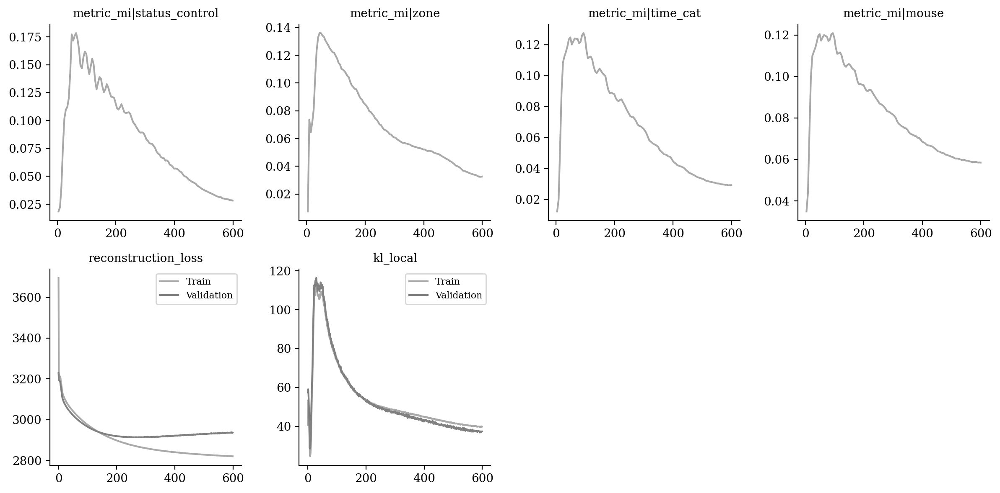

In [12]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [13]:
from tardis._disentanglementmanager import DisentanglementManager as DM

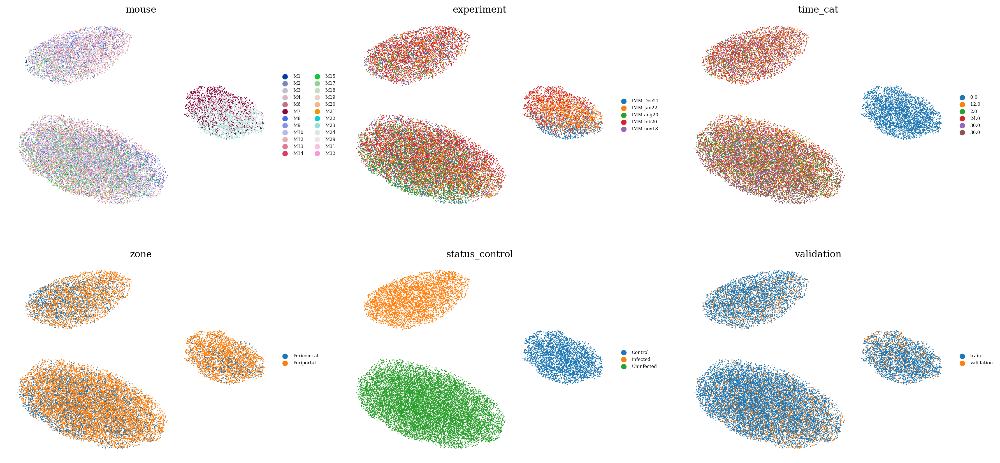

In [14]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

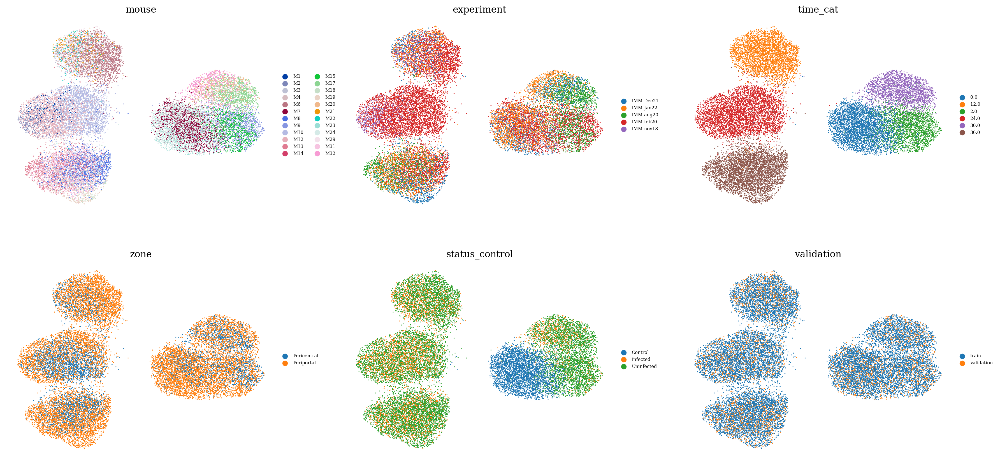

In [15]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

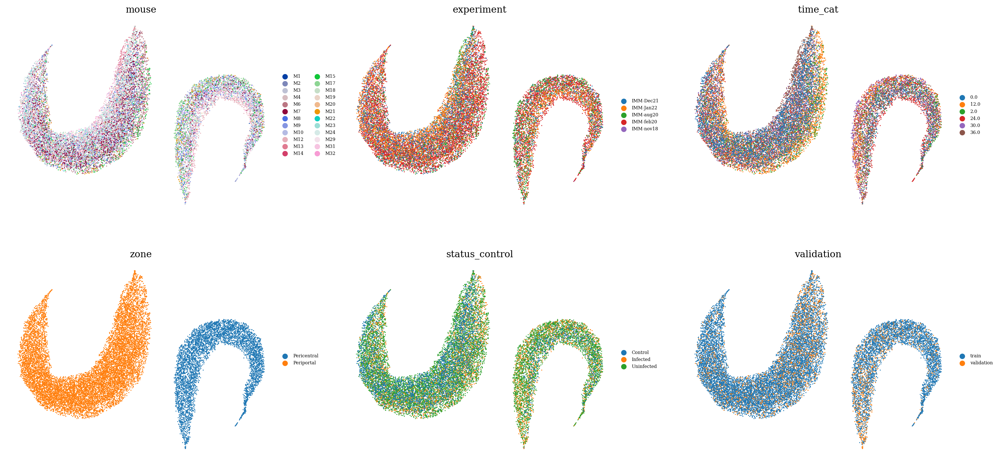

In [16]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

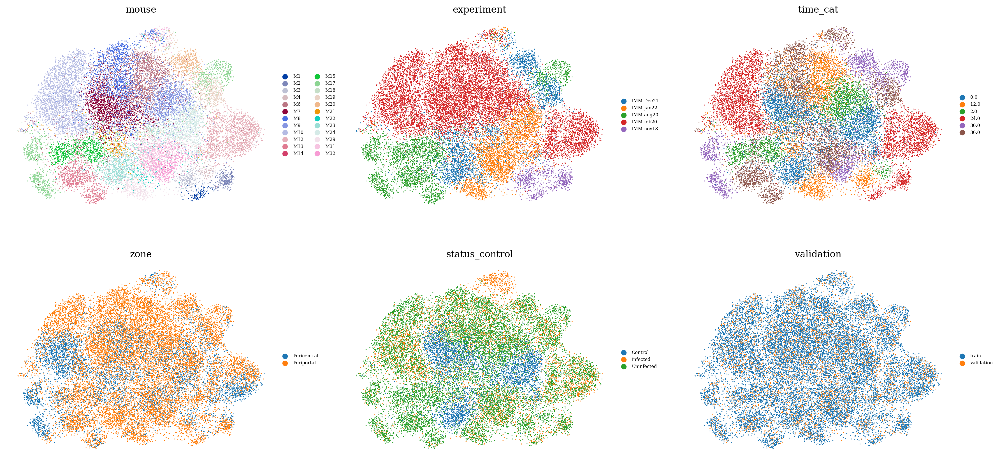

In [17]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

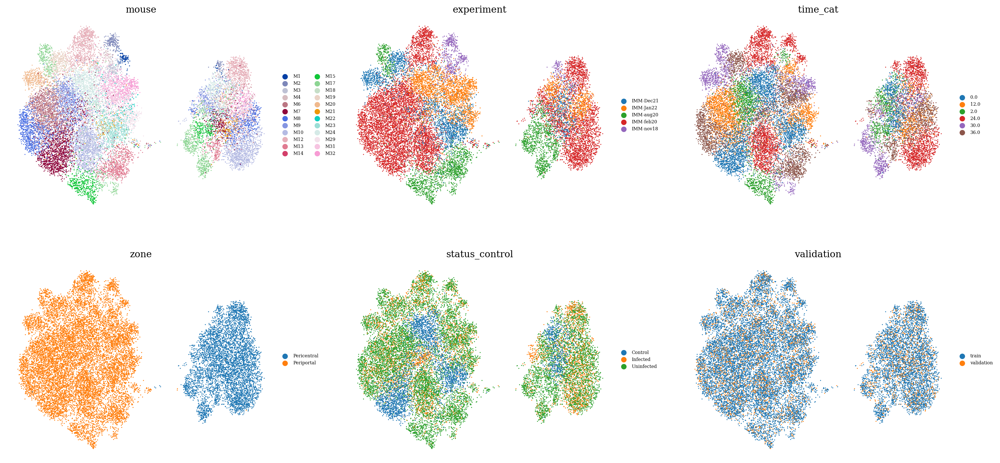

In [18]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [19]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())

In [20]:
latent = latent[latent.obs["time_cat"] == "12.0"]

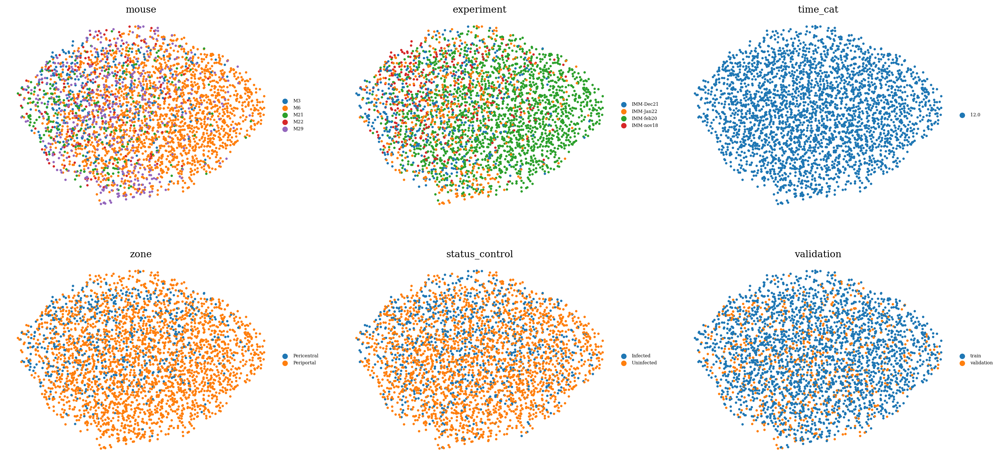

In [21]:
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )